In [2]:
import sys
# !{sys.executable} -m pip install matplotlib
# !{sys.executable} -m pip install mrcfile
# !{sys.executable} -m pip install numpy
# !{sys.executable} -m pip install pandas
# !{sys.executable} -m pip install Pillow
# !{sys.executable} -m pip install POT
# !{sys.executable} -m pip install scipy
# !{sys.executable} -m pip install seaborn
# !{sys.executable} -m pip install numba
# !{sys.executable} -m pip install Bio
# !{sys.executable} -m pip install tornado==4.5.3
!pip freeze

aiosignal==1.3.1
alabaster==0.7.13
anyio==3.6.2
argon2-cffi==21.3.0
argon2-cffi-bindings==21.2.0
arrow==1.2.3
# Editable install with no version control (aspire==0.12.0)
-e c:\users\artaj\dev\aspire-python-main
asttokens==2.2.1
attrs==22.2.0
Babel==2.13.0
backcall==0.2.0
beautifulsoup4==4.12.2
bio==1.5.9
biopython==1.81
biothings-client==0.3.0
black==23.9.1
bleach==6.0.0
blinker==1.8.2
build==1.0.3
bump2version==1.0.1
bumpversion==0.6.0
cachetools==5.3.1
certifi==2023.5.7
cffi==1.15.1
chardet==5.2.0
charset-normalizer==3.1.0
check-manifest==0.49
click==8.1.7
colorama==0.4.6
comm==0.1.3
ConfigArgParse==1.7
confuse==2.0.1
contourpy==1.0.7
coverage==7.3.2
cycler==0.11.0
dash==2.17.0
dash-core-components==2.0.0
dash-html-components==2.0.0
dash-table==5.0.0
debugpy==1.6.7
decorator==5.1.1
defusedxml==0.7.1
distlib==0.3.7
docutils==0.17.1
EMalign==1.0.5
exceptiongroup==1.1.3
execnet==2.0.2
executing==1.2.0
fastjsonschema==2.16.3
filelock==3.12.4
finufft==2.1.0
flake8==6.1.0
Flask==3.0.3
font

In [1]:
# %matplotlib notebook
import matplotlib.pyplot as plt
import math
import numpy as np
import ot
from matplotlib import collections  as mc
from mpl_toolkits.mplot3d import Axes3D
import random
import time
import seaborn as sns
import json

import mrcfile
import pandas as pd
import trn, coords
import importlib
importlib.reload(trn)

import torch
from unbalancedgw.vanilla_ugw_solver import exp_ugw_sinkhorn
from unbalancedgw.vanilla_ugw_solver import log_ugw_sinkhorn
from unbalancedgw._vanilla_utils import ugw_cost
from unbalancedgw.utils import generate_measure
from unbalancedgw._vanilla_utils import l2_distortion

from scipy.spatial.transform import Rotation

from Bio import PDB
from Bio.PDB.vectors import Vector, rotmat

plt.rcParams["figure.figsize"] = (10,10)

In [2]:
class Term:
    def __init__(self, coef=1, exps=[0,0,0,0]):
        self.coef = coef
        self.exps = exps
        while len(self.exps) < 8:
            self.exps.append(0)
    
    def derivative(self, index):
        new_exps = [0,0,0,0,0,0,0,0]
        for i in range(8):
            if i != index:
                new_exps[i] = self.exps[i]
            else:
                new_exps[i] = self.exps[i] - 1
        return Term(coef=self.coef*self.exps[index], exps=new_exps)
    
    def evaluate(self, vals):
        s = self.coef
        if s == 0:
            return 0
        for i in range(min(len(vals), len(self.exps))):
            if self.exps[i] == 0:
                continue
            elif self.exps[i] == 1:
                s *= vals[i]
            elif self.exps[i] == 2:
                s *= vals[i] * vals[i]
            elif self.exps[i] == 3:
                s *= vals[i] * vals[i] * vals[i]
            else:
                print(self.exps[i])
                s *= vals[i] ** self.exps[i]
        return s
    
    def bunch_evaluate(self, bunch_vals):
        s = self.coef
        for i in range(min(len(bunch_vals), len(self.exps))):
            for j in range(self.exps[i]):
                s = np.multiply(s, bunch_vals[i])
        return s
    
    def __mul__(self, other):
        coef = self.coef * other.coef
        exps = []
        for i in range(8):
            exps.append(self.exps[i] + other.exps[i])
        return Term(coef=coef, exps=exps)
    
    def __neg__(self):
        return Term(coef=-self.coef, exps=self.exps)
    
    def __str__(self):
        s = ""
        for i in range(8):
            if self.exps[i] != 0:
                s += "q" + str(i) + "^" + str(self.exps[i])
        return str(self.coef) + "*" + s
    
    def is_similar(self, other):
        for i in range(8):
            if self.exps[i] != other.exps[i]:
                return False
        return True
    
    def simplify(self, vals):
        new_exps = [0,0,0,0,0,0,0,0]
        coef = self.coef
        for i in range(8):
            if vals[i] != 'x':
                coef *= vals[i]**self.exps[i]
            else:
                new_exps[i] = self.exps[i]
        return Term(coef=self.coef*self.exps[index], exps=new_exps)
        
    
class Polynomial:
    def __init__(self, terms=None):
        if terms is None:
            terms = []
        self.terms = {}
        for term in terms:
            self.terms[tuple(term.exps)] = term
        
    def add_term(self, term):
        if term.coef == 0:
            return
        if tuple(term.exps) not in self.terms:
            self.terms[tuple(term.exps)] = term
        else:
            self.terms[tuple(term.exps)].coef += term.coef

    def get_terms(self):
        terms = []
        for exps in self.terms:
            terms.append(self.terms[exps])
        return terms
        
    def derivative(self, index):
        res = Polynomial()
        for term in self.get_terms():
            res.add_term(term.derivative(index))
        return res
    
    def simplify(self, vals):
        res = ()
        for term in self.get_terms():
            res.add_term(term.simplify(vals))
        return res
    
    def evaluate(self, vals):
        t = 0
        for term in self.get_terms():
            t += term.evaluate(vals)
        return t
    
    def bunch_evaluate(self, bunch_vals):
        t = 0
        for term in self.get_terms():
            t = np.add(t, term.bunch_evaluate(bunch_vals))
        return t
    
    def __add__(self, other):
        res = Polynomial()
        for term in self.get_terms():
            res.add_term(term)
        for term in other.get_terms():
            res.add_term(term)
        return res
    
    def __sub__(self, other):
        res = Polynomial()
        for term in self.get_terms():
            res.add_term(term)
        for term in other.get_terms():
            res.add_term(-term)
        return res
    
    def __neg__(self):
        res = Polynomial()
        for term in self.get_terms():
            res.add_term(-term)
        return res
    
    def __mul__(self, other):
        res = Polynomial()
        for term1 in self.get_terms():
            for term2 in other.get_terms():
                res.add_term(term1*term2)
        return res
    
    def __str__(self):
        s = ""
        terms = self.get_terms()
        for i in range(len(terms)):
            if i > 0:
                s += " + "
            s += str(terms[i])
        return s

class Quaternion:
    def __init__(self, real_pol, i_pol, j_pol, k_pol):
        self.real_pol = real_pol
        self.i_pol = i_pol
        self.j_pol = j_pol
        self.k_pol = k_pol
        
    def conjugate(self):
        return Quaternion(self.real_pol, -self.i_pol, -self.j_pol, -self.k_pol)
    
    def __mul__(self, other):
        return Quaternion(self.real_pol*other.real_pol - self.i_pol*other.i_pol - self.j_pol*other.j_pol - self.k_pol*other.k_pol,
                          self.real_pol*other.i_pol + self.i_pol*other.real_pol + self.j_pol*other.k_pol - self.k_pol*other.j_pol,
                          self.real_pol*other.j_pol + self.j_pol*other.real_pol + self.k_pol*other.i_pol - self.i_pol*other.k_pol,
                          self.real_pol*other.k_pol + self.k_pol*other.real_pol + self.i_pol*other.j_pol - self.j_pol*other.i_pol)
    
    def __str__(self):
        return str(self.real_pol) + " + (" + str(self.i_pol) + ")i + (" + str(self.j_pol) + ")j + (" + str(self.k_pol) + ")k"
    

In [3]:
q = Quaternion(Polynomial([Term(coef=1, exps=[1,0,0,0])]), Polynomial([Term(coef=1, exps=[0,1,0,0])]), 
               Polynomial([Term(coef=1, exps=[0,0,1,0])]), Polynomial([Term(coef=1, exps=[0,0,0,1])]))
qs = q.conjugate()
print('The conjugate of %s is %s.'%(str(q), str(qs)))
print('The multiplication of %s and %s is equal to %s.'%(str(q), str(qs), str(q*qs)))

The conjugate of 1*q0^1 + (1*q1^1)i + (1*q2^1)j + (1*q3^1)k is 1*q0^1 + (-1*q1^1)i + (-1*q2^1)j + (-1*q3^1)k.
The multiplication of 1*q0^1 + (1*q1^1)i + (1*q2^1)j + (1*q3^1)k and 1*q0^1 + (-1*q1^1)i + (-1*q2^1)j + (-1*q3^1)k is equal to 1*q0^2 + 1*q1^2 + 1*q2^2 + 1*q3^2 + (0*q2^1q3^1)i + (0*q1^1q3^1)j + (0*q1^1q2^1)k.


In [4]:
def get_quaternion_vals(theta, ax, ay, az):
    """
    Compute the quaternion representation for a given rotation in angle-axis representation
    params:
        theta: the angle of the rotation in radians
        ax, ay, az: three floats in a way that *ax, ay, az) shows the 3d axis of the rotation

    retrun:
        q: is a list of length 4 that has values of the corresponding quaternion
    """
    
    n = math.sqrt(ax**2 + ay**2 + az**2)
    return [math.cos(theta/2), math.sin(theta/2)*ax/n, math.sin(theta/2)*ay/n, math.sin(theta/2)*az/n]

def convert_to_poly(vals):
    return Quaternion(Polynomial([Term(coef=vals[0], exps=[0,0,0,0])]), Polynomial([Term(coef=vals[1], exps=[0,0,0,0])]), 
                      Polynomial([Term(coef=vals[2], exps=[0,0,0,0])]), Polynomial([Term(coef=vals[3], exps=[0,0,0,0])]))
    

def perform(x, y, z, vals):
    """
    Apply a given rotation on a given point cloud and generate a new point cloud
    params:
        x, y, z: three lists with len(x)=len(y)=len(z) in a way that (x[i], y[i], z[i]) is the 3d coordinates of the i-th point
        vals: a list of length 4 that contains the values of the quaternion correponding the the ritation

    return:
        xr, yr, zr: three lists with len(xr)=len(yr)=len(zr) in a way that (xr[i], yr[i], zr[i]) is the 3d coordinates of the i-th point after the rotation
    """
    
    xr = []
    yr = []
    zr = []
    q = convert_to_poly(vals)
    qs = q.conjugate()
    p = Quaternion(Polynomial([Term(coef=1, exps=[1,0,0,0])]), Polynomial([Term(coef=1, exps=[0,1,0,0])]), 
                   Polynomial([Term(coef=1, exps=[0,0,1,0])]), Polynomial([Term(coef=1, exps=[0,0,0,1])]))
    t = time.time()
    b = q*p*qs
    t = time.time()
    
    bunch_vals = [np.zeros(len(x)), np.array(x), np.array(y), np.array(z)]
    xr = list(b.i_pol.bunch_evaluate(bunch_vals))
    yr = list(b.j_pol.bunch_evaluate(bunch_vals))
    zr = list(b.k_pol.bunch_evaluate(bunch_vals))
    
    return xr, yr, zr


In [5]:
def my_sinkhorn(a, b, M, reg, numItermax=5000, stopThr=1e-3, prev=None):

    a = np.asarray(a, dtype=np.float64)
    b = np.asarray(b, dtype=np.float64)
    M = np.asarray(M, dtype=np.float64)

    # init data
    dim_a = len(a)
    dim_b = len(b)
    
    if prev is None:
        u = np.ones(dim_a) / dim_a
        v = np.ones(dim_b) / dim_b
    else:
        u = prev[0]
        v = prev[1]
    
    # Next 3 lines equivalent to K= np.exp(-M/reg), but faster to compute
    K = np.empty(M.shape, dtype=M.dtype)
    np.divide(M, -reg, out=K)
    np.exp(K, out=K)

    tmp2 = np.empty(b.shape, dtype=M.dtype)

    Kp = (1 / a).reshape(-1, 1) * K
    cpt = 0
    err = 1
    while (err > stopThr and cpt < numItermax):
        uprev = u
        vprev = v

        KtransposeU = np.dot(K.T, u)
        v = np.divide(b, KtransposeU)
        u = 1. / np.dot(Kp, v)

        if (np.any(KtransposeU == 0)
                or np.any(np.isnan(u)) or np.any(np.isnan(v))
                or np.any(np.isinf(u)) or np.any(np.isinf(v))):
            # we have reached the machine precision
            # come back to previous solution and quit loop
            print('Warning: numerical errors at iteration', cpt)
            raise Exception('hi')
            u = uprev
            v = vprev
            reg *= 2
            K = np.empty(M.shape, dtype=M.dtype)
            np.divide(M, -reg, out=K)
            np.exp(K, out=K)
        if cpt % 10 == 0:
            # we can speed up the process by checking for the error only all
            # the 10th iterations
            # compute right marginal tmp2= (diag(u)Kdiag(v))^T1
            np.einsum('i,ij,j->j', u, K, v, out=tmp2)
            err = np.linalg.norm(tmp2 - b)  # violation of marginal
        cpt = cpt + 1
        
    return u.reshape((-1, 1)) * K * v.reshape((1, -1)), u, v

def compute_diff_mat(a,b):
    
    a = np.asarray(a, dtype=np.float64)
    b = np.asarray(b, dtype=np.float64)
    c = a.reshape((1,-1))
    d = b.reshape((1,-1))
    cd = c*d.T
    c2 = np.repeat(c*c,len(a), axis=0)
    d2 = np.repeat(d*d,len(b), axis=0)
    return c2 + d2.T - 2 * cd


def compute_cost_mat(x,y,z,xr,yr,zr):
    return compute_diff_mat(x,xr) + compute_diff_mat(y,yr) + compute_diff_mat(z,zr)

def OT(x,y,z,xr,yr,zr, prev=None, reg=0.1, method='my_sinkh'):
    a = []
    b = []
    for i in range(len(x)):
        a.append(1/len(x))
        b.append(1/len(x))
    
    M = compute_cost_mat(x,y,z,xr,yr,zr)
            
    t = time.time()
          
    if method == 'emd':
        T = ot.emd(a, b, M)
    if method == 'my_sinkh':
        while True:
            try:
                T, u, v = my_sinkhorn(a, b, M, reg, prev=prev)
            except Exception as e:
                reg = reg + 0.1
                print('Reg is now ' + str(reg))
                print(str(e))
                continue
            break
    
    cost = np.sum(np.multiply(M, T))
    
    if method == 'emd':
        return T,cost
    if method == 'my_sinkh':
        return T,cost, u, v

In [6]:
def sample(fname, thresh, M, invalid=False, random_seed=None, verbose=False):
    """
    Sample a given file using a topology representing network and return sampled points
    params:
        fname: the name and address of the mrc file for the input map
        thresh: the thresholding parameter, to be more robust to noise the values in the map with intensity < thresh
                    will be changed to 0
        M: number of point you want to sample

    return:
        x, y, z: the coordinated of the sampled points
        x, y, z are lists so we have len(x)=len(y)=len(z)=M and
        (x[i], y[i], z[i]) shows the 3d coordinates of the i-th point
    """
    
    if invalid:
        with mrcfile.open(fname, mode='r+', permissive=True) as mrc:     
            mrc.header.map = mrcfile.constants.MAP_ID
            mrc.update_header_from_data()
    map_mrc = mrcfile.open(fname)
    map_original = map_mrc.data
    N = map_original.shape[0]
    psize_original = map_mrc.voxel_size.item(0)[0]
    psize = psize_original

    map_th = map_original.copy()
    if verbose:
        print(np.where(np.isnan(map_th)==True))
        print(map_th.sum())
    map_th[map_th < thresh] = 0

    rm0,arr_flat,arr_idx,xyz,coords_1d = trn.trn_rm0(map_th,M,random_seed=random_seed)

    l0 = 0.005*M # larger tightens things up (far apart areas too much to much, pulls together). smaller spreads things out
    lf = 0.5
    tf = M*8
    e0 = 0.3
    ef = 0.05

    rms,rs,ts_save = trn.trn_iterate(rm0,arr_flat,arr_idx,xyz,n_save=10,e0=e0,ef=ef,l0=l0,lf=lf,tf=tf,do_log=True,log_n=10)

    
    N_cube = max(map_mrc.header.tolist()[0],map_mrc.header.tolist()[1],map_mrc.header.tolist()[2])
    N_cube += N_cube%2
    
    x_res = []
    y_res = []
    z_res = []
    for p in rms[10]:
#         x_res.append(p[0])
#         y_res.append(p[1])
#         z_res.append(p[2])
        
        z_res.append(map_mrc.header.tolist()[24][2] + map_mrc.header.tolist()[10][2] * ((p[0] + N_cube//2)) / map_mrc.header.tolist()[2])
        y_res.append(map_mrc.header.tolist()[24][1] + map_mrc.header.tolist()[10][1] * ((p[1] + N_cube//2)) / map_mrc.header.tolist()[1])
        x_res.append(map_mrc.header.tolist()[24][0] + map_mrc.header.tolist()[10][0] * ((p[2] + N_cube//2)) / map_mrc.header.tolist()[0])

    return x_res,y_res,z_res


In [57]:
def ugw(x, y, z, x1, y1, z1, init=None, eps=40000,
                             rho=1000000, rho2=1000000,
                             nits_plan=100, tol_plan=1e-10,
                             nits_sinkhorn=100, tol_sinkhorn=1e-10):
    a = [1/len(x)] * len(x)
    b = [1/len(x1)] * len(x1)
    n = len(x)
    dx = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            dx[i][j] = (x[i] - x[j])**2 + (y[i] - y[j])**2 + (z[i] - z[j])**2

    n = len(x1)
    dy = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            dy[i][j] = (x1[i] - x1[j])**2 + (y1[i] - y1[j])**2 + (z1[i] - z1[j])**2

    a = torch.from_numpy(np.array(a))
    b = torch.from_numpy(np.array(b))
    dx = torch.from_numpy(np.array(dx))
    dy = torch.from_numpy(np.array(dy))
    print(a.shape)
    print(b.shape)
    print(dx.shape)
    print(dy.shape)

    pi, gamma = log_ugw_sinkhorn(a, dx, b, dy, init=init, eps=eps,
                                 rho=rho, rho2=rho2,
                                 nits_plan=nits_plan, tol_plan=tol_plan,
                                 nits_sinkhorn=nits_sinkhorn, tol_sinkhorn=tol_sinkhorn,
                                 two_outputs=True)

    return pi, gamma, float(l2_distortion(pi, gamma, dx, dy))

def build_coup(x, y, z, x1, y1, z1, pi, verbose=False):
    res = np.array(pi)
    all_coup = []
    for i in range(len(x1)):
        maxi = None
        maxx = 0
        s = 0
        for j in range(len(x)):
            s += res[j,i]
            if res[j,i] > maxx:
    #             print(maxx, res[i,j])
    #             print(i,j)
                maxx = res[j,i]
                maxi = j
    #     print('!')
        if verbose:
            print(i,maxi, maxx, s)
    #     if maxi/maxx >0.8:
        if maxi is not None:
    #     if i == 0 and maxi >1e-4:
            all_coup.append((i, maxi))
    return all_coup

def find_optimal_alignment(x, y, z, x1, y1, z1, all_coup, verbose=False):
    A = []
    B = []
    for i in range(len(all_coup)):
        X = [x[all_coup[i][1]], y[all_coup[i][1]], z[all_coup[i][1]]]
        X = np.array(X)
        A.append(X)
    #     print(all_coup[i][1])
        X = [x1[all_coup[i][0]], y1[all_coup[i][0]], z1[all_coup[i][0]]]
        X = np.array(X)
        B.append(X)
    Abar = np.array([0., 0., 0.])
    Bbar = np.array([0., 0., 0.])
    for i in range(len(all_coup)):
        Abar += 1/len(all_coup) * A[i]
        Bbar += 1/len(all_coup) * B[i]
    if verbose:
        print(Abar)
        print(Bbar)
    H = np.zeros((3,3))
    for i in range(len(all_coup)):
        H += np.outer(A[i] - Abar, (B[i] - Bbar))
    # print(H)
    U, S, V = np.linalg.svd(H)
    # print(U,S,V)
    # R = np.matmul(np.transpose(V), np.transpose(U))
    R = np.matmul(U,V)
    d = np.linalg.det(R)
    R = np.matmul(np.matmul(U,np.diag([1,1,d])),V)
    if verbose:
        print(H)
        print(np.diag(S))
        print(np.matmul(np.matmul(U,np.diag(S)),V))
        print(V)
        print(R)
        print(np.linalg.det(R))
    r = Rotation.from_matrix(R)
    return Abar, Bbar, r

def change_quat_format(vals):
    return [vals[3], vals[0], vals[1], vals[2]]

def plot_alignment(x, y, z, x1, y1, z1, Abar, Bbar, r, all_coup):
    x2 = []
    y2 = []
    z2 = []
    x3 = []
    y3 = []
    z3 = []
    for i in range(len(x)):
        x2.append(x[i] - Abar[0])
        y2.append(y[i] - Abar[1])
        z2.append(z[i] - Abar[2])
        
    for i in range(len(x1)):
        x3.append(x1[i] - Bbar[0])
        y3.append(y1[i] - Bbar[1])
        z3.append(z1[i] - Bbar[2])
        
    x3, y3, z3 = perform(x3, y3, z3, change_quat_format(r.as_quat()))
    
    plt.rcParams["figure.figsize"] = (20,20)
    fig = plt.figure()
    # ax = fig.gca(projection='3d', adjustable='box')
    ax = fig.add_subplot(projection='3d')
    ax.scatter(x3, y3, z3,  marker='o')
    ax.scatter(x2, y2, z2,  marker='o')
    for i in range(len(all_coup)):
        ax.plot([x2[all_coup[i][1]], x3[all_coup[i][0]]], [y2[all_coup[i][1]], y3[all_coup[i][0]]], zs=[z2[all_coup[i][1]], z3[all_coup[i][0]]], c='k', alpha=0.05)
    ax.set_xlim(-60,60)
    ax.set_ylim(-60,60)
    ax.set_zlim(-60,60)
    plt.show()

In [52]:
def align_pointcloud(x, y, z, x1, y1, z1, num=1, verbose=True):
    alignments = []
    for i in range(num):
        if verbose:
            print(i)
            
        t_perm  = None
#         if num > 1:
#             perm = np.random.permutation(len(x))
#             t_perm = np.zeros((len(x), len(x)))
#             for i in range(len(x)):
#                 t_perm[i, perm[i]] = 1/len(x)
#             t_perm = torch.from_numpy(t_perm)
        
        pi, gamma, dist = ugw(x, y, z, x1, y1, z1, init=t_perm)
        
        all_coup = build_coup(x, y, z, x1, y1, z1, pi)
        
        Abar, Bbar, r = find_optimal_alignment(x, y, z, x1, y1, z1, all_coup)
        
        if verbose:
            plot_alignment(x, y, z, x1, y1, z1, Abar, Bbar, r, all_coup)
        
        covering = [0] * len(x)
        for i in range(len(all_coup)):
            covering[all_coup[i][1]] += 1
        
        alignments.append({'Abar':Abar, 'Bbar':Bbar, 'r':r, 'score':dist, 'covering':covering})
    return alignments

In [61]:
def align_substruct(x, y, z, structs, num=1, num_points=500):
    # structs is the list of possible structures came from prediction of alphafold for a chain
    # the format is struct = [('mrc address', threshold value, 'pdb address'), ...]
    alignments = []
    for struct in structs:
#         x1, y1, z1 = sample(struct[0], struct[1], num_points)
        x1 = []
        y1 = []
        z1 = []
        for i in range(struct[0].shape[0]):
            x1.append(struct[0][i, 0])
            y1.append(struct[0][i, 1])
            z1.append(struct[0][i, 2])
        struct_alignments = align_pointcloud(x, y, z, x1, y1, z1, num=num)
        for struct_alignment in struct_alignments:
            struct_alignment['struct'] = struct
        alignments += struct_alignments
    return alignments

In [10]:
def choose_alignments(x, y, z, possible_alignments, verbose=False):
    num_structs = len(possible_alignments)
    num_comb = 1
    for i in range(num_structs):
        num_comb *= len(possible_alignments[i])
    best_overlaps = float('inf')
    best_score = float('inf')
    best_alignments = None
    for i in range(num_comb):
        alignments = []
        comb_number = i
        if verbose:
            print('!')
        for j in range(num_structs):
            if verbose:
                print(comb_number%len(possible_alignments[j]))
            alignments.append(possible_alignments[j][comb_number%len(possible_alignments[j])])
            comb_number = comb_number//len(possible_alignments[j])
        if verbose:
            print('!')
        overlaps = 0
        score = 0
        covering = [0] * len(alignments[0]['covering'])
        x_ov = []
        y_ov = []
        z_ov = []
        for alignment in alignments:
            score += alignment['score']
            for j in range(len(alignment['covering'])):
                if covering[j] > 0  and alignment['covering'][j] > 0:
                    overlaps += 1
                    x_ov.append(x[j])
                    y_ov.append(y[j])
                    z_ov.append(z[j])
                covering[j] += alignment['covering'][j]
        if verbose:
            print('###')
            print(overlaps)
            print(score)
            print(best_overlaps)
            print(best_score)
        if verbose:
            fig = plt.figure()
            # ax = fig.gca(projection='3d', adjustable='box')
            ax = fig.add_subplot(projection='3d')
            ax.scatter(x_ov, y_ov, z_ov,  marker='o')
            ax.scatter(x, y, z,  marker='o', alpha=0.5)
            plt.show()
        if (overlaps < best_overlaps) or ((overlaps == best_overlaps) and (score <= best_score)):
            best_alignments = alignments
            best_overlaps = overlaps
            best_score = score
            if verbose:
                print('BEST!!!!!!!!!!!!!!!!!!')
    return best_alignments

In [11]:
def generate_pdb(mrcname_in, mrcname_out, pdbname_in, pdbname_out, alignment):
    Abar = alignment['Abar']
    Bbar = alignment['Bbar']
    r = alignment['r']
    
    map_mrc_in = mrcfile.open(mrcname_in)
    N_cube_in = max(map_mrc_in.header.tolist()[0],map_mrc_in.header.tolist()[1],map_mrc_in.header.tolist()[2])
    N_cube_in += N_cube_in%2
    
    map_mrc_out = mrcfile.open(mrcname_out)
    N_cube_out = max(map_mrc_out.header.tolist()[0],map_mrc_out.header.tolist()[1],map_mrc_out.header.tolist()[2])
    N_cube_out += N_cube_out%2
    
    parser = PDB.PDBParser()
    io = PDB.PDBIO()
    print(pdbname_in)
    struct = parser.get_structure('6n52', pdbname_in)

    x_ins = []
    y_ins = []
    z_ins = []

    x_outs = []
    y_outs = []
    z_outs = []

    for model in struct:
        for chain in model:
            for residue in chain:
                for atom in residue:
                    coord = atom.get_coord()

#                     x_in = (coord[2] - map_mrc_in.header.tolist()[24][2]) * map_mrc_in.header.tolist()[2] / map_mrc_in.header.tolist()[10][2] - N_cube_in//2
#                     y_in = (coord[1] - map_mrc_in.header.tolist()[24][1]) * map_mrc_in.header.tolist()[1] / map_mrc_in.header.tolist()[10][1] - N_cube_in//2
#                     z_in = (coord[0] - map_mrc_in.header.tolist()[24][0]) * map_mrc_in.header.tolist()[0] / map_mrc_in.header.tolist()[10][0] - N_cube_in//2
                    
                    x_in = coord[0]
                    y_in = coord[1]
                    z_in = coord[2]
                
                    x_ins.append(x_in)
                    y_ins.append(y_in)
                    z_ins.append(z_in)

                    x_in -= Bbar[0]
                    y_in -= Bbar[1]
                    z_in -= Bbar[2]


                    x_temp, y_temp, z_temp = perform([x_in], [y_in], [z_in], change_quat_format(r.as_quat()))

                    x_out = x_temp[0] + Abar[0]
                    y_out = y_temp[0] + Abar[1]
                    z_out = z_temp[0] + Abar[2]

                    x_outs.append(x_out)
                    y_outs.append(y_out)
                    z_outs.append(z_out)

#                     z_temp = map_mrc_out.header.tolist()[24][2] + map_mrc_out.header.tolist()[10][2] * ((x_out + N_cube_out//2)) / map_mrc_out.header.tolist()[2]
#                     y_temp = map_mrc_out.header.tolist()[24][1] + map_mrc_out.header.tolist()[10][1] * ((y_out + N_cube_out//2)) / map_mrc_out.header.tolist()[1]
#                     x_temp = map_mrc_out.header.tolist()[24][0] + map_mrc_out.header.tolist()[10][0] * ((z_out + N_cube_out//2)) / map_mrc_out.header.tolist()[0]

                    x_temp = x_out
                    y_temp = y_out
                    z_temp = z_out
                    
                    atom.set_coord([x_temp, y_temp, z_temp])


    #                 print(coord)
    #                 break

    io.set_structure(struct)
    io.save(pdbname_out)

In [12]:
def generate_pdbs(mrcname, alignments, outputname):
    i = 0
    for alignment in alignments:
        generate_pdb(alignment['struct'][0], mrcname, alignment['struct'][2], outputname + str(i) + '.pdb', alignment)
        i += 1

In [13]:
def sample_pdb(filename, k):
#     parser = PDB.MMCIFParser()
    parser = PDB.PDBParser()
    print(filename)
    struct = parser.get_structure('6n52', filename)
    points = []
    t = 0
    for model in struct:
        for chain in model:
            for residue in chain:
                for atom in residue:
                    coord = atom.get_coord()
                    
                    t += 1
                    if t == k:
                        t = 0
                        points.append([coord[0], coord[1], coord[2]])
    points = np.array(points)
    return points

In [78]:
def generate_pdb_no_mrc(pdbname_in, pdbname_out, alignment):
    Abar = alignment['Abar']
    Bbar = alignment['Bbar']
    r = alignment['r']
    
    parser = PDB.PDBParser()
    io = PDB.PDBIO()
    print(pdbname_in)
    struct = parser.get_structure('6n52', pdbname_in)

    x_ins = []
    y_ins = []
    z_ins = []

    x_outs = []
    y_outs = []
    z_outs = []

    for model in struct:
        for chain in model:
            for residue in chain:
                for atom in residue:
                    coord = atom.get_coord()

#                     x_in = (coord[2] - map_mrc_in.header.tolist()[24][2]) * map_mrc_in.header.tolist()[2] / map_mrc_in.header.tolist()[10][2] - N_cube_in//2
#                     y_in = (coord[1] - map_mrc_in.header.tolist()[24][1]) * map_mrc_in.header.tolist()[1] / map_mrc_in.header.tolist()[10][1] - N_cube_in//2
#                     z_in = (coord[0] - map_mrc_in.header.tolist()[24][0]) * map_mrc_in.header.tolist()[0] / map_mrc_in.header.tolist()[10][0] - N_cube_in//2
                    
                    x_in = coord[0]
                    y_in = coord[1]
                    z_in = coord[2]
                
                    x_ins.append(x_in)
                    y_ins.append(y_in)
                    z_ins.append(z_in)

                    x_in -= Bbar[0]
                    y_in -= Bbar[1]
                    z_in -= Bbar[2]


                    x_temp, y_temp, z_temp = perform([x_in], [y_in], [z_in], change_quat_format(r.as_quat()))

                    x_out = x_temp[0] + Abar[0]
                    y_out = y_temp[0] + Abar[1]
                    z_out = z_temp[0] + Abar[2]

                    x_outs.append(x_out)
                    y_outs.append(y_out)
                    z_outs.append(z_out)

#                     z_temp = map_mrc_out.header.tolist()[24][2] + map_mrc_out.header.tolist()[10][2] * ((x_out + N_cube_out//2)) / map_mrc_out.header.tolist()[2]
#                     y_temp = map_mrc_out.header.tolist()[24][1] + map_mrc_out.header.tolist()[10][1] * ((y_out + N_cube_out//2)) / map_mrc_out.header.tolist()[1]
#                     x_temp = map_mrc_out.header.tolist()[24][0] + map_mrc_out.header.tolist()[10][0] * ((z_out + N_cube_out//2)) / map_mrc_out.header.tolist()[0]

                    x_temp = x_out
                    y_temp = y_out
                    z_temp = z_out
                    
                    atom.set_coord([x_temp, y_temp, z_temp])


    #                 print(coord)
    #                 break

    io.set_structure(struct)
    io.save(pdbname_out)

In [14]:
import numpy as np
import matplotlib.pyplot as plt
# import alphashape
from matplotlib.path import Path
from scipy.spatial import ConvexHull
import ot

In [15]:
def generate_mu(clusters):
    s = 0
    for cluster in clusters:
        s += cluster.shape[0]
    return [1/s]*s

def dist(point1, point2):
    if point1.shape[0] == 2:
        return (point1[0] - point2[0])**2 + (point1[1] - point2[1])**2
    if point1.shape[0] == 3:
        return (point1[0] - point2[0])**2 + (point1[1] - point2[1])**2 + (point1[2] - point2[2])**2
    
def generate_d_graph_1(points, adj):
    n = points.shape[0]
    max_dist = 10.0
    d = np.zeros((n, n)) + max_dist
    for src in range(n):
        not_visited = np.array([True] * n)
        shortest_path = np.array([max_dist] * n)
        shortest_path[src] = 0
        while not_visited.sum() > 0:
#             print(shortest_path)
#             print(not_visited)
            current_min = np.argmin((shortest_path - max_dist)*(not_visited))
            if shortest_path[current_min] >= max_dist:
                break
            if not_visited[current_min] == False:
                break
            for neigh in adj[current_min]:
                dis = math.sqrt(dist(points[current_min], points[neigh]))
#                 print(current_min, neigh, dis)
                if shortest_path[current_min] + dis < shortest_path[neigh]:
                    shortest_path[neigh] = shortest_path[current_min] + dis
            not_visited[current_min] = False
        for i in range(n):
            d[src, i] = shortest_path[i]
    return d

def generate_d_graph(clusters, adjs):
    s = 0
    for cluster in clusters:
        s += cluster.shape[0]
    n = s
    ix = np.zeros((n,n))
    d = np.zeros((n,n))
        
    s = 0
    for k in range(len(clusters)):
        dc = generate_d_graph_1(clusters[k], adjs[k])
        for i in range(clusters[k].shape[0]):
            for j in range(clusters[k].shape[0]):
                ix[i+s, j+s] = 1
                d[i+s, j+s] = dc[i, j]**2
        s += clusters[k].shape[0]
    return d, ix
            
                
    

def generate_d(clusters):
    s = 0
    for cluster in clusters:
        s += cluster.shape[0]
    n = s
    ix = np.zeros((n,n))
    d = np.zeros((n,n))
        
    s = 0
    for cluster in clusters:
        for i in range(cluster.shape[0]):
            for j in range(cluster.shape[0]):
                ix[i+s, j+s] = 1
                d[i+s, j+s] = dist(cluster[i], cluster[j])
        s += cluster.shape[0]
    return d, ix

In [87]:
def gamma(mu, d_x, i_x, d_y):
#     print(mu.shape)
#     print(d_x.shape)
#     print(i_x.shape)
#     print(d_y.shape)
    return np.matmul(np.matmul(i_x, mu), d_y*d_y) - 2*np.matmul(np.matmul(d_x, mu), d_y)

In [88]:
def cost(gamma, mu):
    if mu.shape[0] != gamma.shape[0]:
        print(mu.shape)
        print(gamme.shape)
    s = 0
    for i in range(mu.shape[0]):
        for j in range(mu.shape[1]):
            s += mu[i,j] * gamma[i,j]
    return s

In [89]:
# file_path_extensions = ['A', 'B', 'C', 'E', 'F', 'H', 'I', 'J', 'K', 'L']
# file_path_origin = 'Data/jgw/bio/1i3q/1i3q_%s.pdb'
# volumes = np.array([1349, 788, 557, 309, 273, 309, 273, 456])
# n_points = 5000
# num_skip = 10

file_path_extensions = ['A', 'B', 'CHJKL']
file_path_origin = 'Data/jgw/bio/1i3q/1i3q_%s.pdb'
volumes = np.array([1349, 788, 557, 309, 273, 309, 273, 456])
n_points = 5000
num_skip = 10

In [90]:
sum(volumes)

4314

Data/jgw/bio/1i3q/1i3q_A.pdb
(1111, 3)


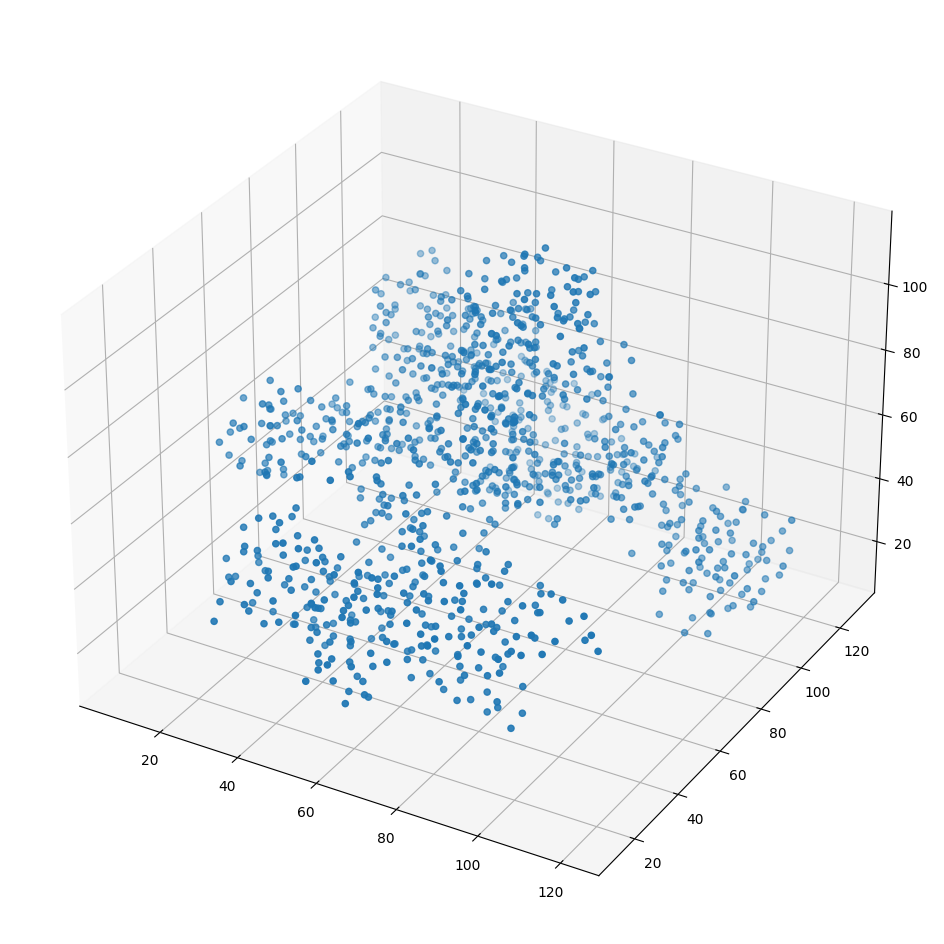

Data/jgw/bio/1i3q/1i3q_B.pdb
(862, 3)


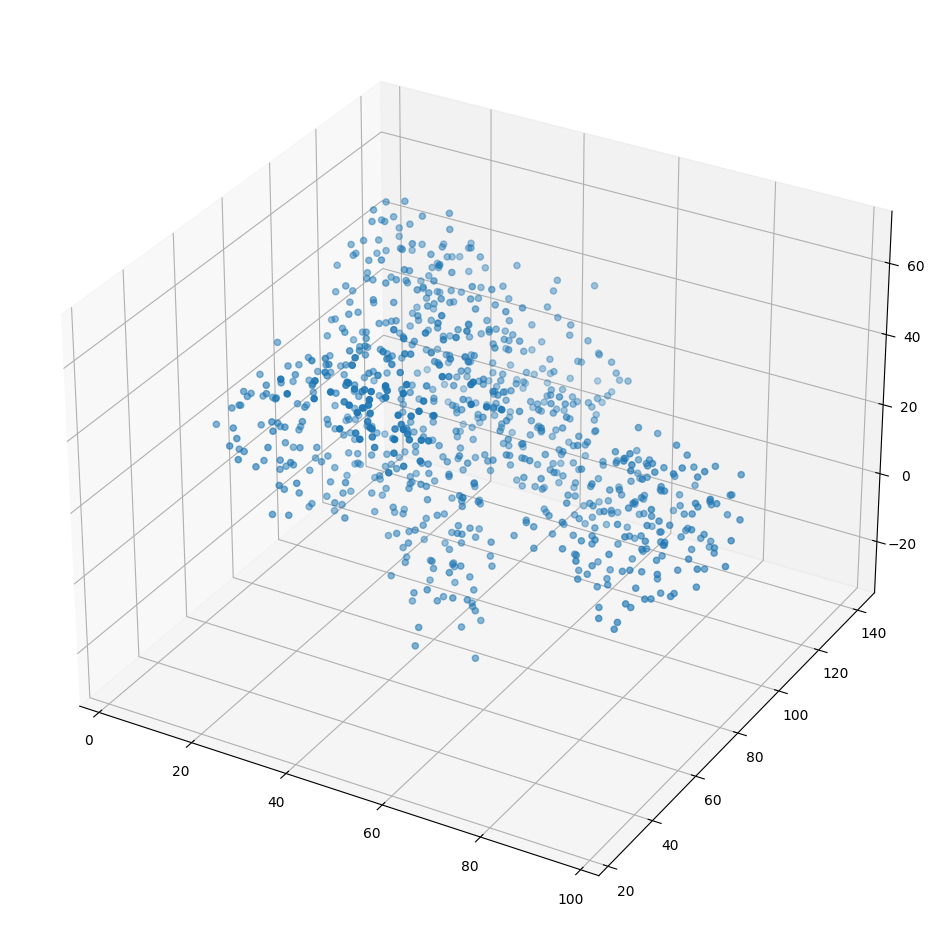

Data/jgw/bio/1i3q/1i3q_CHJKL.pdb


C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6409.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 6412.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 6413.
  warnings.warn(


(498, 3)


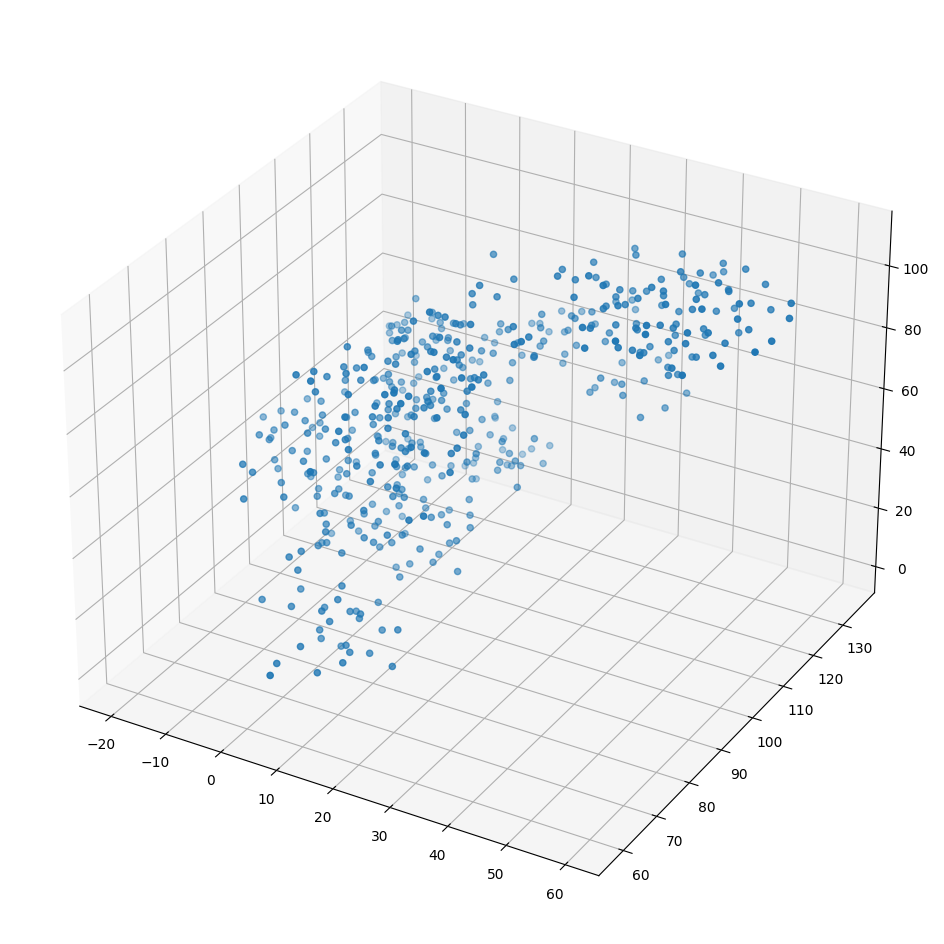

In [91]:
points_x = []
index = []
for i in range(len(file_path_extensions)):
    file_path = file_path_origin%(file_path_extensions[i],)
#     num = int(n_points / volumes.sum() * volumes[i])
#     x, y, z = sample(file_path, 0.1, n_points, random_seed=1)
#     print(file_path, num)
#     points_x.append([])
#     for j in range(num):
#         index.append(i)
#         points_x[-1].append([x[j],y[j],z[j]])
#     points_x[-1] = np.array(points_x[-1])
    points_x.append(sample_pdb(file_path, num_skip))
    print(points_x[-1].shape)
    for j in range(points_x[-1].shape[0]):
        index.append(i)
    
    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(points_x[-1][:,2], points_x[-1][:,0], points_x[-1][:,1])
    plt.show()

(2471, 3)


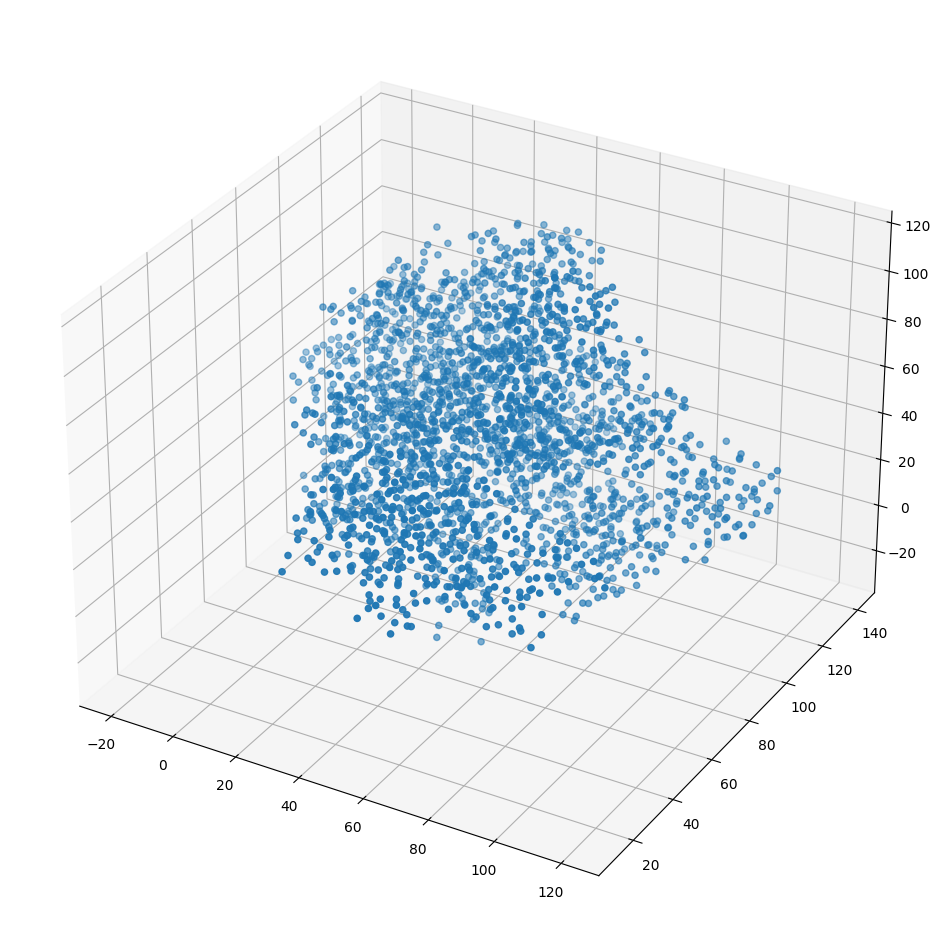

In [92]:
# x, y, z = sample('Data/jgw/bio/rib/8Y0W.mrc', 0.1, n_points, random_seed=1)
# points_y = []
# for i in range(n_points):
#     points_y.append([x[i],y[i],z[i]])
# points_y = np.array(points_y)


# points_y = sample_pdb('Data/jgw/bio/rib/8Y0W.cif', num_skip)


points_y = []
for i in range(len(points_x)):
    for j in range(points_x[i].shape[0]):
        points_y.append([points_x[i][j][0], points_x[i][j][1], points_x[i][j][2]])
points_y = np.array(points_y)

print(points_y.shape)

fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(projection='3d')
ax.scatter(points_y[:,2], points_y[:,0], points_y[:,1])
plt.show()

In [93]:
d_y, i_y = generate_d([points_y])
mu_y = [1/d_y.shape[0]] * d_y.shape[0]
mu_y = np.array(mu_y)

In [94]:
d_x, i_x = generate_d(points_x)
mu_x = [1/d_x.shape[0]] * d_x.shape[0]
mu_x = np.array(mu_x)

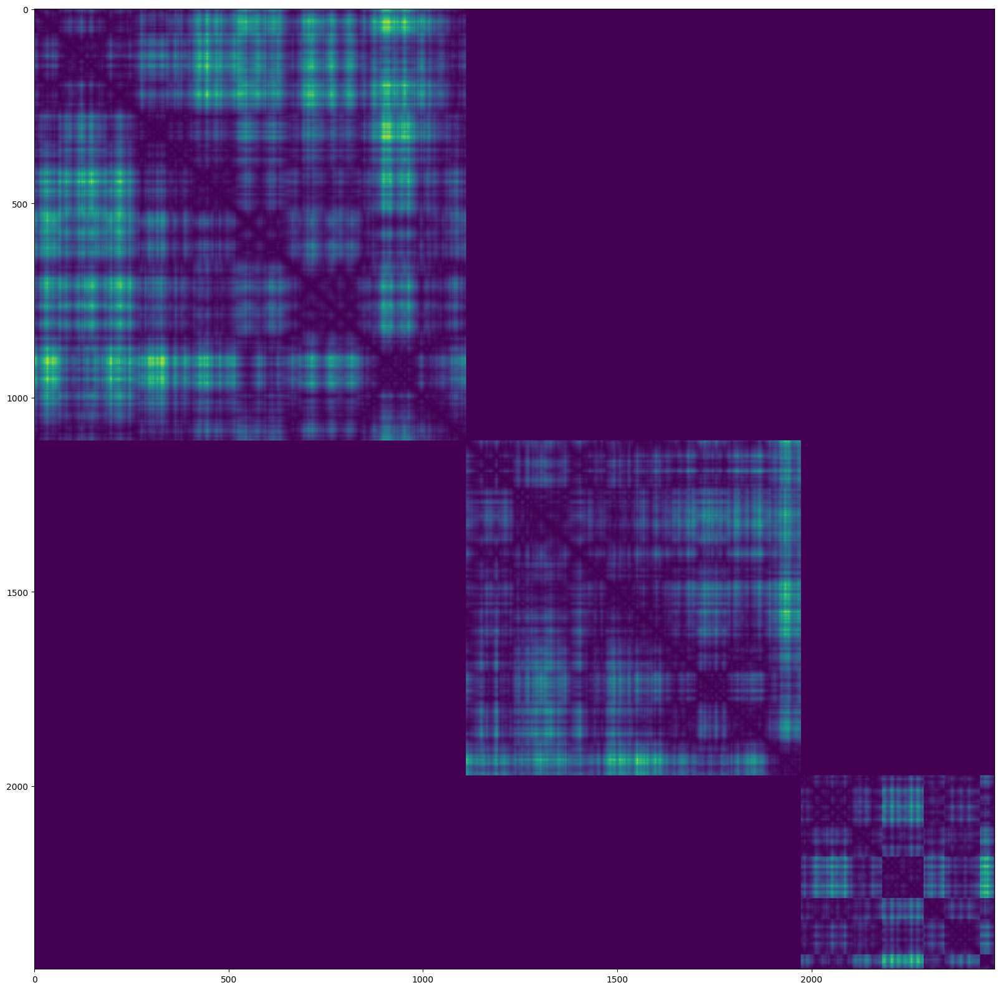

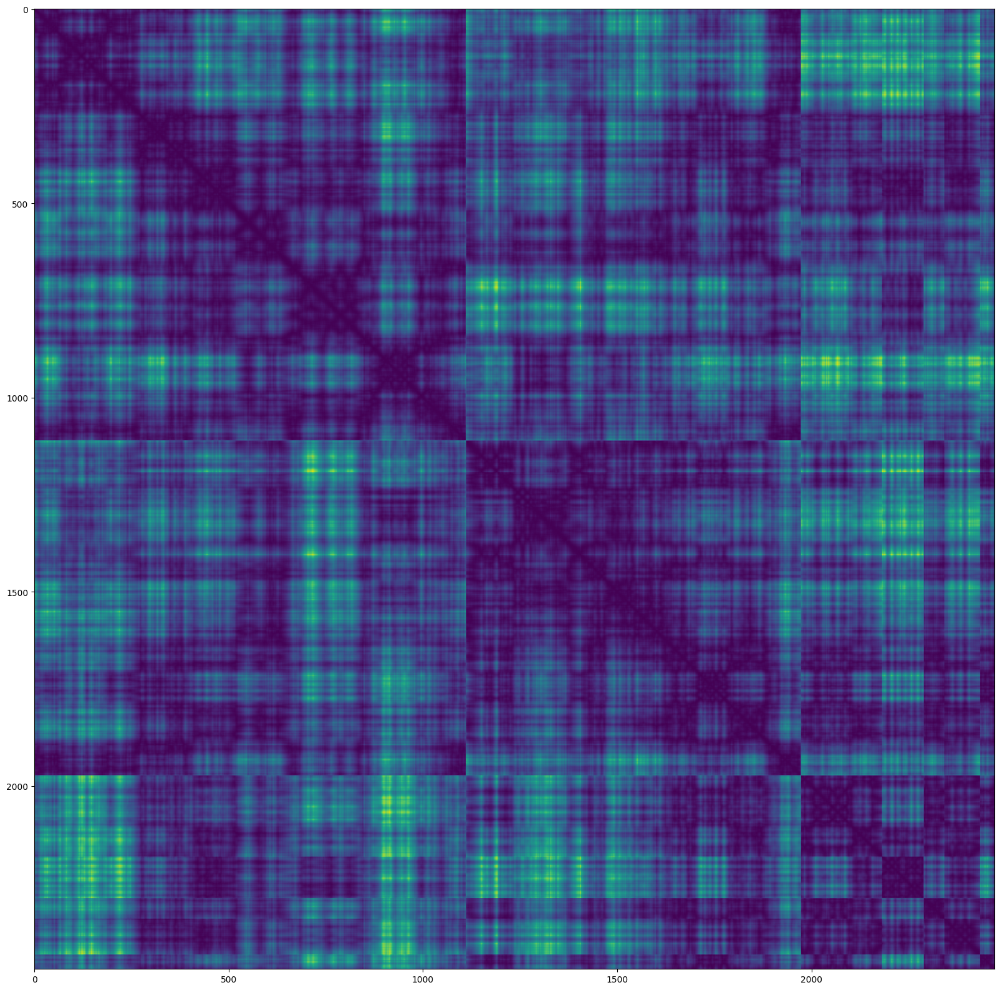

In [95]:
plt.imshow(d_x)
plt.show()
plt.imshow(d_y)
plt.show()

In [25]:
mu_y.shape

(2471,)

0.9999999999999873
#####
0
4.937955217285304e-08
1.3724402137844758
1.0000000000000002


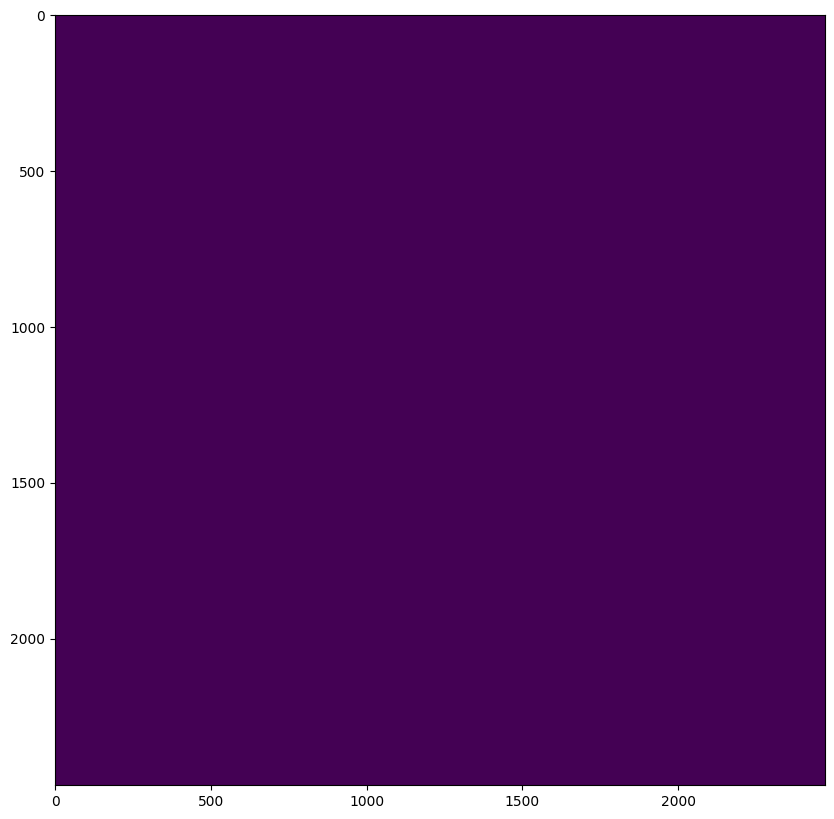

12.380434274673462
#####
1
4.8053409640571295e-08
1.382358755128639
1.0000000000000009


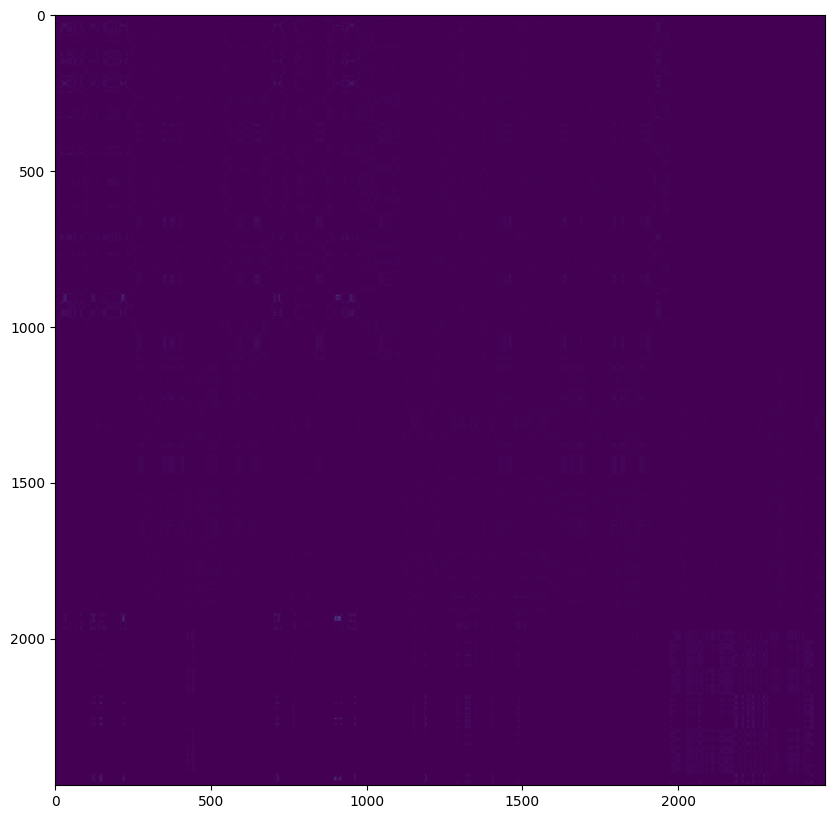

11.5979642868042
#####
2
3.9517062533159266e-08
1.428114302313627
1.0


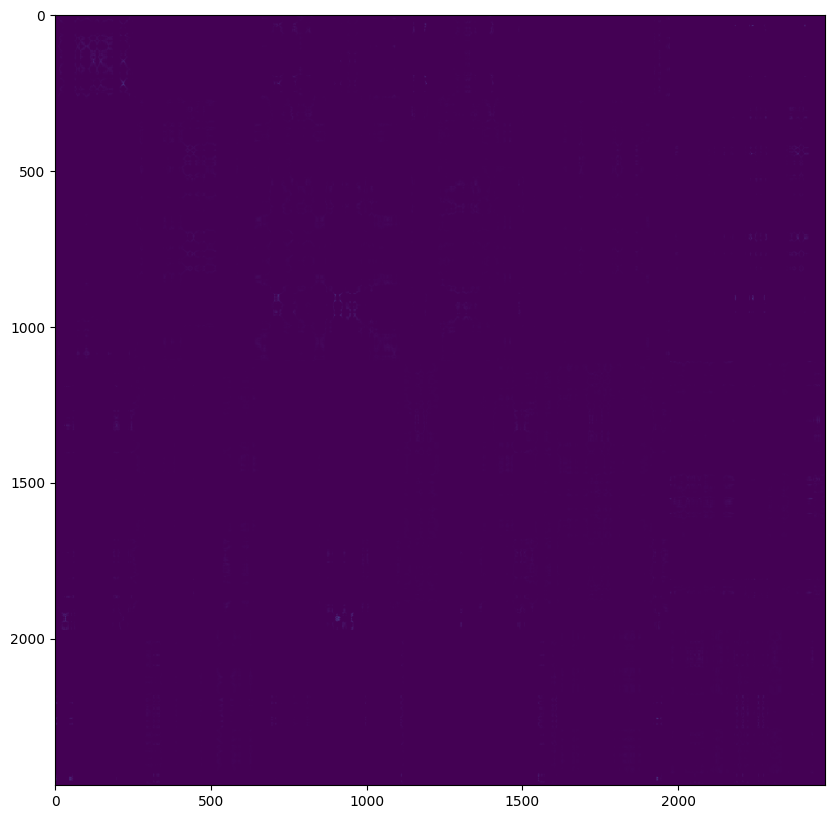

15.29653787612915
#####
3
3.2010515071513796e-08
0.9513611358241482
1.0000000000000002


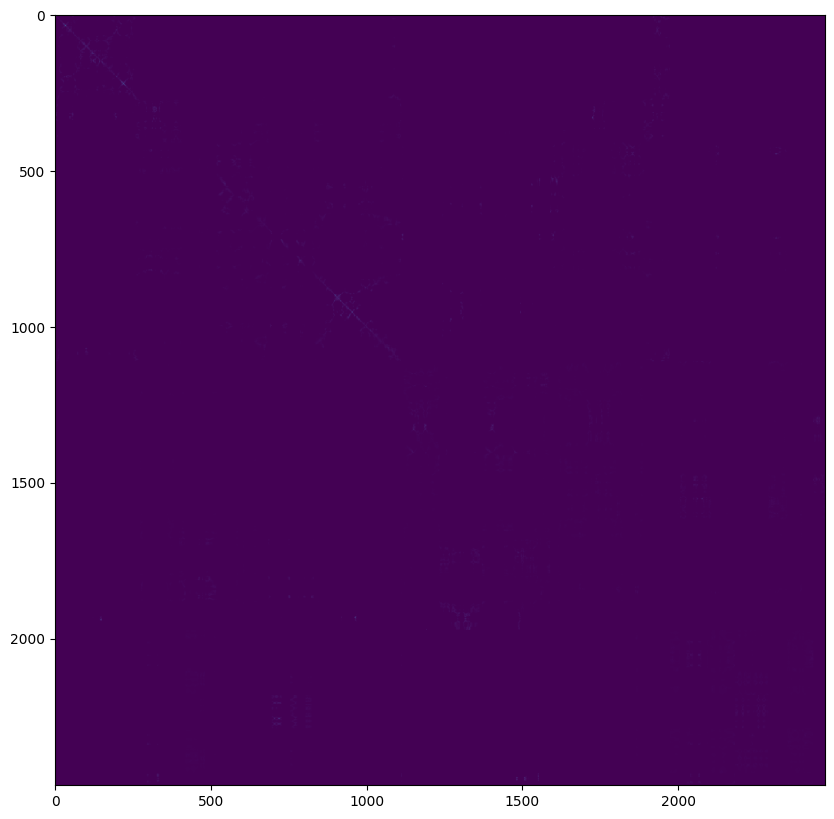

13.692423582077026
#####
4
3.1230569671065117e-08
0.5411580625931375
1.0


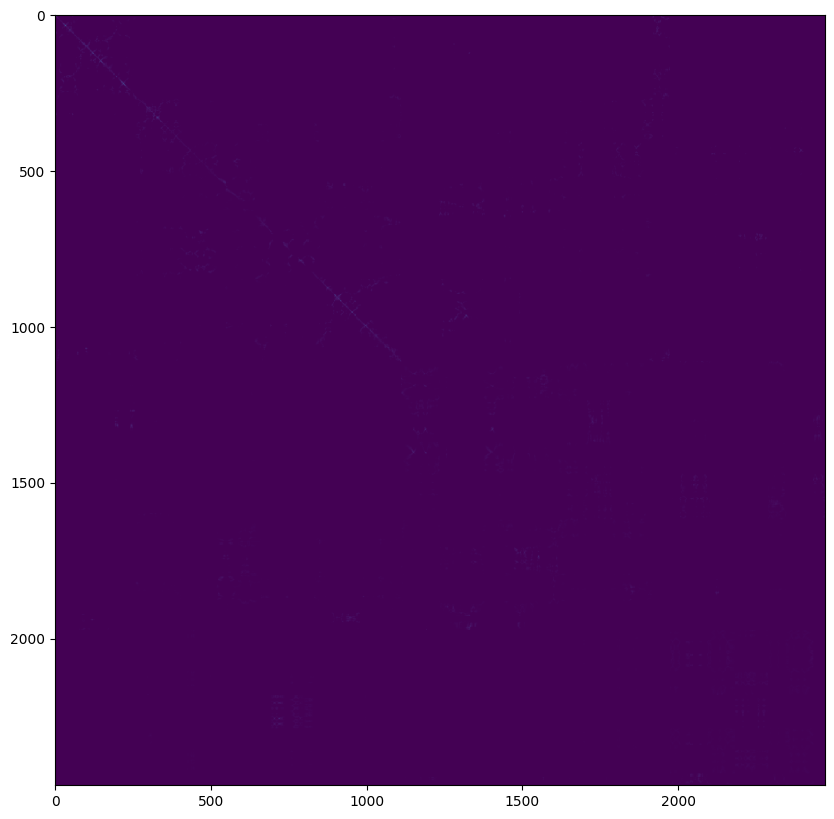

14.605648279190063
#####
5
3.1202360426239505e-08
0.3070694436345777
1.0000000000000007


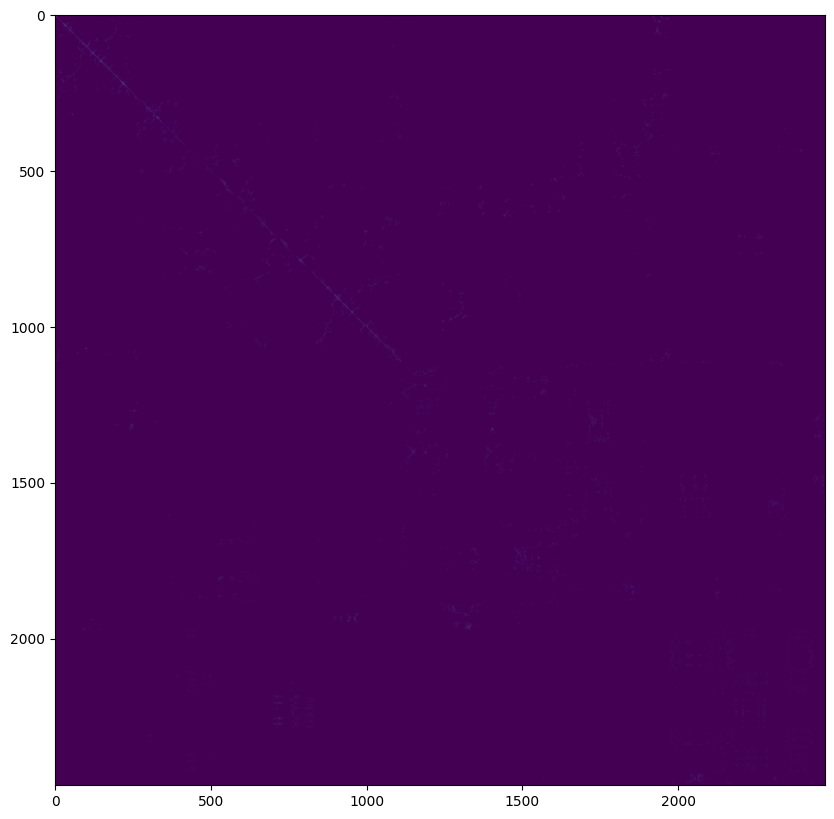

15.292506694793701
#####
6
3.118941190247451e-08
0.18319008148740376
1.0000000000000004


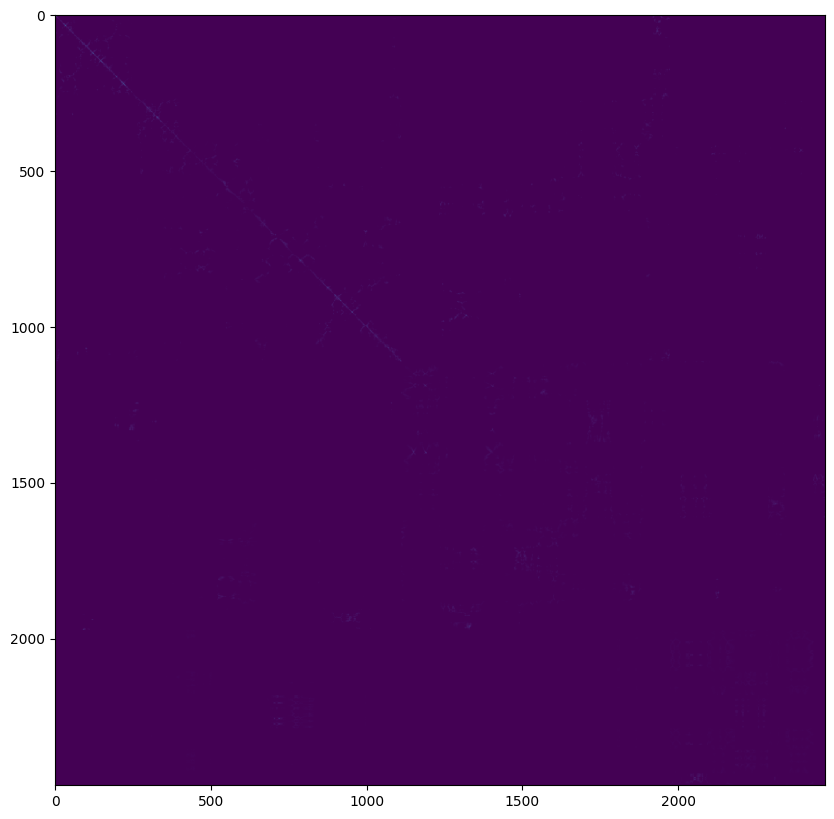

15.55433702468872
#####
7
3.118557625046524e-08
0.1376158384406204
1.0000000000000002


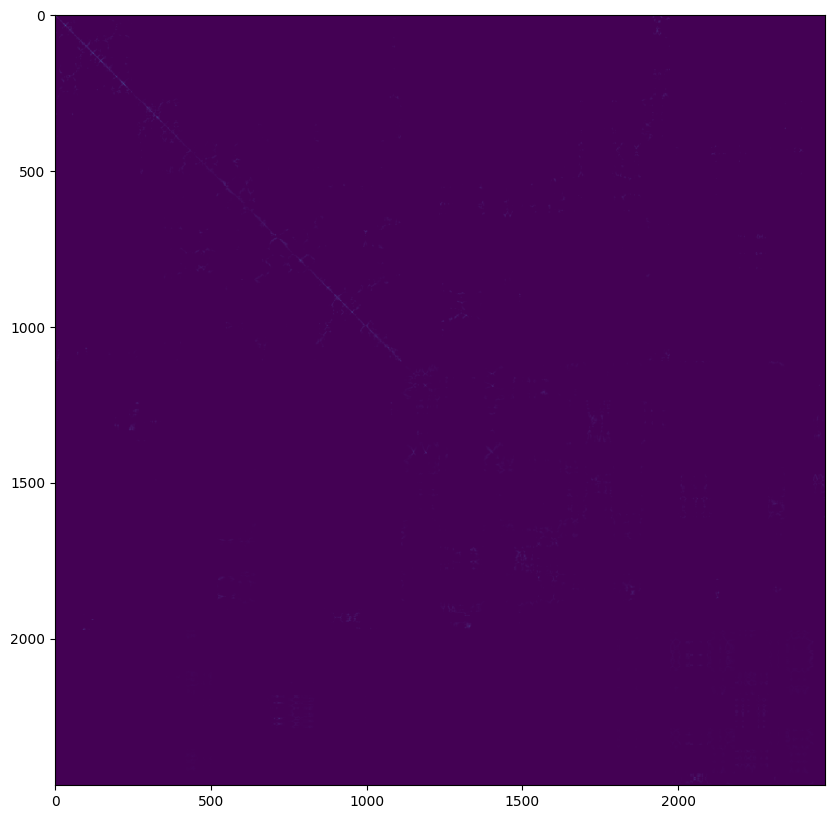

15.49277925491333
#####
8
3.11866881703915e-08
0.10367305805998737
0.9999999999999998


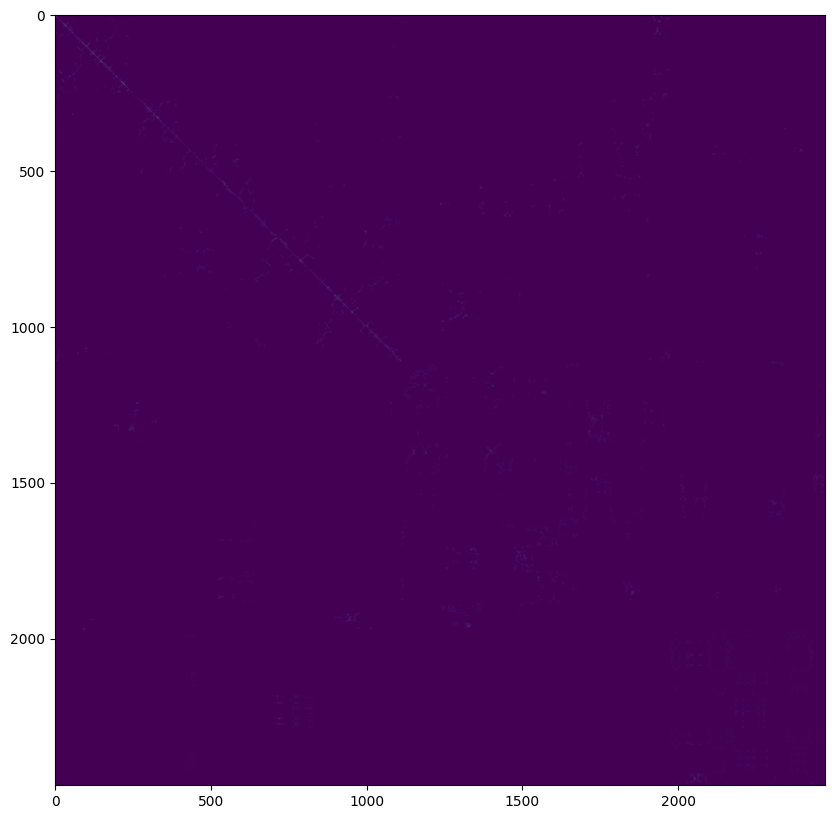

15.91590404510498
#####
9
3.118517573978838e-08
0.08746226410129944
1.0000000000000007


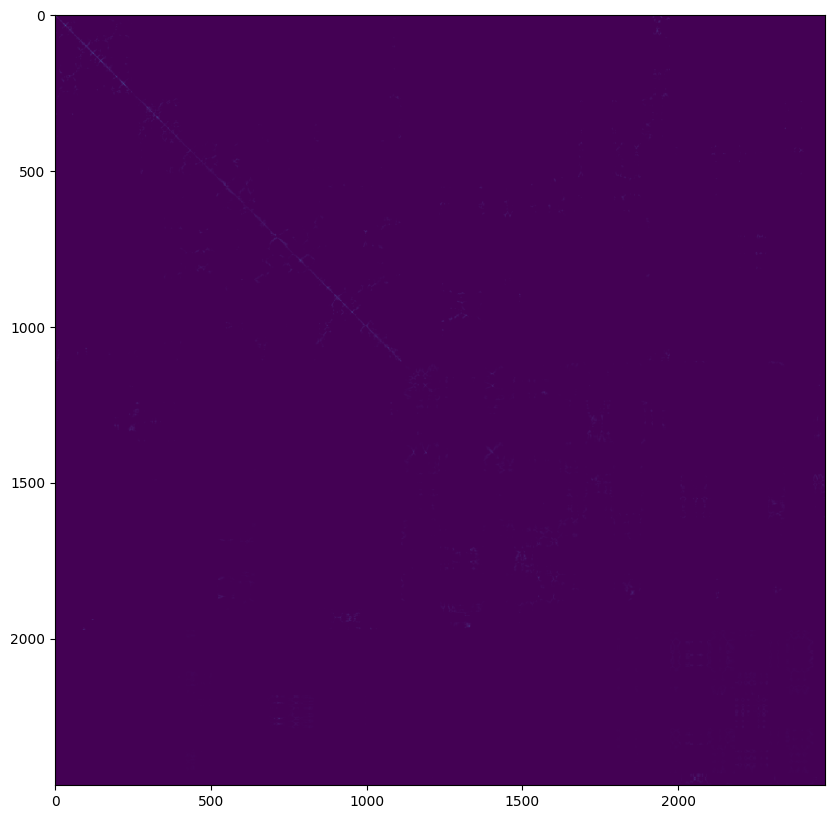

16.23732304573059
#####
10
3.118631683333089e-08
0.07456717146616136
1.000000000000001


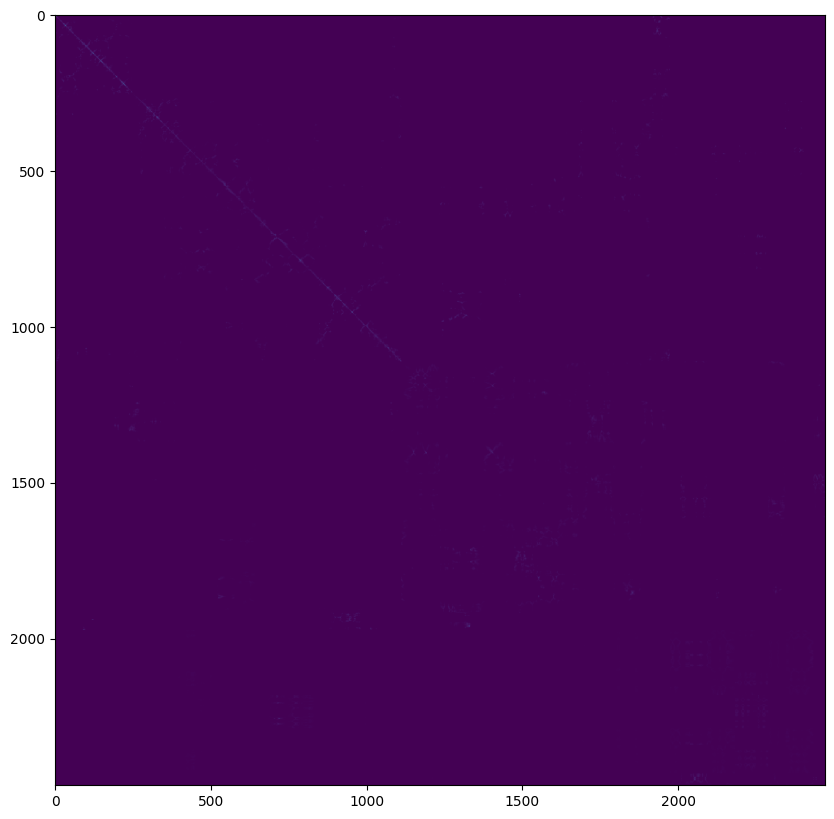

16.793171167373657
#####
11
3.118208412532621e-08
0.0658267825384805
0.9999999999999999


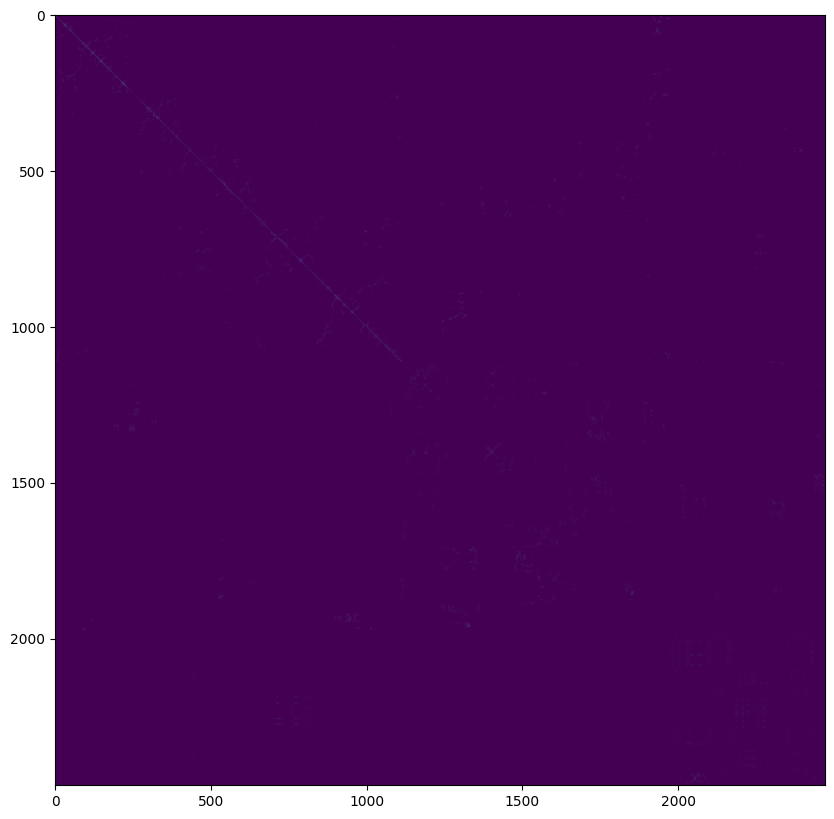

16.71263861656189
#####
12
3.117808800602935e-08
0.05873684957137647
1.0000000000000004


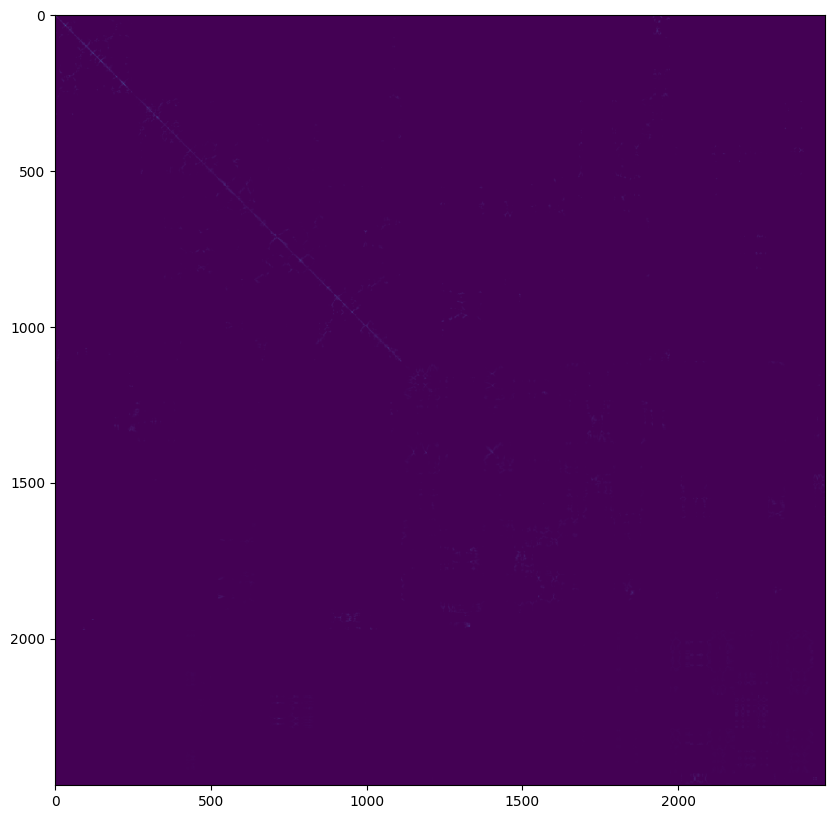

16.29782009124756
#####
13
3.117505938384282e-08
0.053008581447581235
1.0000000000000004


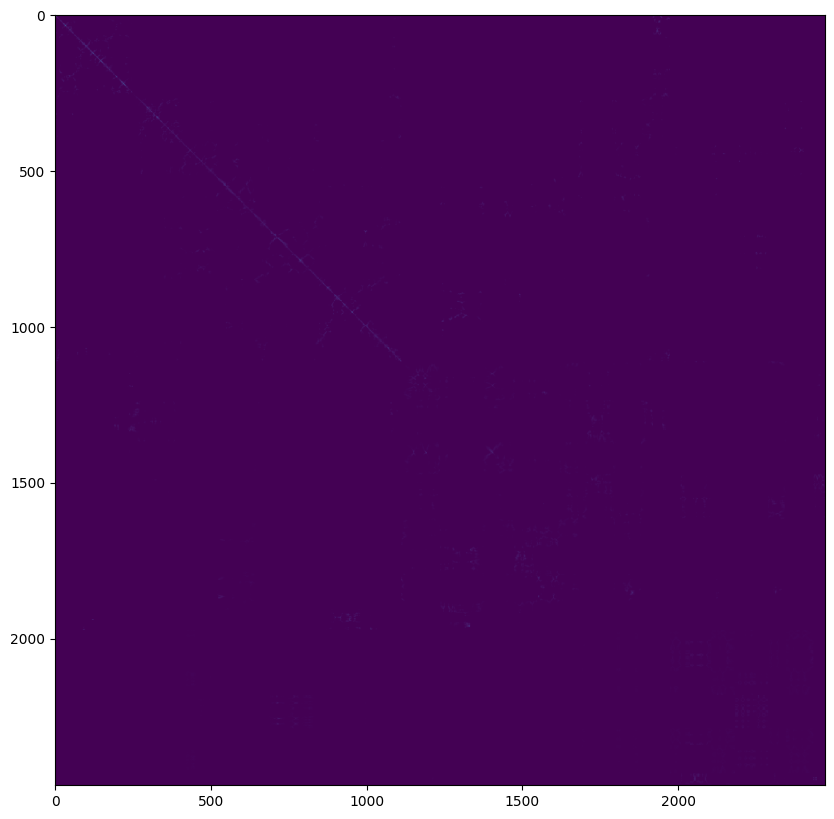

16.737812757492065
#####
14
3.1172764074362784e-08
0.048105480614164225
1.0000000000000009


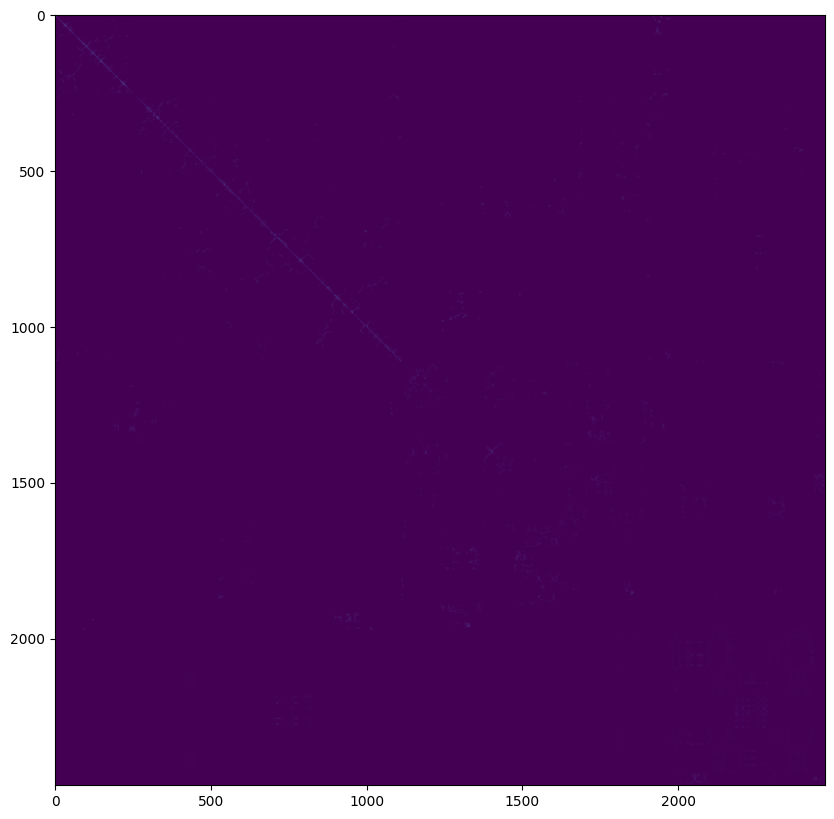

16.601426124572754
#####
15
3.117101700517699e-08
0.043853692759397336
0.9999999999999993


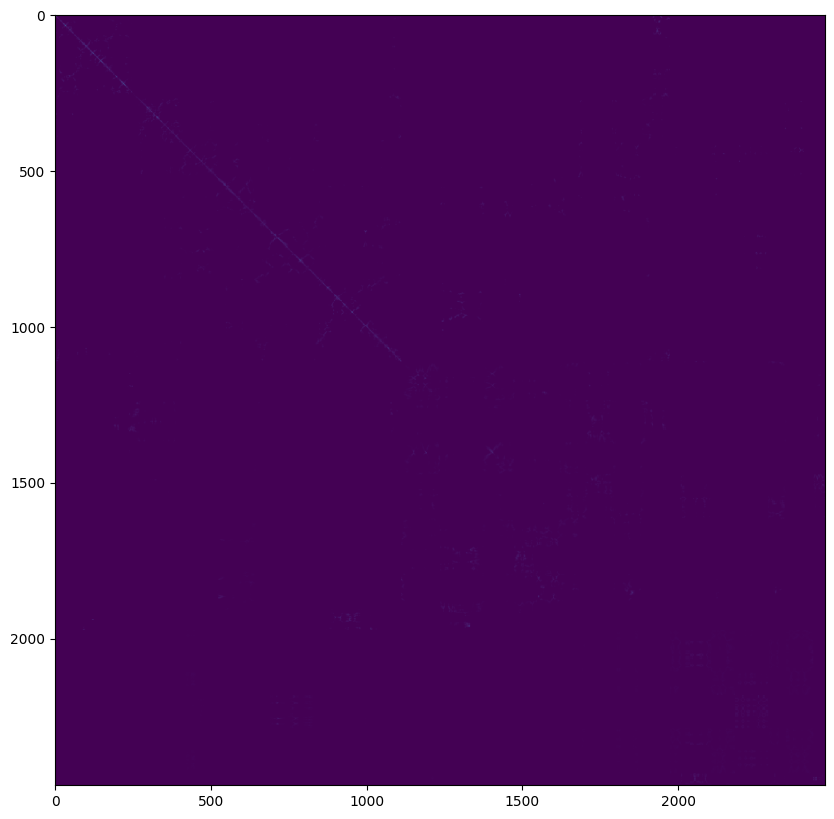

16.46665072441101
#####
16
3.116975323769577e-08
0.040008440683928496
0.9999999999999994


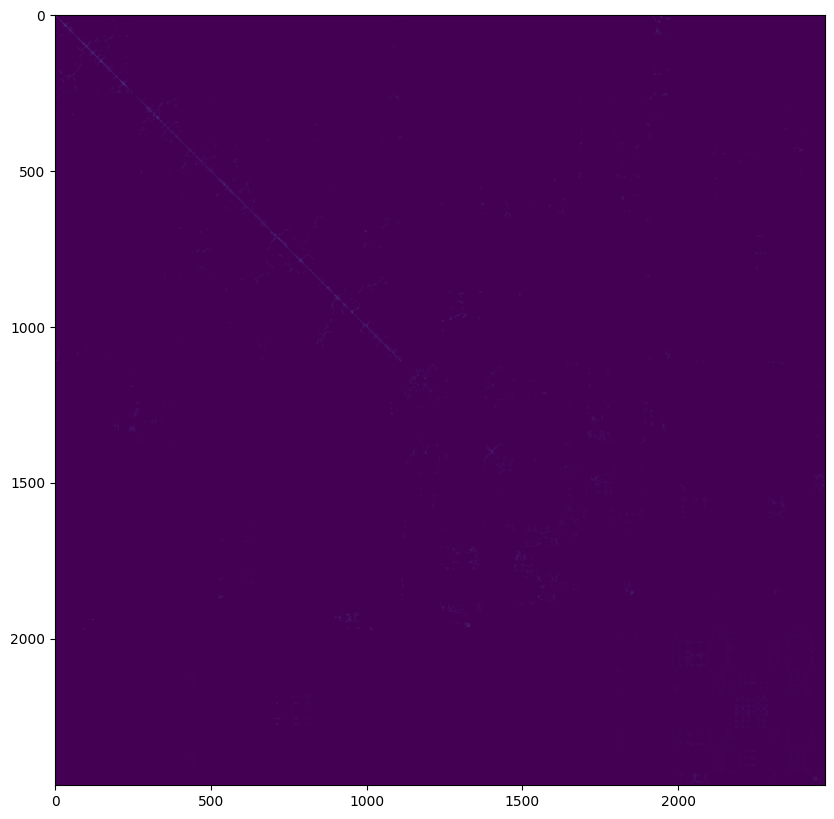

16.663235664367676
#####
17
3.116883227165528e-08
0.036477198733942444
1.0


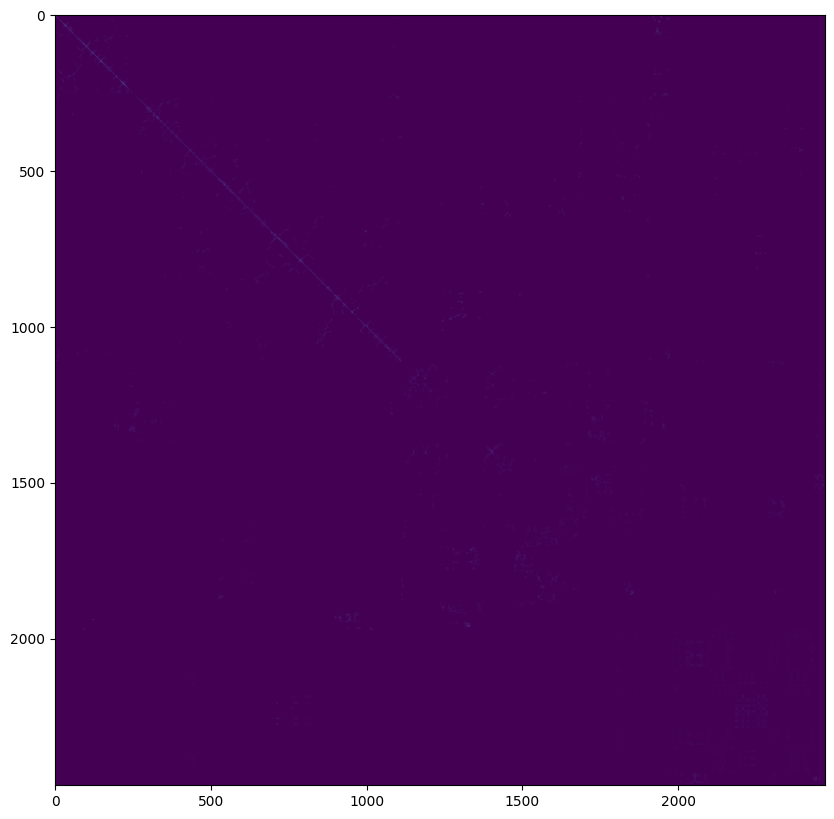

17.45381808280945
#####
18
3.116821397789054e-08
0.03317119092774658
0.9999999999999994


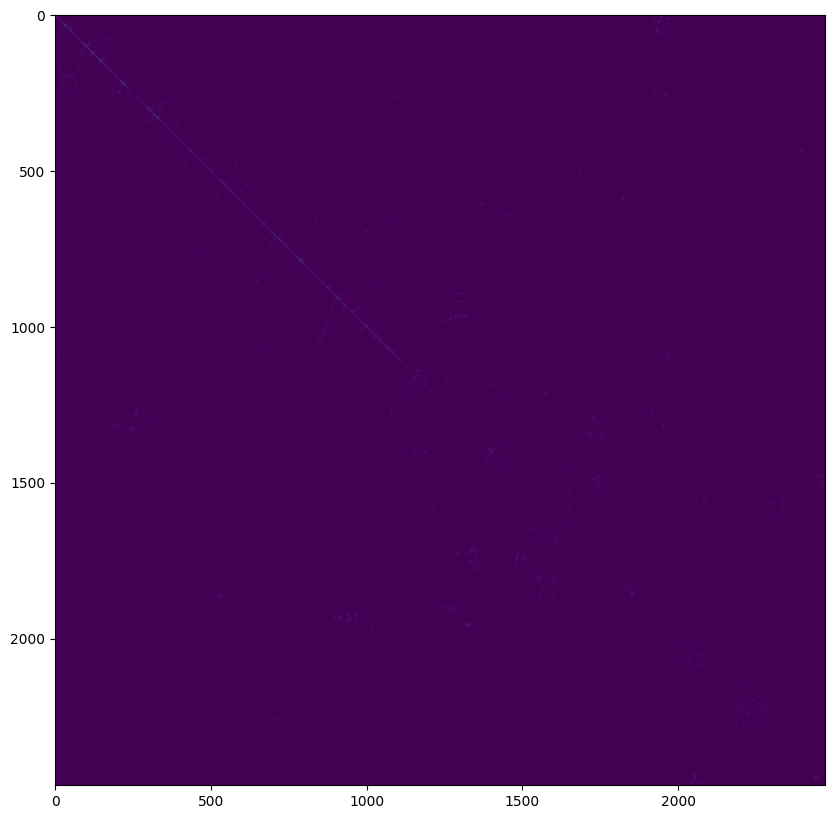

16.297033548355103
#####
19
3.116782020611657e-08
0.030053782474080214
1.0000000000000007


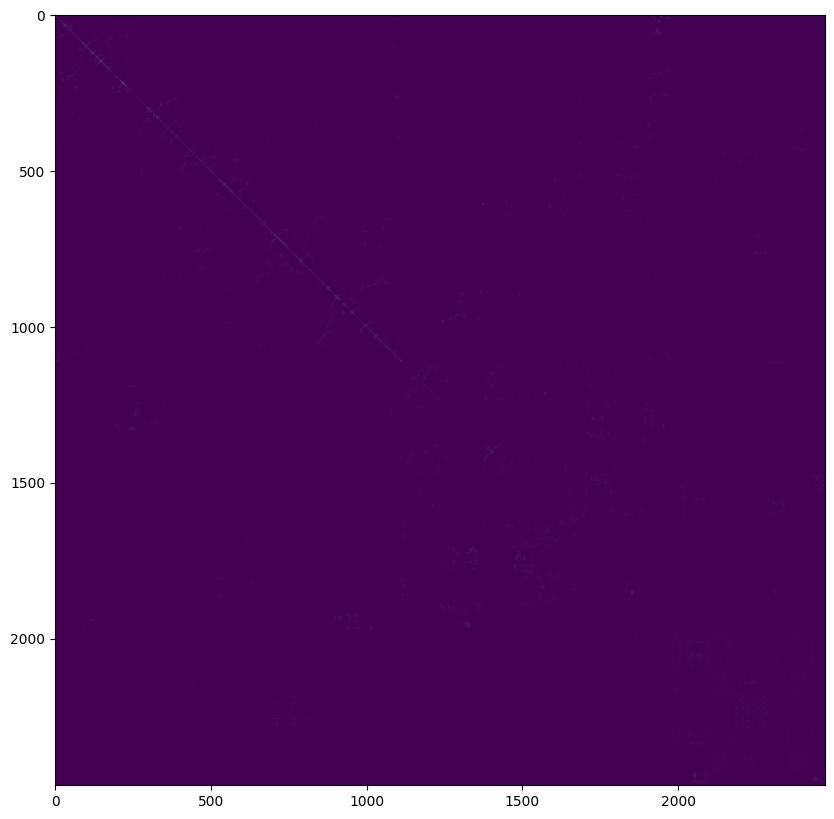

17.235002517700195
#####
20
3.116761838393933e-08
0.027106813483905697
1.0000000000000004


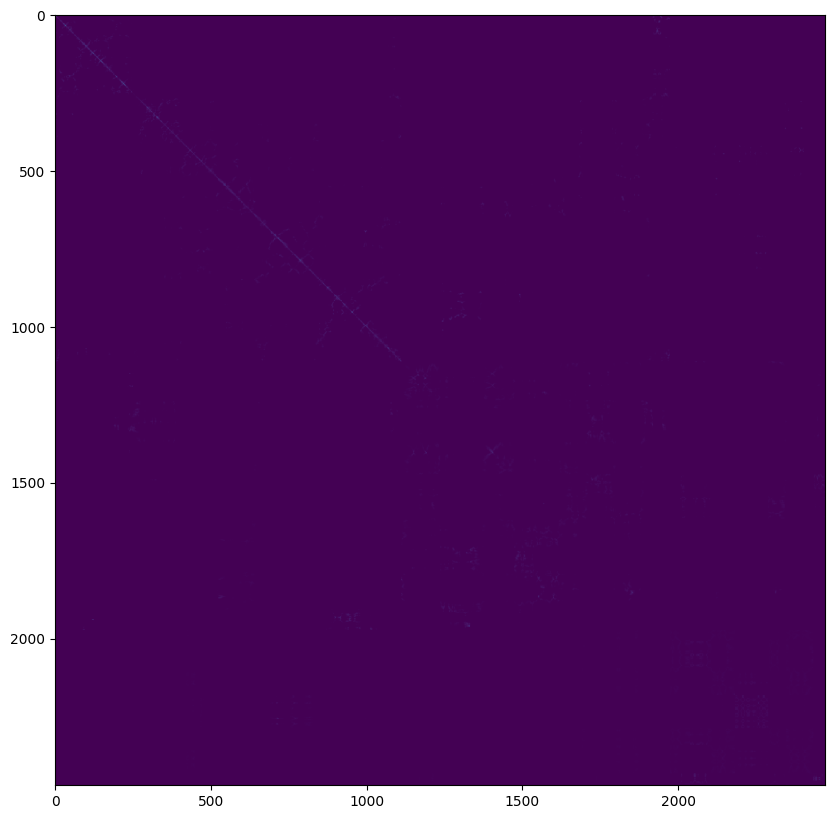

16.657792568206787
#####
21
3.116756253502619e-08
0.0243387585190954
1.0000000000000013


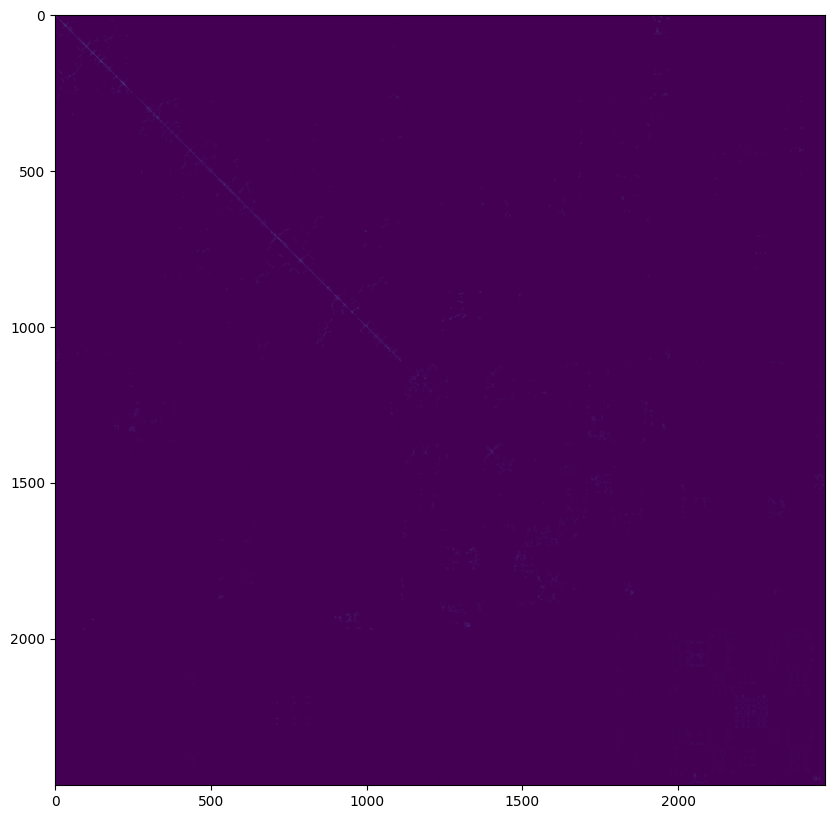

16.779484033584595
#####
22
3.116762429301563e-08
0.021751953191237735
1.0000000000000007


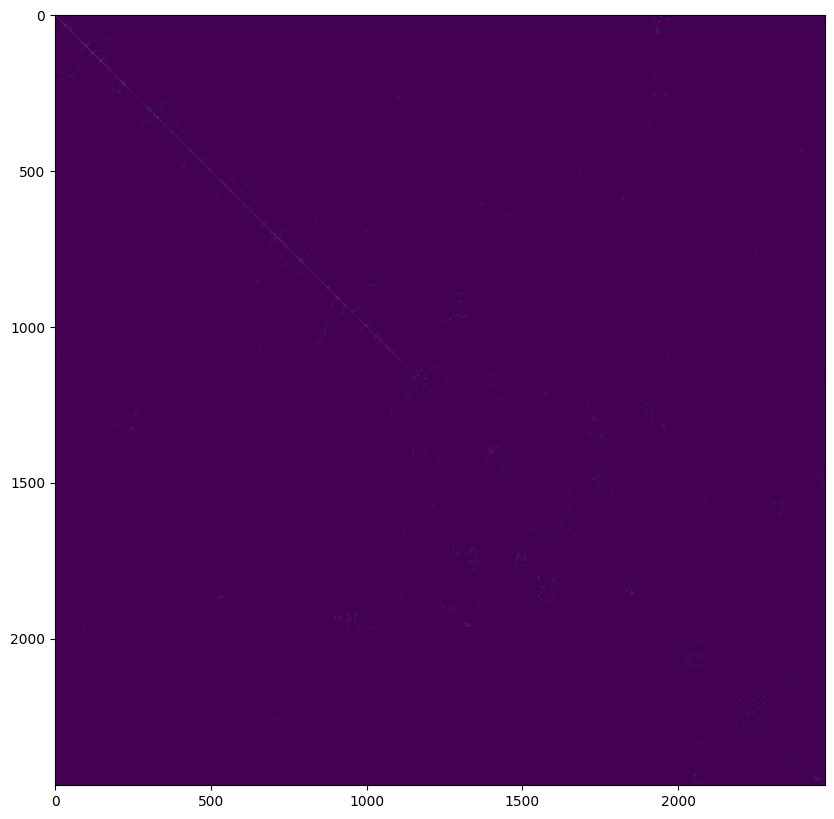

16.838465690612793
#####
23
3.1167772385092305e-08
0.01935841970218978
0.9999999999999998


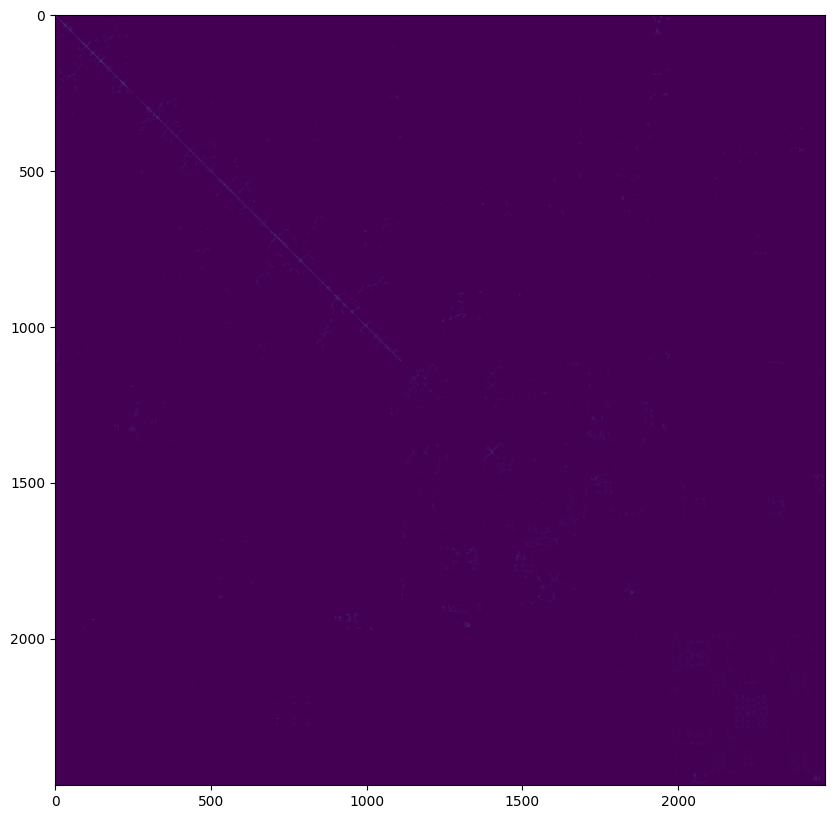

16.56893563270569
#####
24
3.11677973008501e-08
0.017158205358642417
0.9999999999999996


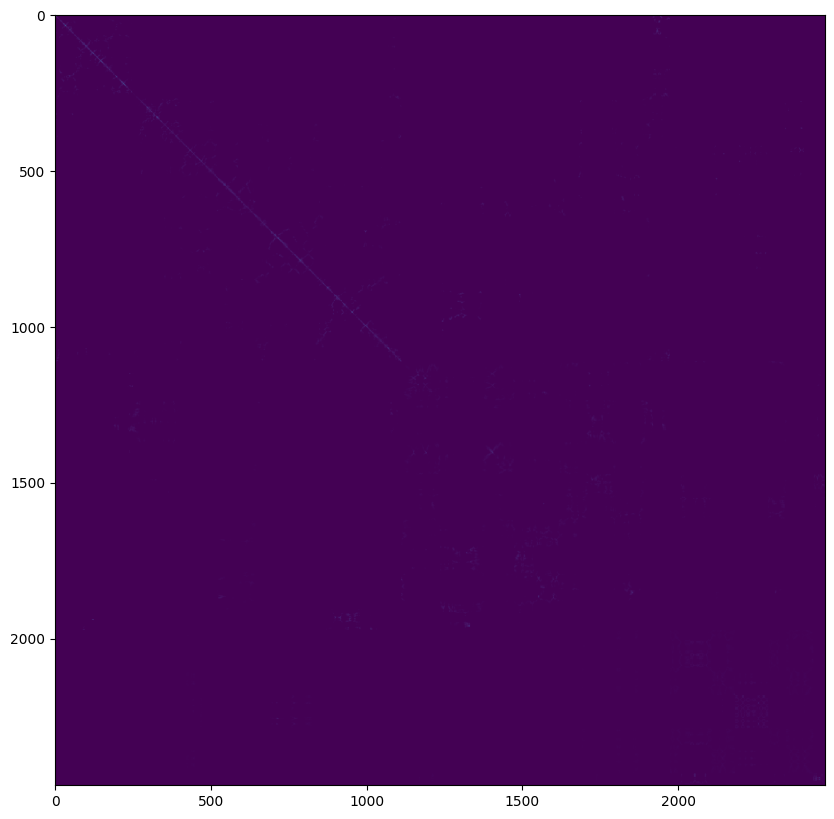

16.830537796020508
#####
25
3.116658261691062e-08
0.015152816381876169
1.0000000000000004


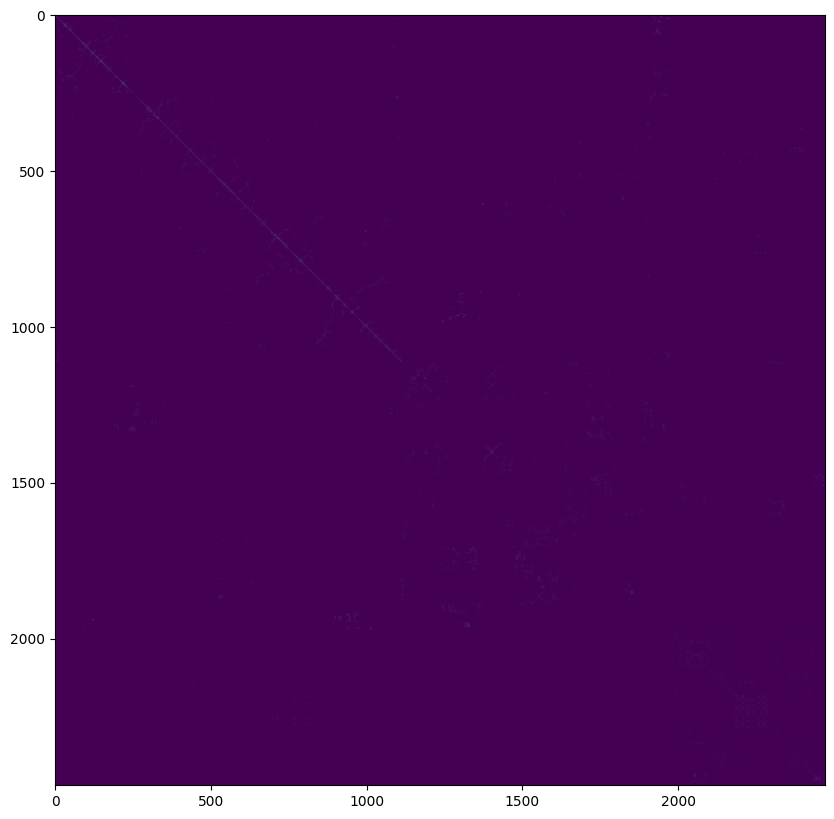

16.282785177230835
#####
26
3.116553961422855e-08
0.013342889128301802
1.0000000000000002


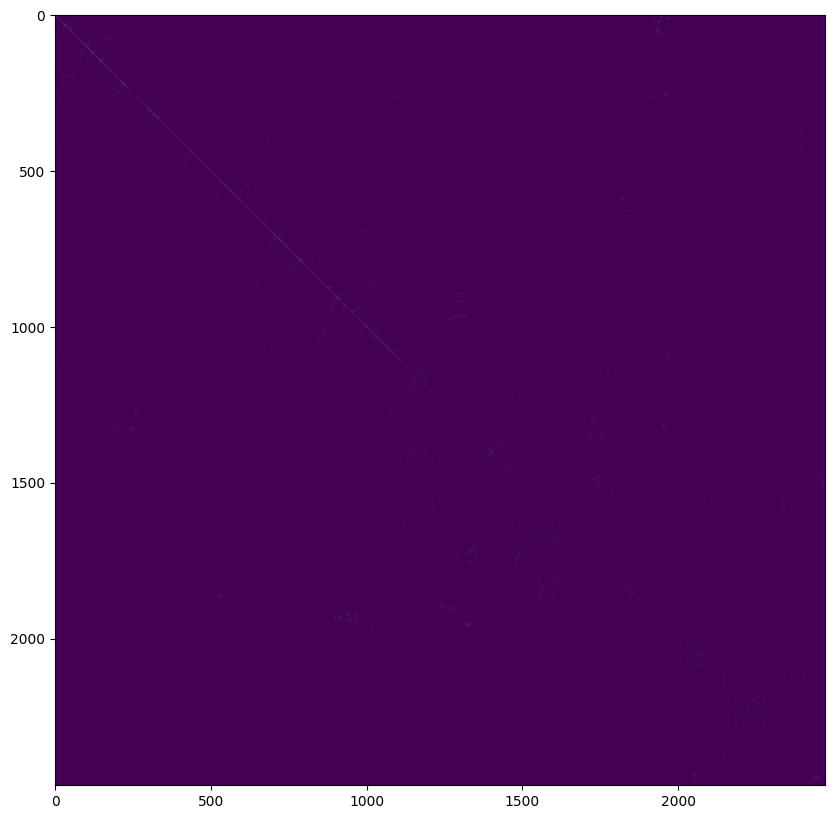

17.93679690361023
#####
27
3.116464645144297e-08
0.011720446268632775
1.0000000000000002


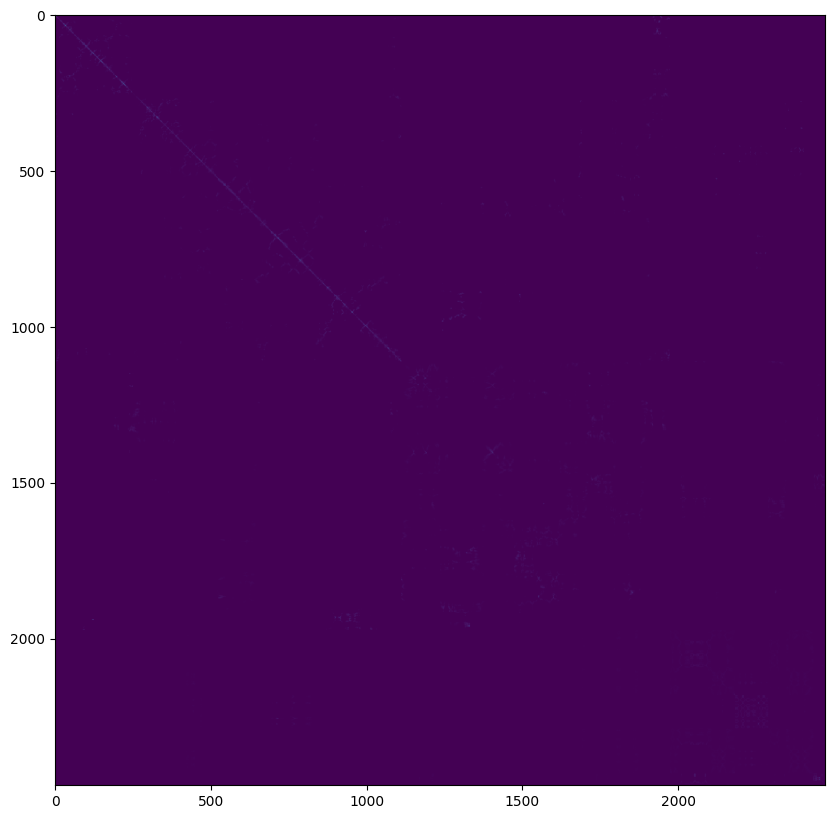

16.880109071731567
#####
28
3.1163882945747566e-08
0.010276659165142032
0.9999999999999992


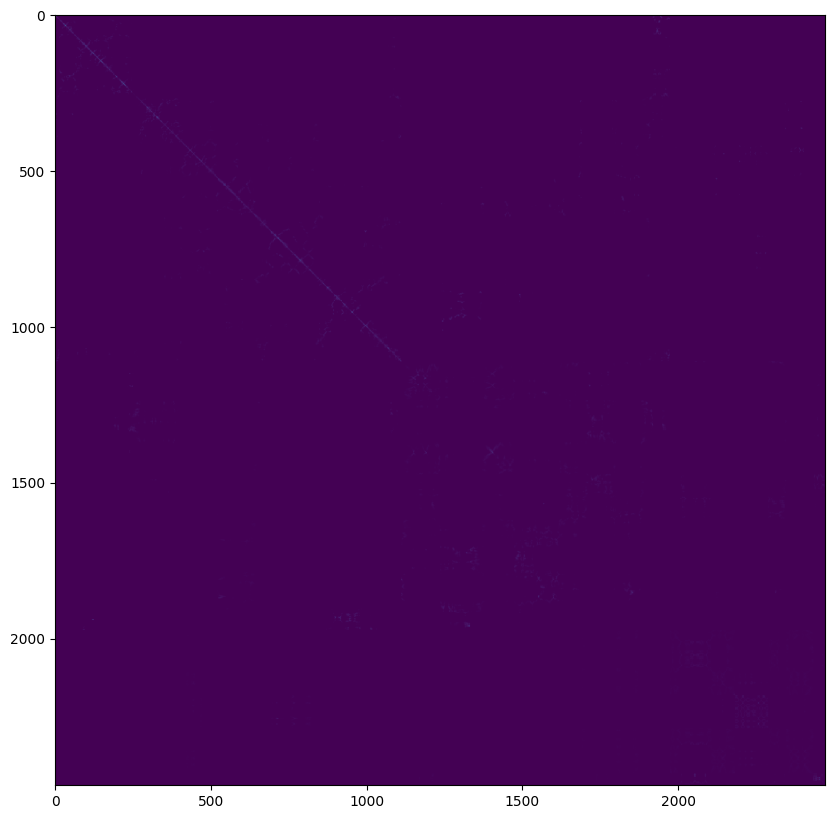

16.67199420928955
#####
29
3.116323116353721e-08
0.008999091477721485
0.9999999999999997


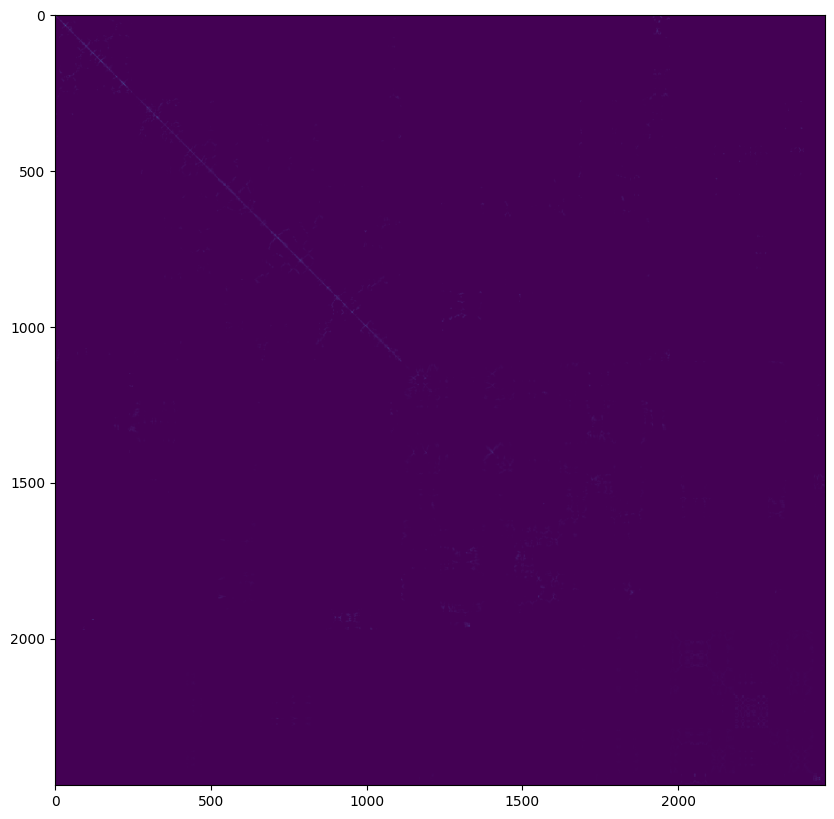

16.862632036209106
#####
30
3.116267515223411e-08
0.00787431034591613
0.9999999999999999


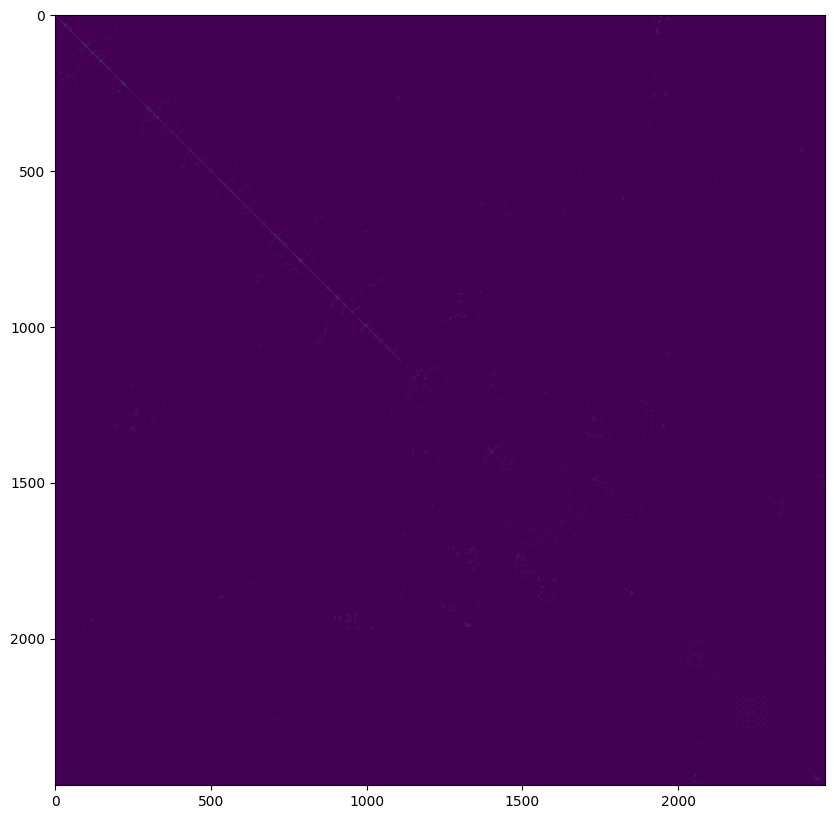

16.799806356430054
#####
31
3.116220103733484e-08
0.00688793327887129
0.9999999999999999


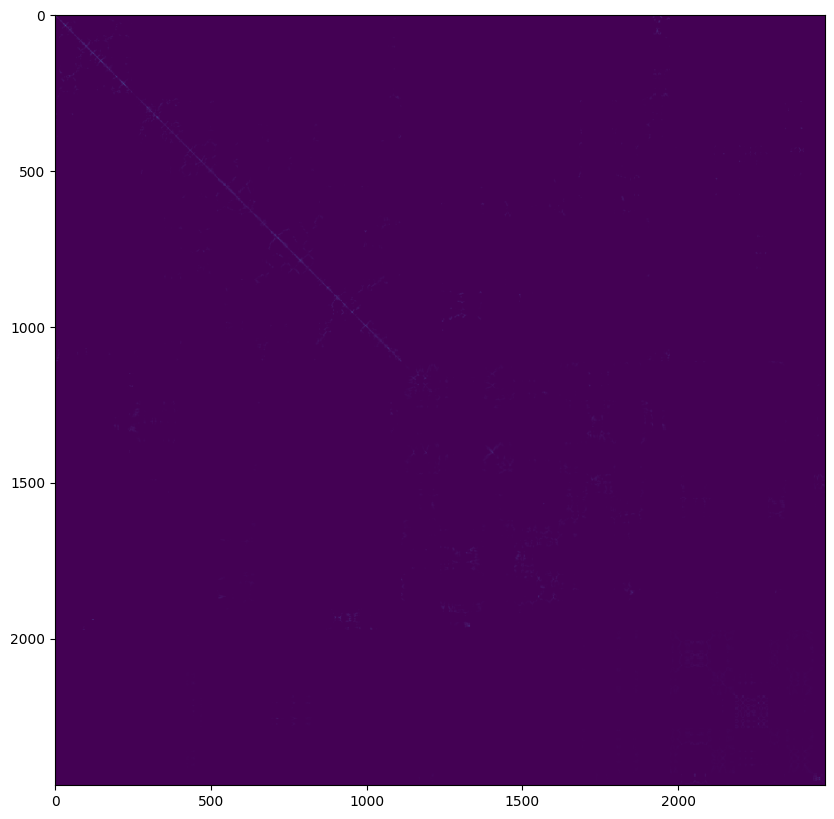

17.117894649505615
#####
32
3.1161796772215625e-08
0.006026131387944779
1.000000000000001


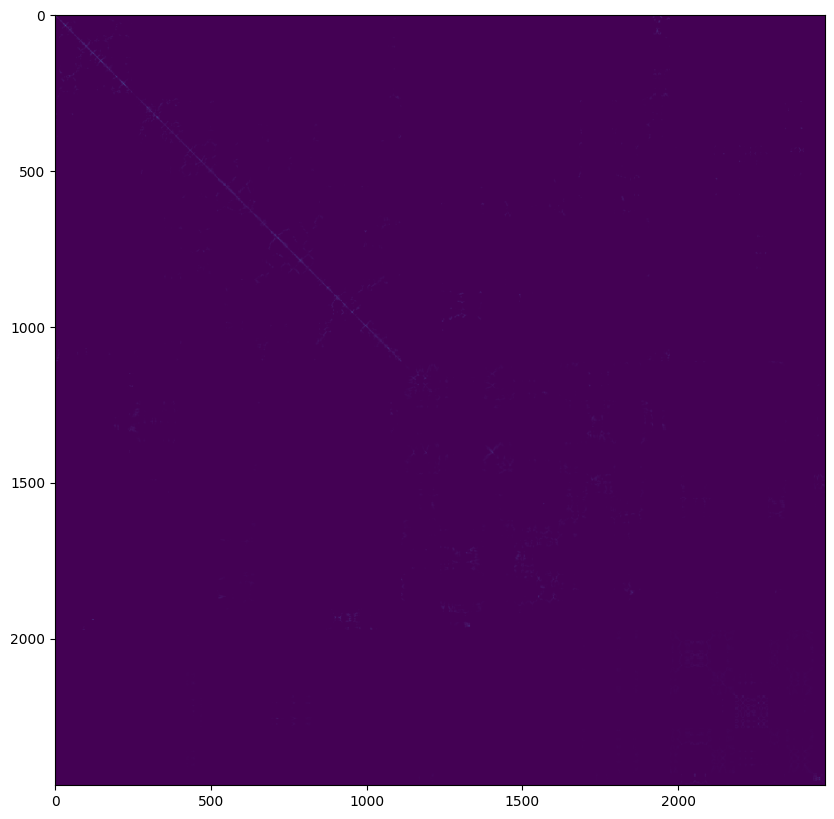

16.365873098373413
#####
33
3.1161452004076136e-08
0.005275487596116735
1.0000000000000007


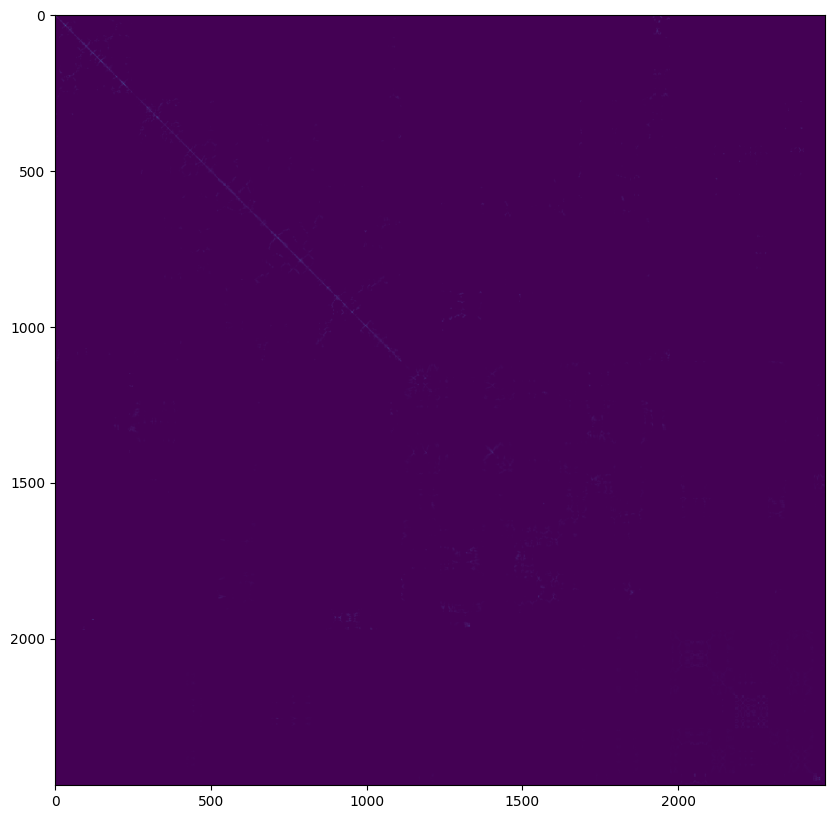

15.876712083816528
#####
34
3.1161157867314493e-08
0.004623022032989912
1.0000000000000002


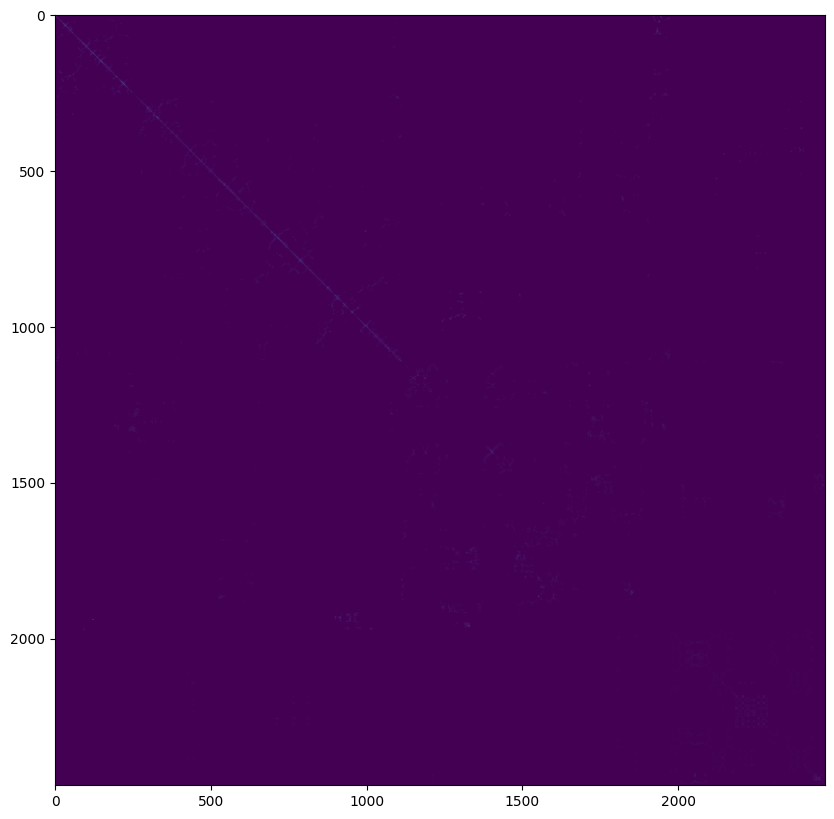

15.961924314498901
#####
35
3.116090680353926e-08
0.004056771489632966
1.0000000000000009


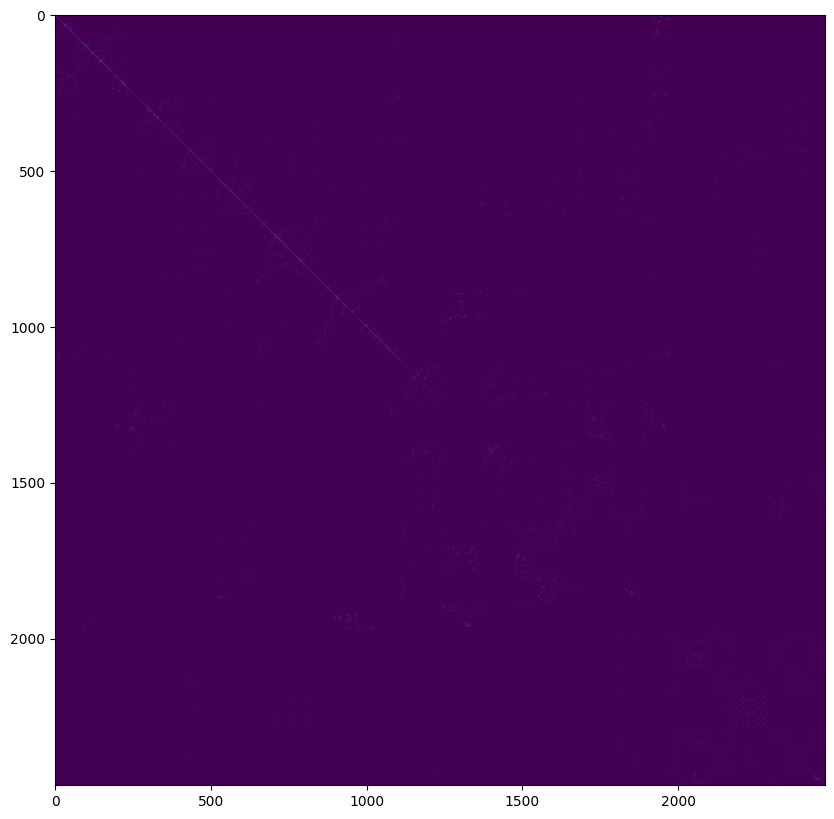

15.950302362442017
#####
36
3.11606923813285e-08
0.003565867399938412
1.0


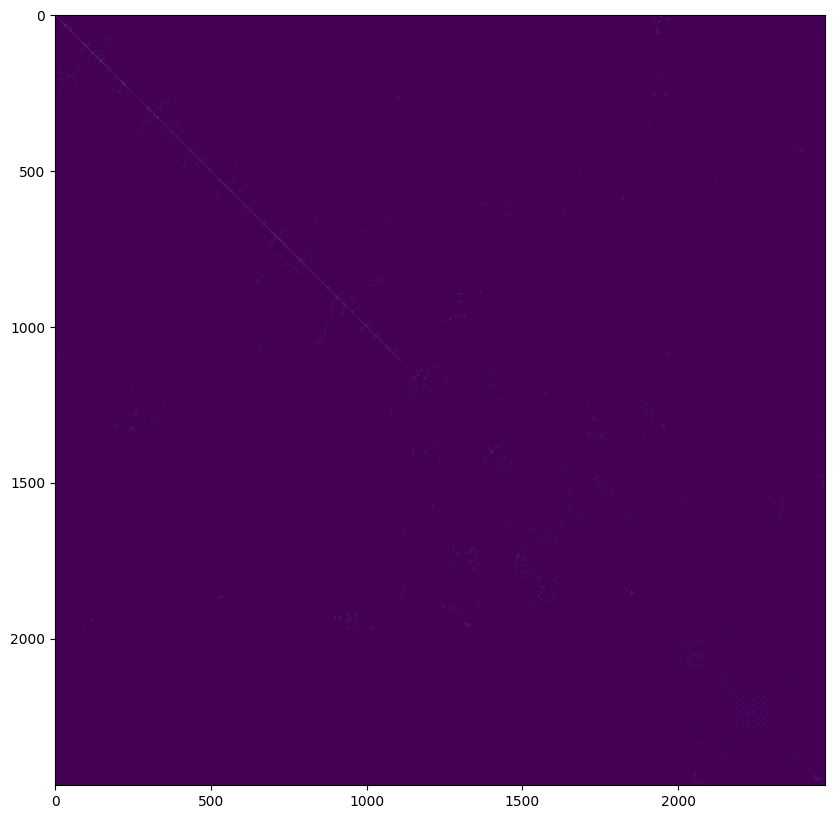

16.367650747299194
#####
37
3.116050913784212e-08
0.0031406649447785068
0.9999999999999996


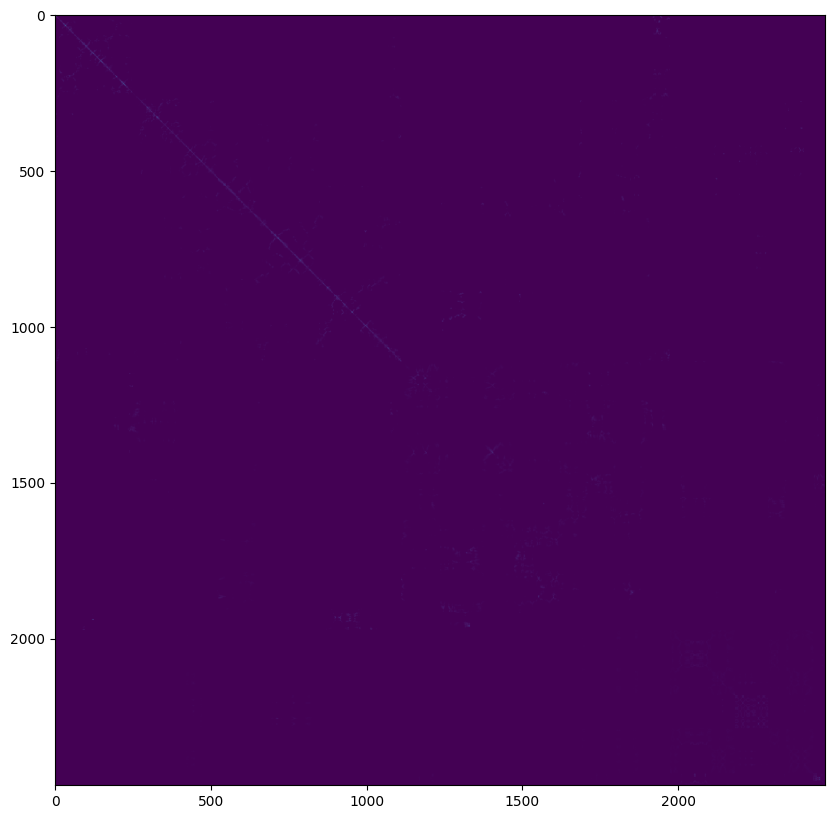

15.733259439468384
#####
38
3.1160352447230255e-08
0.002772414913098324
1.0000000000000013


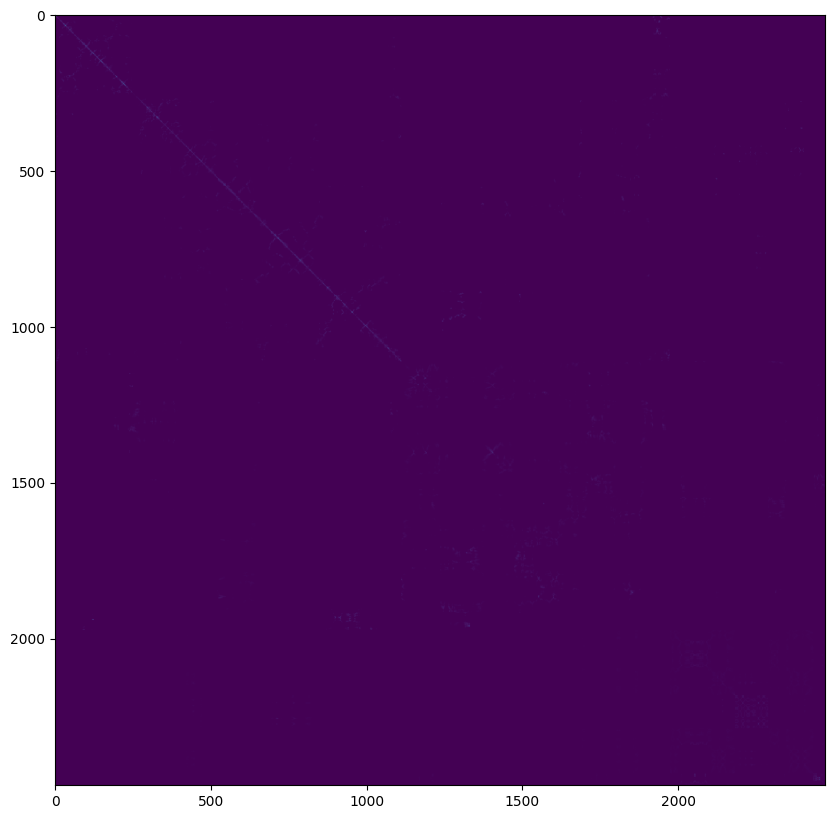

16.23942732810974
#####
39
3.116021835115112e-08
0.0024534051727007136
1.0000000000000013


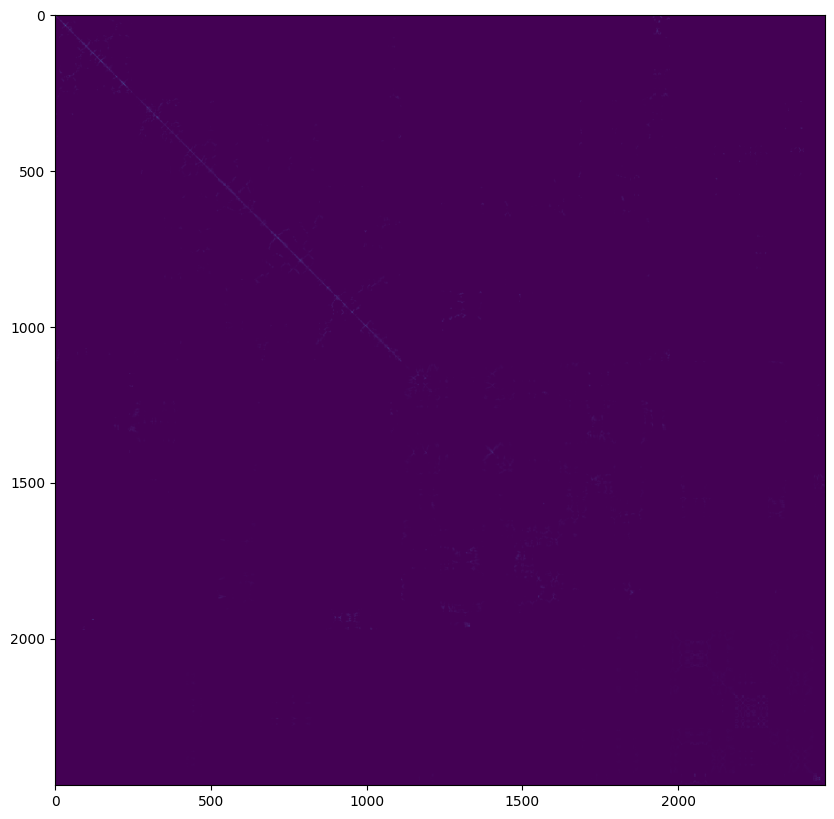

16.446287393569946
#####
40
3.116010352236307e-08
0.0021768786607544023
1.0000000000000007


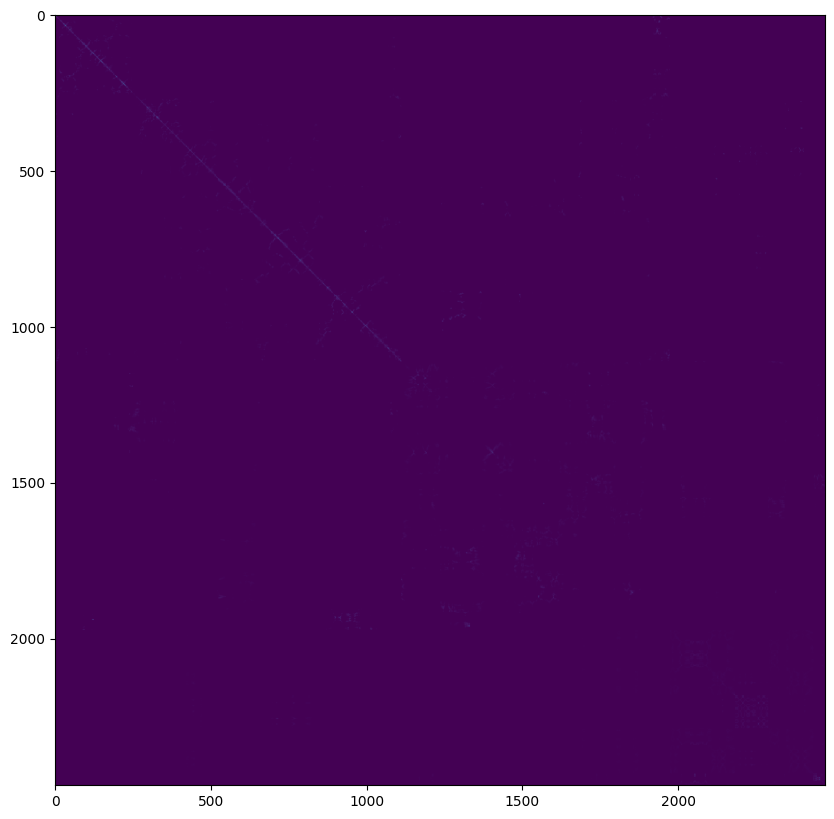

15.681161642074585
#####
41
3.116000512362065e-08
0.0019368561402252449
1.0000000000000002


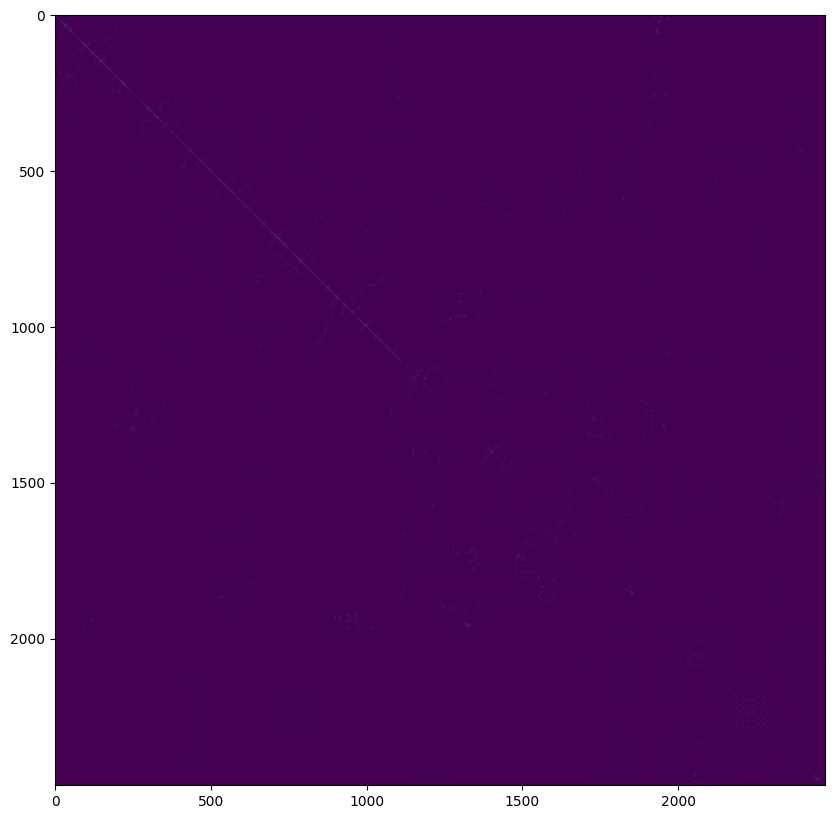

16.355937957763672
#####
42
3.115992074634597e-08
0.001728228442562244
0.9999999999999998


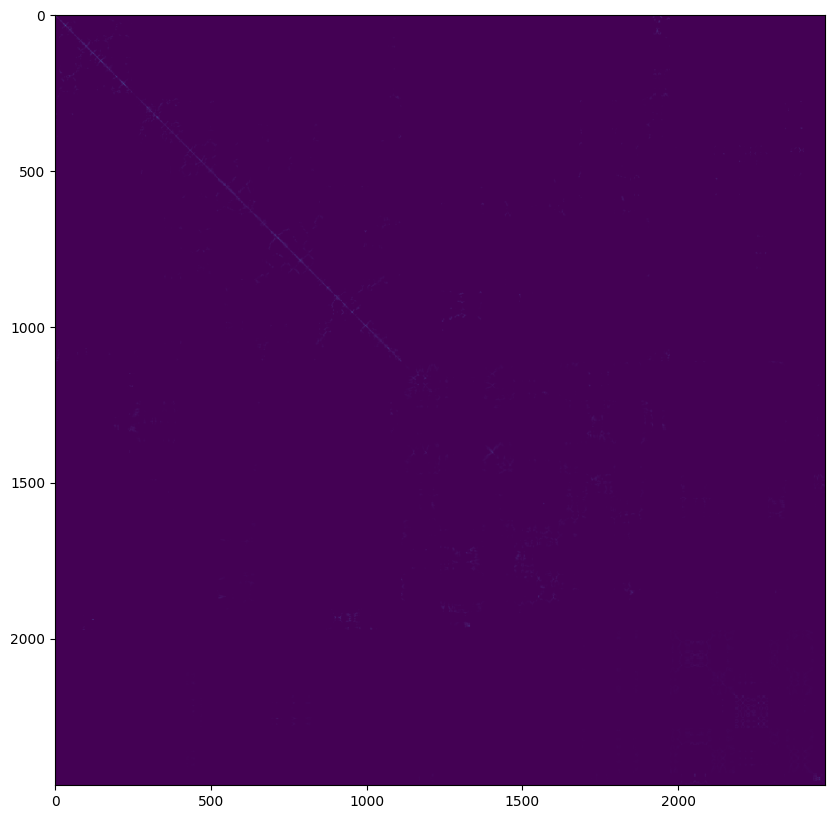

16.597553491592407
#####
43
3.1159848342214056e-08
0.0015466756713424204
1.0000000000000004


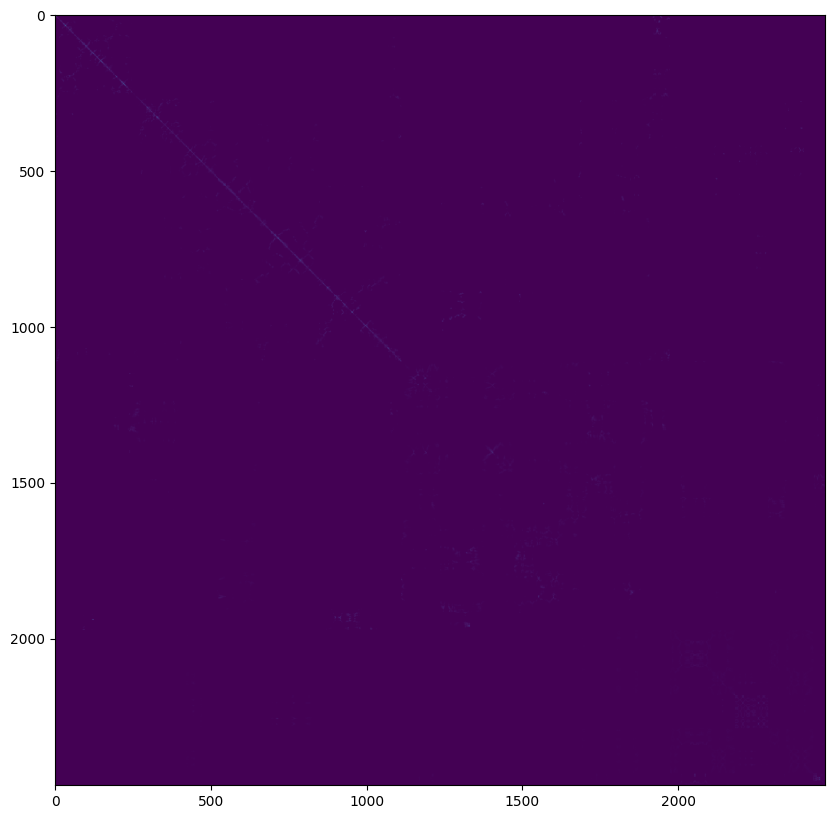

15.994159698486328
#####
44
3.1159786168899945e-08
0.001388382084213915
0.9999999999999998


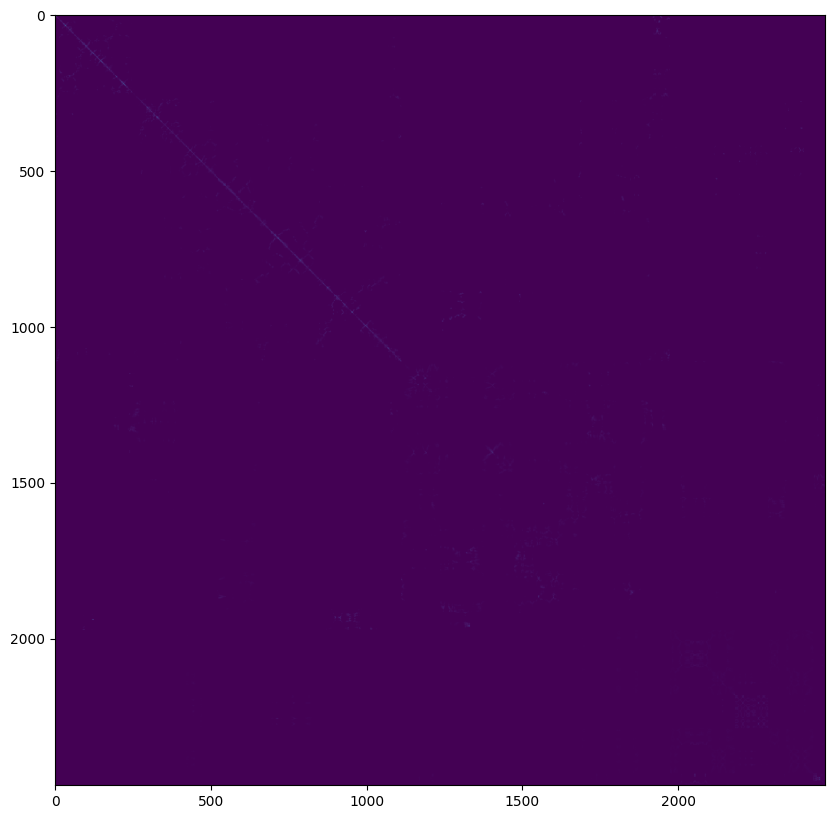

16.643561124801636
#####
45
3.1159732742889614e-08
0.0012500395244628506
1.0000000000000004


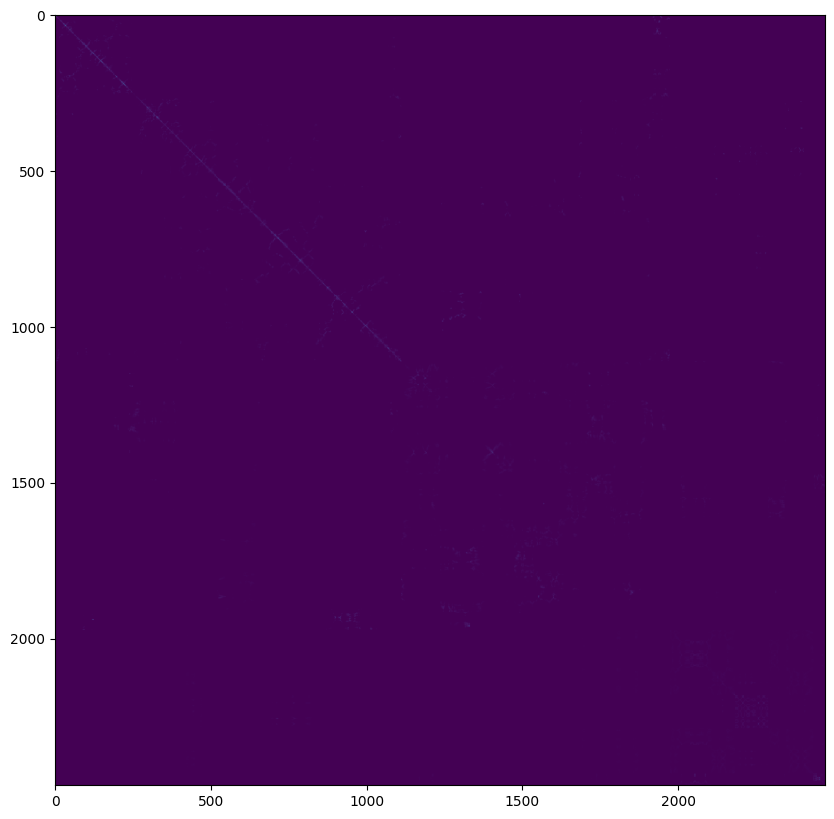

16.228195190429688
#####
46
3.11596868002879e-08
0.0011288635026890231
0.9999999999999989


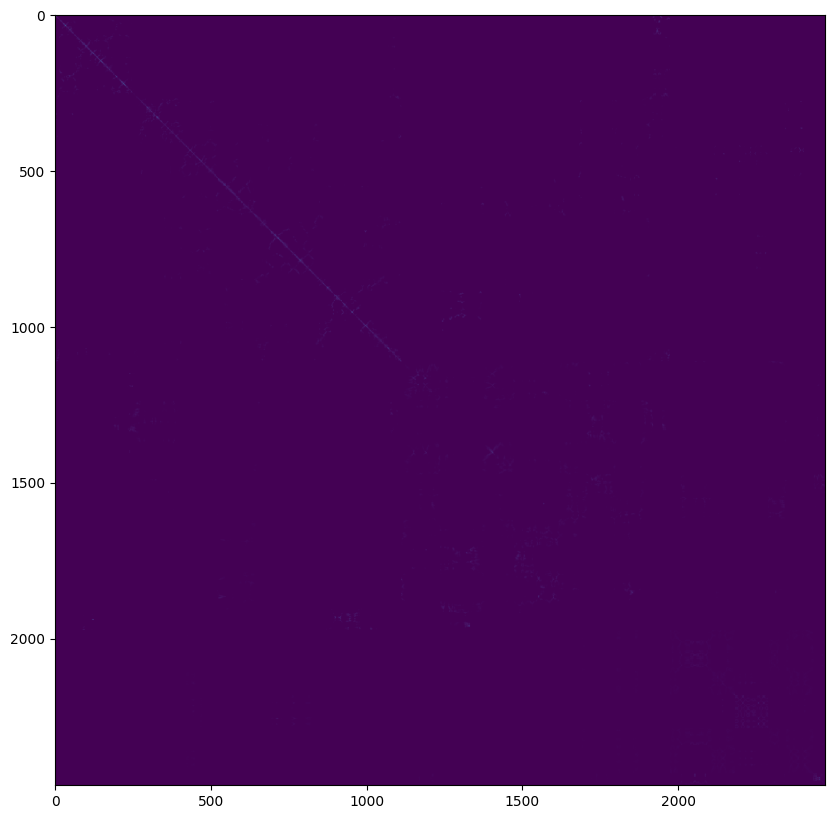

17.295660257339478
#####
47
3.11596472634741e-08
0.0010224621147358257
1.0000000000000007


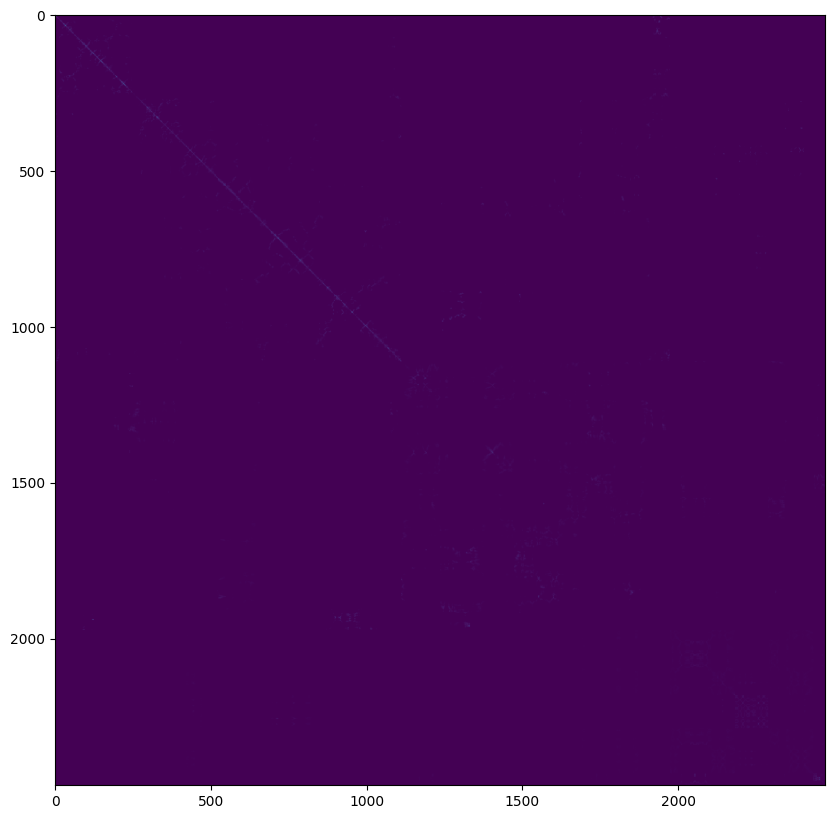

16.14574670791626
#####
48
3.1159613213076155e-08
0.0009287858170451286
0.9999999999999999


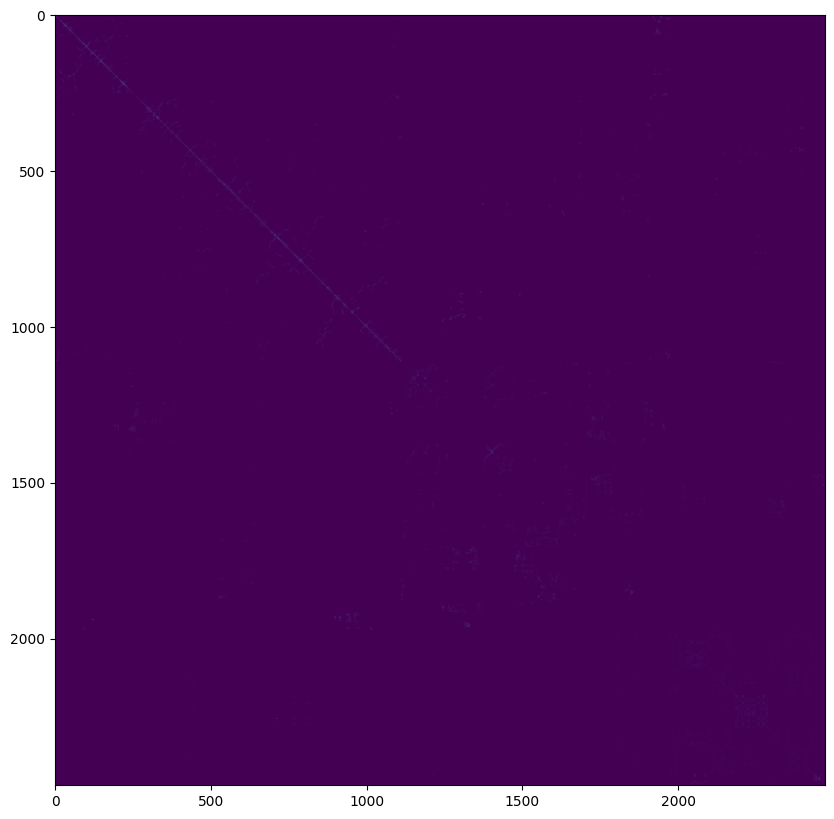

16.02948760986328
#####
49
3.115958386422493e-08
0.0008460828848210309
1.0000000000000002


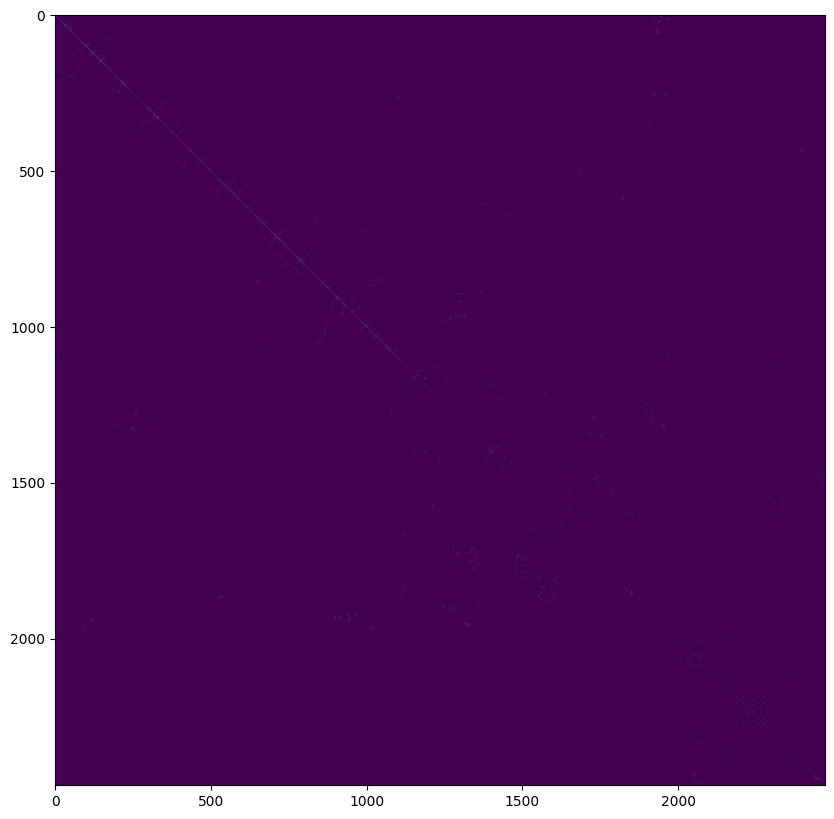

16.13385534286499


In [26]:
eta = 1
import time
alpha = 1e5
cur_mu = np.outer(mu_x, mu_y)
print(cur_mu.sum())
dif = []
costs = []
mus = []
for i in range(50):
    t = time.time()
    c = gamma(cur_mu, d_x, i_x, d_y)
    c_o = c
    c -= c.min()
    c = (c**eta) * (cur_mu**(1-eta))
    
#     plt.imshow(c)
#     plt.show()
#     print(c)
    
    
    k = 1/c.sum() *c.shape[0] * c.shape[1]
    c = c*k
    alpha1=alpha*k
    mu = ot.sinkhorn(mu_x, mu_y, c, alpha1)
    print('#####')
    print(i)
    print(k)
    print(abs(mu - cur_mu).sum())
    print(mu.sum())
    dif.append(abs(mu - cur_mu).sum())
    costs.append(cost(c_o, cur_mu))
    plt.imshow(cur_mu)
    plt.show()
#     plt.imshow(c)
    plt.show()
    cur_mu = mu
#     if dif[-1] < 1e-4:
#         cur_mu = np.random.rand(mu.shape[0], mu.shape[1])
#         cur_mu /= cur_mu.sum()
    mus.append(cur_mu)
    print(time.time() - t)

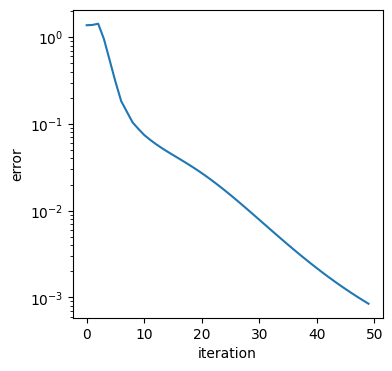

In [113]:
fig = plt.figure(figsize=(4, 4))
plt.plot(dif)
plt.yscale('log')
plt.ylabel('error')
plt.xlabel('iteration')
plt.savefig('Data/jgw/bio/1i3q/errors.svg')
plt.show()

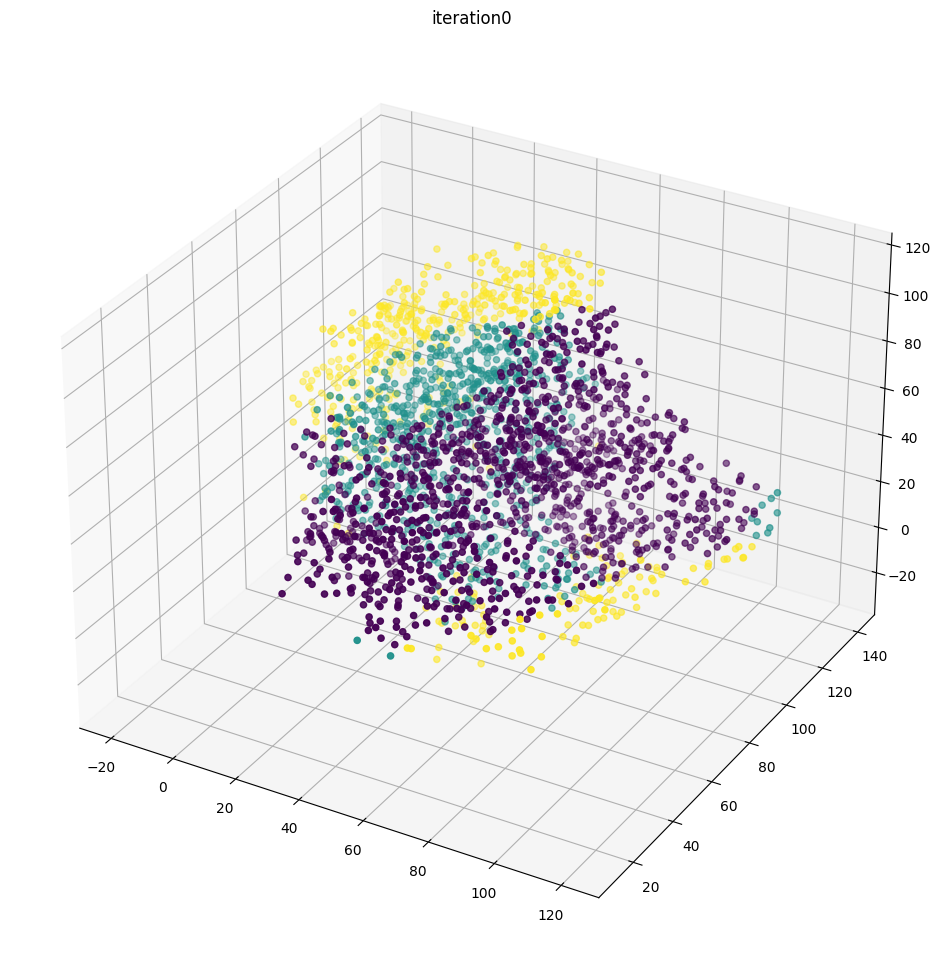

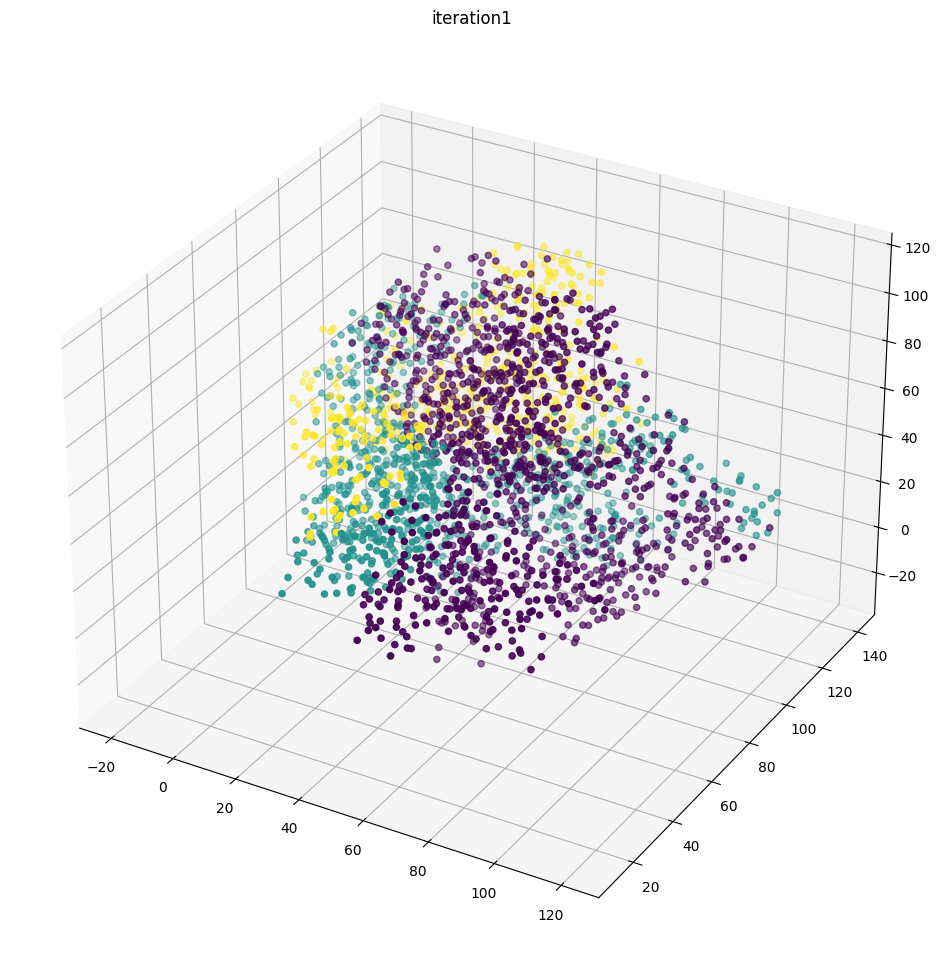

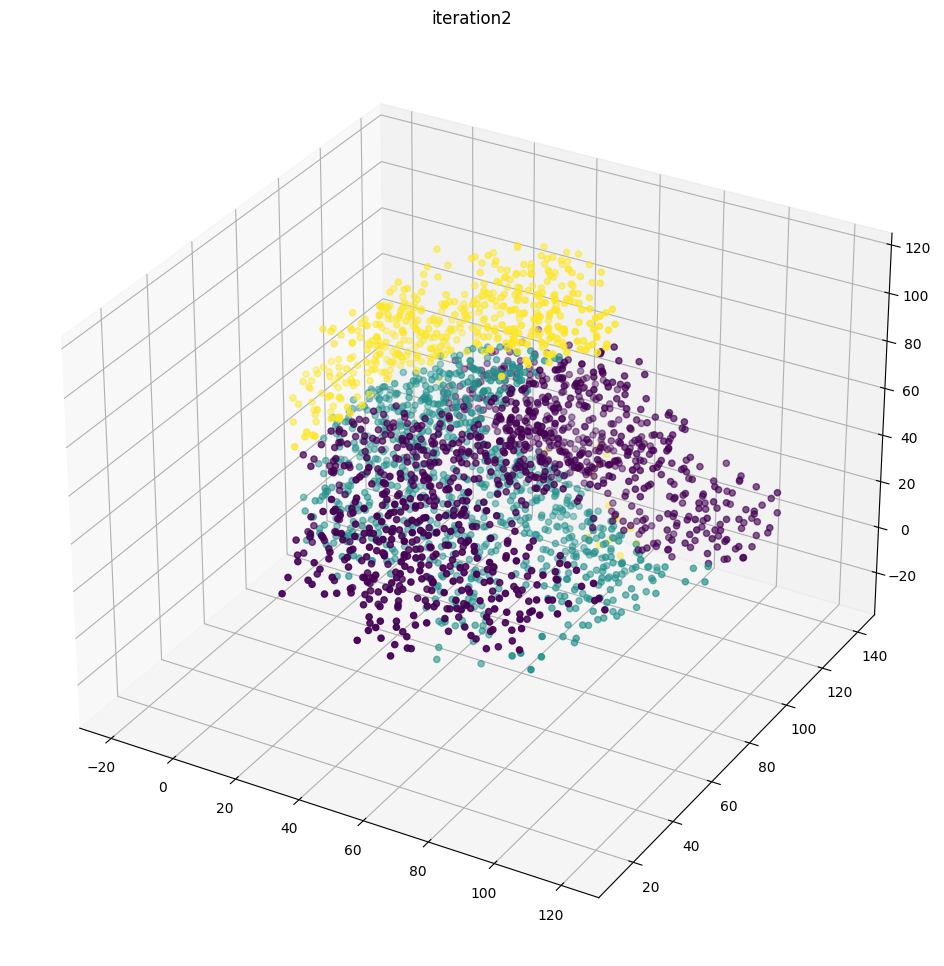

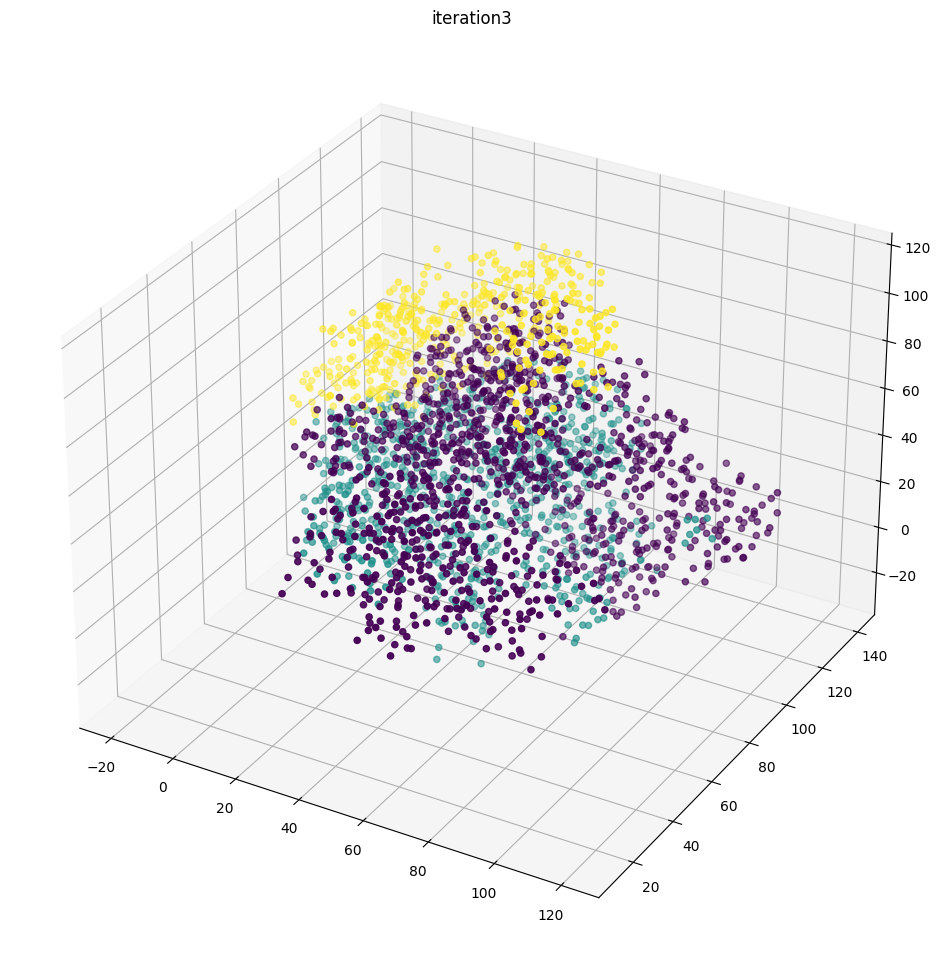

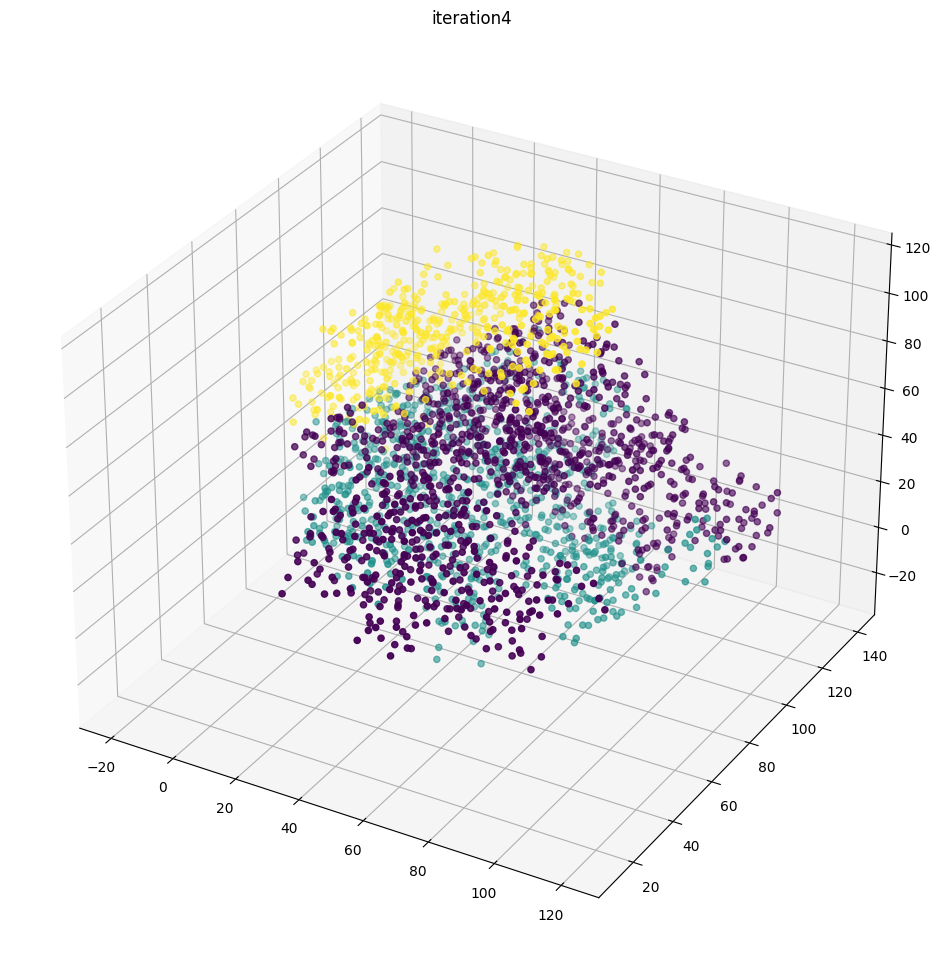

...

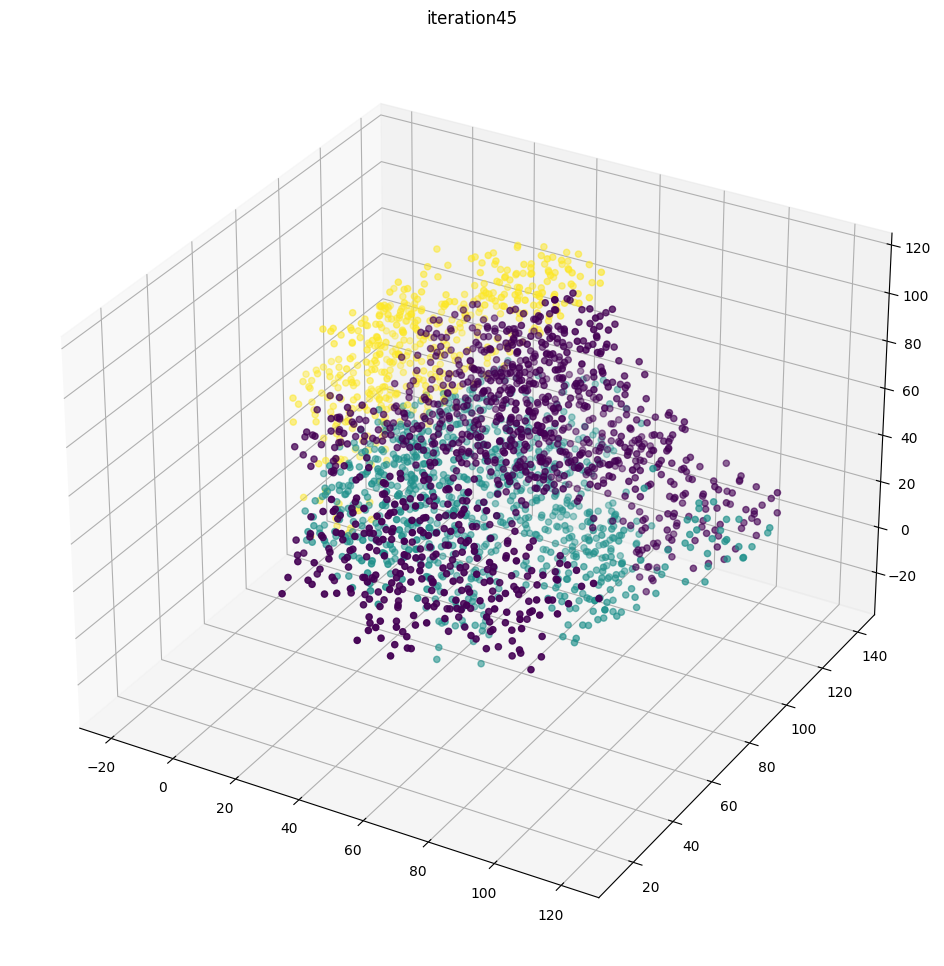

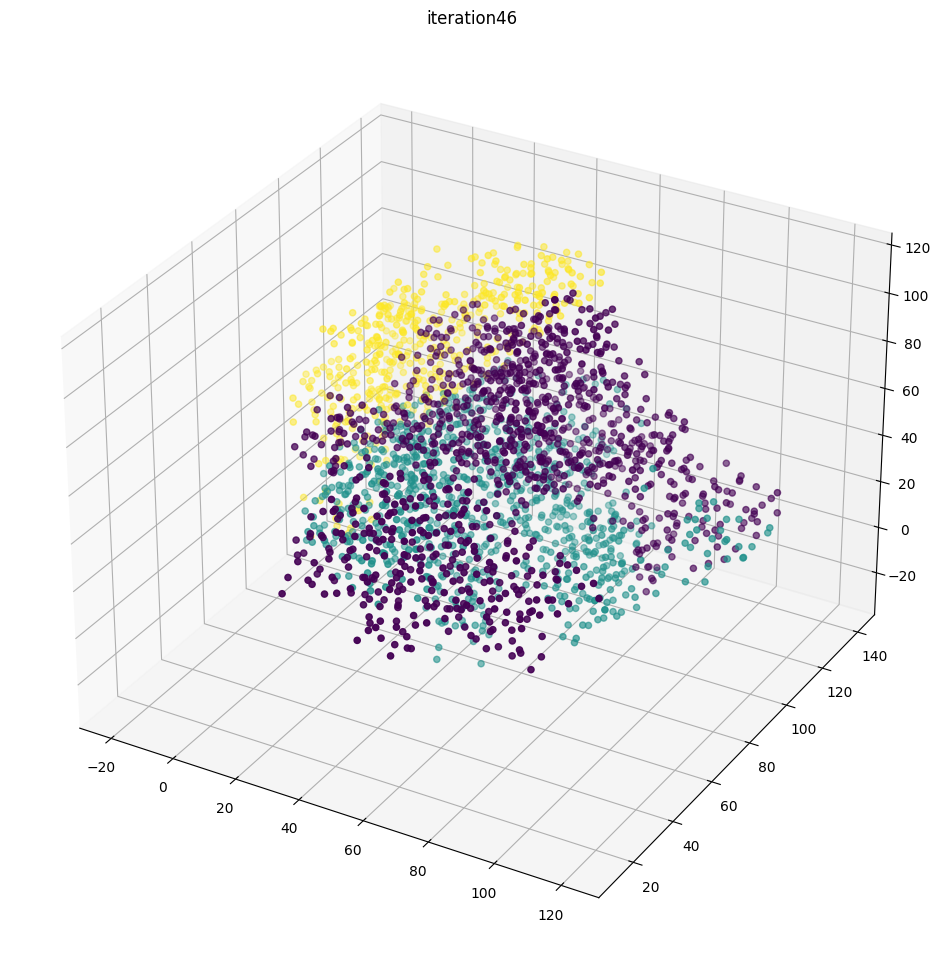

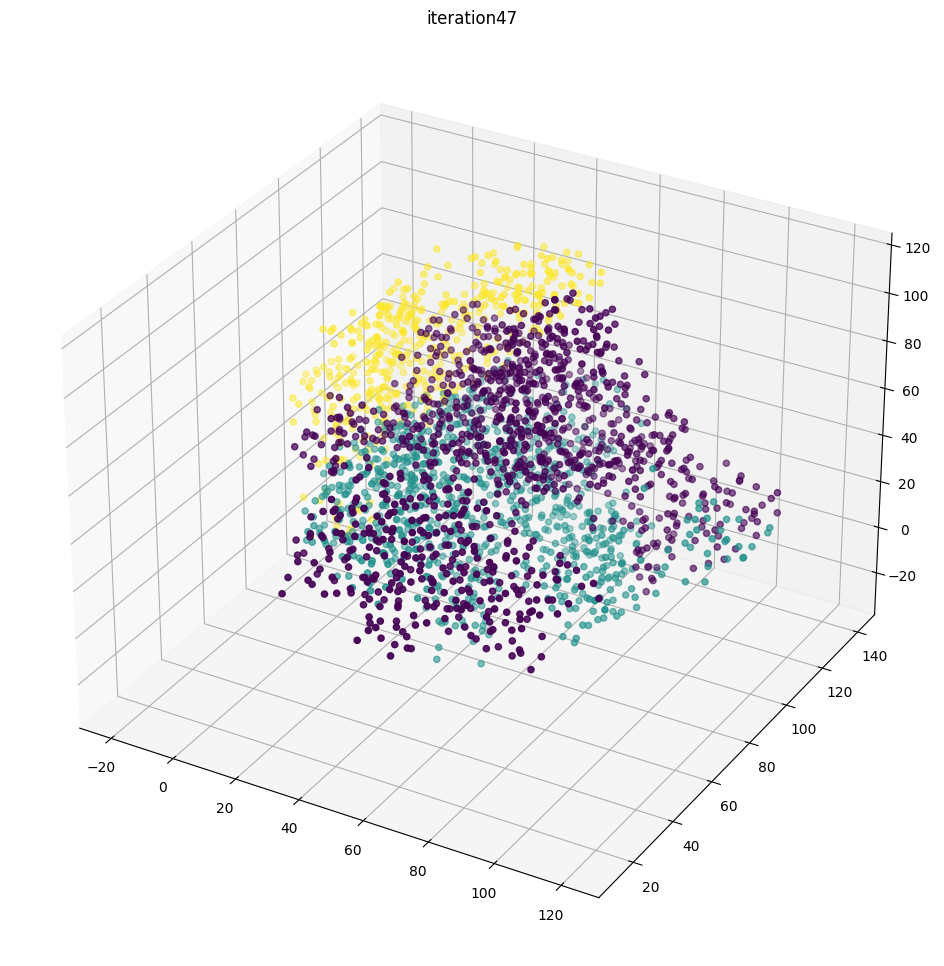

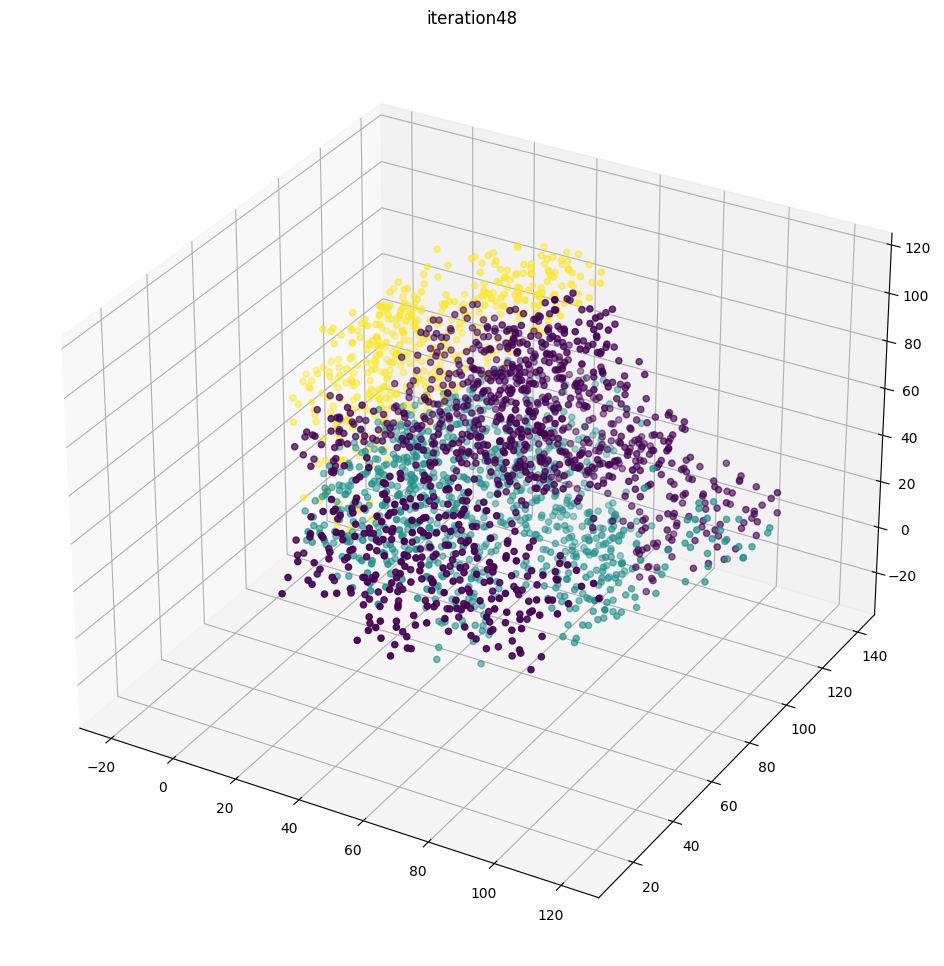

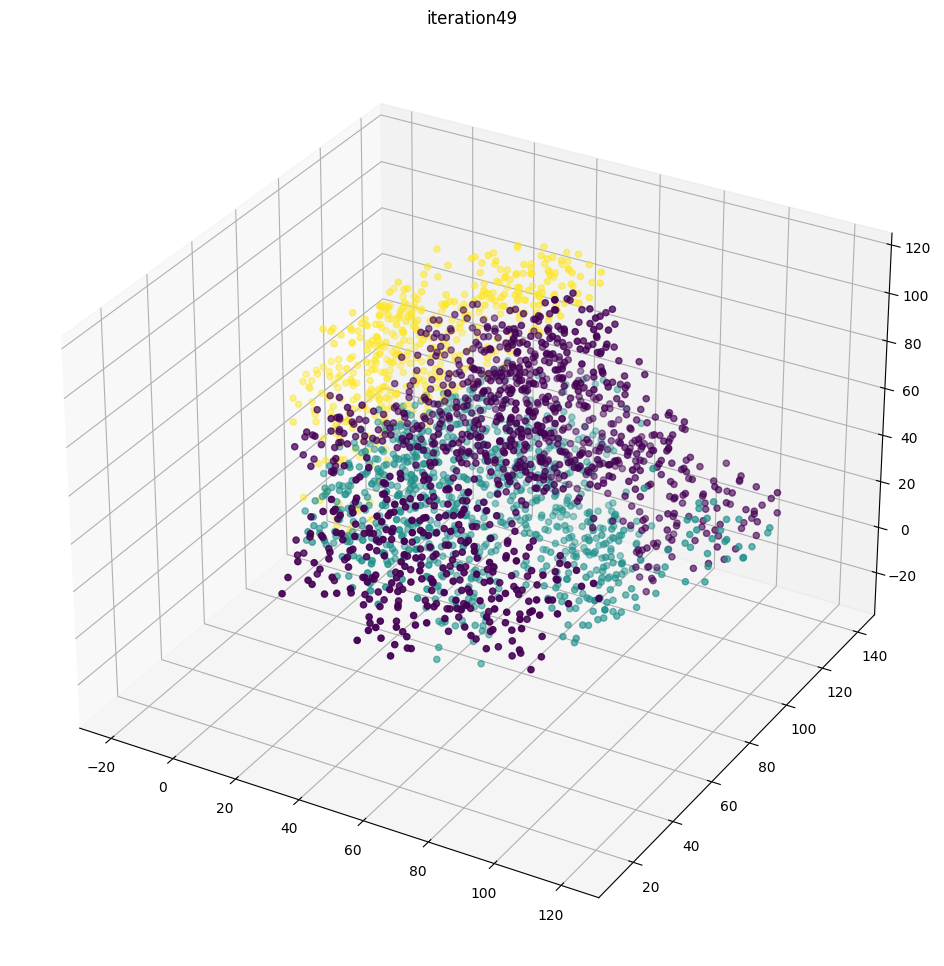

In [29]:
for k in range(len(mus)):
    mu = mus[k]
    
    thresh = 0
    labels = []
    tots = []
    for i in range(points_y.shape[0]):
        tot = [0]*len(file_path_extensions)
        for j in range(mu.shape[0]): 
            if mu[j, i] > thresh:
                tot[index[j]] += mu[j,i]
        tots.append(tot)
        labels.append(np.argmax(tot))
    tots = np.array(tots)
    
    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(points_y[:,2], points_y[:,0], points_y[:,1], c=labels)
    ax.set_title('iteration' + str(k))
#     plt.legend()
    plt.show()

In [97]:
x = []
y = []
z = []
for i in range(points_y.shape[0]):
    x.append(points_y[i, 0])
    y.append(points_y[i, 1])
    z.append(points_y[i, 2])

In [104]:
ss = 0
for k in range(len(file_path_extensions)):
    x1 = []
    y1 = []
    z1 = []
    for i in range(points_x[k].shape[0]):
        x1.append(points_x[k][i, 0])
        y1.append(points_x[k][i, 1])
        z1.append(points_x[k][i, 2])
        
    all_coup = []
    for i in range(len(x1)):
        maxi = None
        maxx = 0
        s = 0
        for j in range(len(x)):
            s += mus[-1][ss + i, j]
            if mus[-1][ss + i, j] > maxx:
    #             print(maxx, res[i,j])
    #             print(i,j)
                maxx = mus[-1][ss + i, j]
                maxi = j
    #     print('!')
        if False:
            print(i,maxi, maxx, s)
    #     if maxi/maxx >0.8:
        if maxi is not None:
    #     if i == 0 and maxi >1e-4:
            all_coup.append((i, maxi))
    
    Abar, Bbar, r = find_optimal_alignment(x, y, z, x1, y1, z1, all_coup)
    print("Abar: ", Abar)
    print("Bbar: ", Bbar)
    print("r: ", r.as_rotvec(degrees=True))
    
    alignment = {'Abar':Abar, 'Bbar':Bbar, 'r':r}
    
    generate_pdb_no_mrc(file_path_origin%(file_path_extensions[k],), 'Data/jgw/bio/1i3q/1i3q_OJGW_%s.pdb'%(file_path_extensions[k],), alignment)
    
    ss += len(x1)
    

Abar:  [77.0820785  55.18230913 58.76215086]
Bbar:  [77.68930704 54.80309583 59.15906358]
r:  [ 3.60046761  2.94898048 -2.19918231]
Data/jgw/bio/1i3q/1i3q_A.pdb
Abar:  [91.26798762 18.46788579 42.95443936]
Bbar:  [91.37902831 21.53243086 43.31305308]
r:  [135.16503612  24.22442108 -78.81695161]
Data/jgw/bio/1i3q/1i3q_B.pdb
Abar:  [107.71528512  65.46233445  10.21388119]
Bbar:  [104.54445995  59.85590736  12.24213008]
r:  [8.93358015 0.27187992 0.78555395]
Data/jgw/bio/1i3q/1i3q_CHJKL.pdb


C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6409.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 6412.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 6413.
  warnings.warn(


In [106]:
print(points_y.shape)
print(points_x[0].shape)
print(points_x[1].shape)
print(points_x[2].shape)

(2471, 3)
(1111, 3)
(862, 3)
(498, 3)


In [31]:
a = [1/points_x[0].shape[0]] * points_x[0].shape[0]
b = [1/points_y.shape[0]] * points_y.shape[0]
n = points_x[0].shape[0]
dx = np.zeros((n, n))
for i in range(n):
    for j in range(n):
        dx[i][j] = np.linalg.norm(points_x[0][i] - points_x[0][j])

n = points_y.shape[0]
dy = np.zeros((n, n))
for i in range(n):
    for j in range(n):
        dy[i][j] = np.linalg.norm(points_y[i] - points_y[j])

a = torch.from_numpy(np.array(a))
b = torch.from_numpy(np.array(b))
dx = torch.from_numpy(np.array(dx))
dy = torch.from_numpy(np.array(dy))

In [32]:
eps=400
rho=10000
rho2=10000
nits_plan=100
tol_plan=1e-10
nits_sinkhorn=100
tol_sinkhorn=1e-10

In [34]:
t = time.time()
pi, gamma = log_ugw_sinkhorn(a, dx, b, dy, eps=eps, rho=rho, rho2=rho2, two_outputs=True)
print(time.time() - t)

232.62073636054993


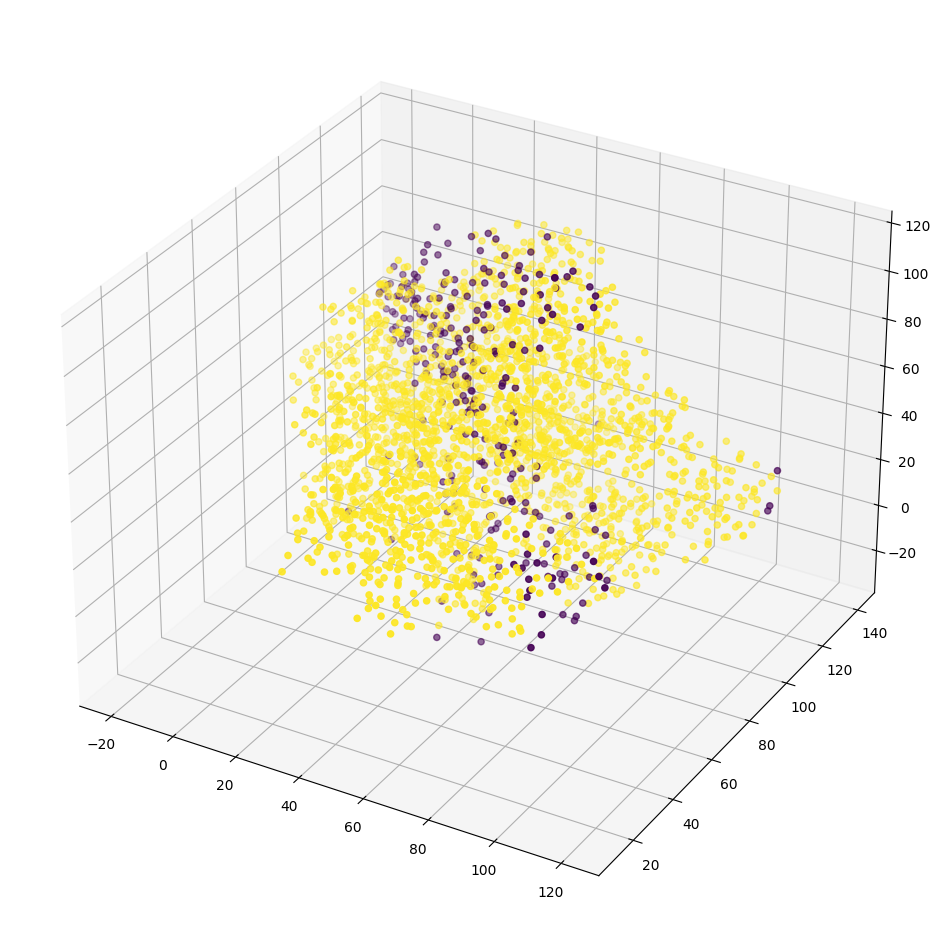

In [44]:
thresh = 0
labels = []
tots = []
# for i in range(points_y.shape[0]):
#     tot = [0]*len(file_path_extensions)
#     for j in range(mu.shape[0]): 
#         if mu[j, i] > thresh:
#             tot[index[j]] += mu[j,i]
#     tots.append(tot)
#     labels.append(np.argmax(tot))
# tots = np.array(tots)
labels = [1] * points_y.shape[0]
for i in range(points_x[0].shape[0]):
    maxx = 0
    maxi = None
    for j in range(points_y.shape[0]):
        if pi[i, j] > maxx:
#             print(maxx, pi[i,j], j)
            maxx = pi[i,j]
            maxi = j
#     print(i, maxi)
    labels[maxi] = 0

fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(projection='3d')
ax.scatter(points_y[:,2], points_y[:,0], points_y[:,1], c=labels)
# ax.set_title('iteration' + str(k))
#     plt.legend()
plt.show()

In [47]:
n_points = 500
n_comb = 2

In [46]:
x = []
y = []
z = []
for i in range(points_y.shape[0]):
    x.append(points_y[i, 0])
    y.append(points_y[i, 1])
    z.append(points_y[i, 2])

0
torch.Size([2471])
torch.Size([1111])
torch.Size([2471, 2471])
torch.Size([1111, 1111])


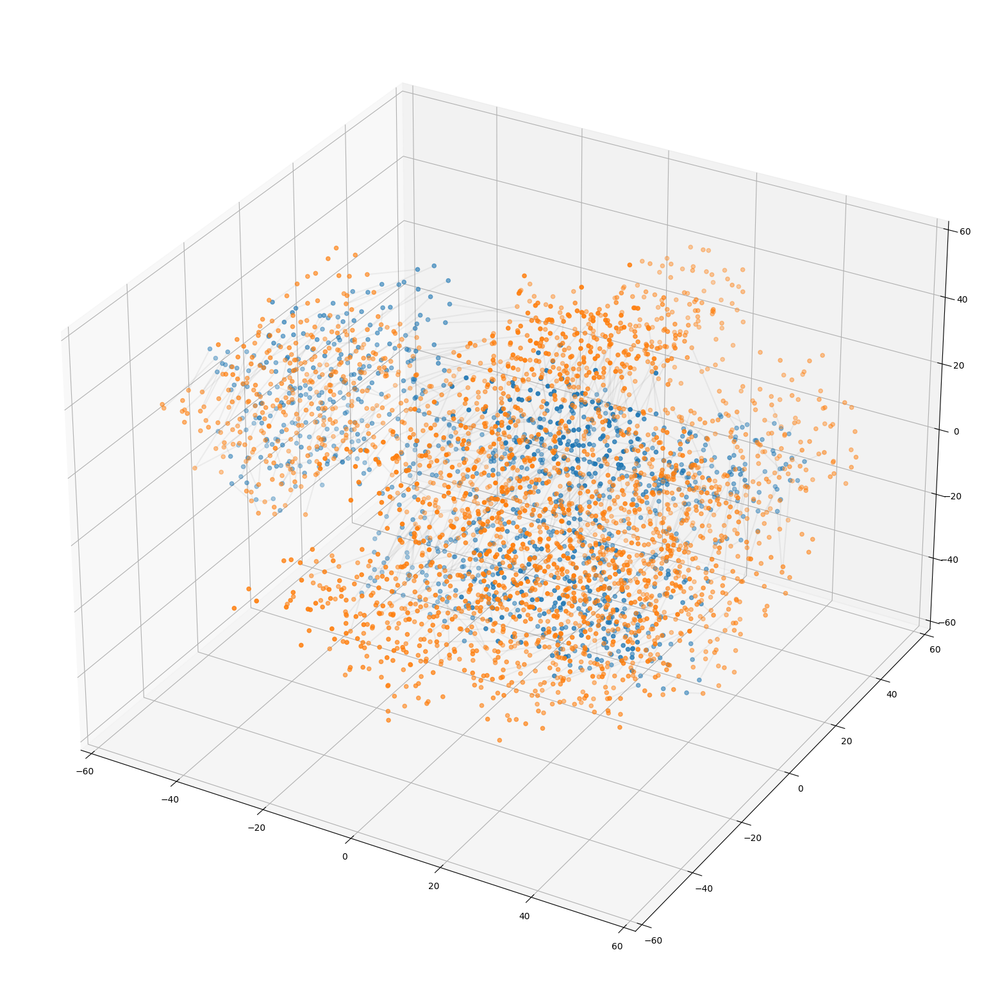

1
torch.Size([2471])
torch.Size([1111])
torch.Size([2471, 2471])
torch.Size([1111, 1111])


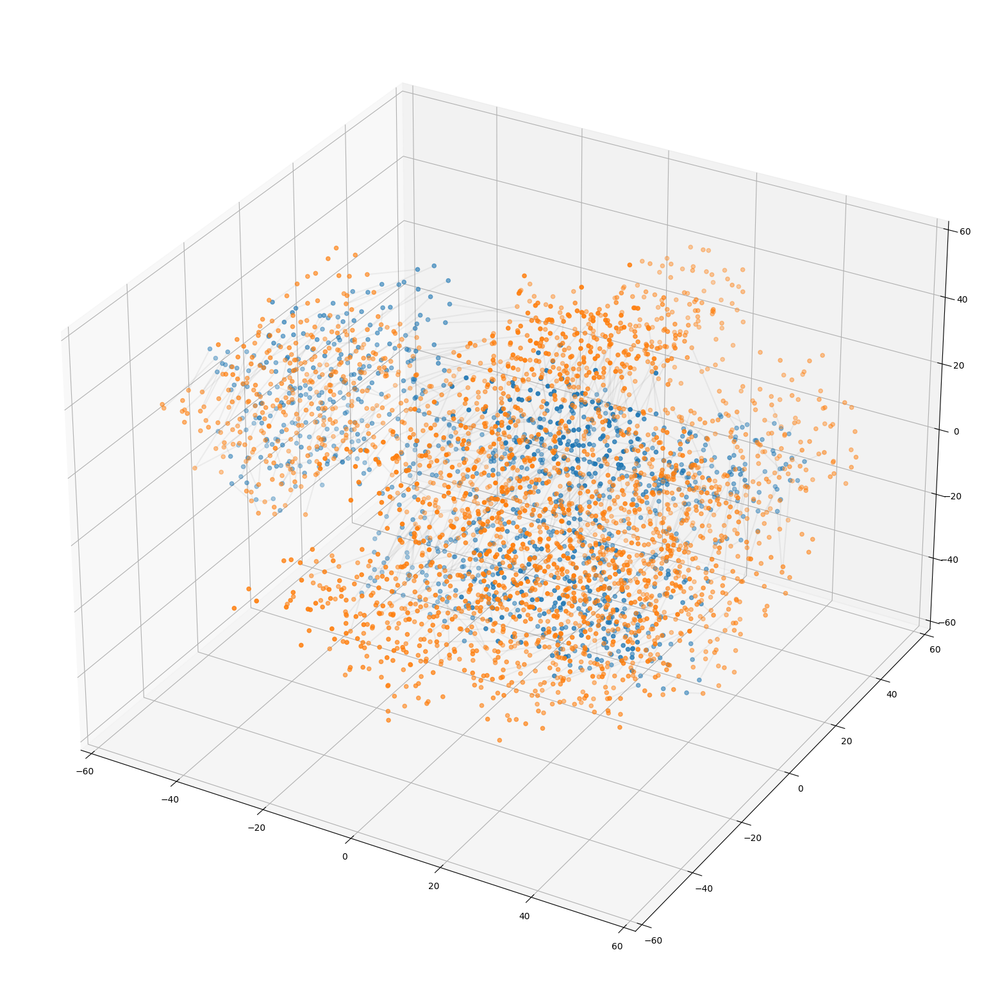

2571.6281321048737


In [65]:
t = time.time()
a1 = align_substruct(x, y, z, [(points_x[0], 0.1, 'Data/jgw/bio/1i3q/1i3q_A.pdb')], num=n_comb, num_points=n_points)
print(time.time() - t)

0
torch.Size([2471])
torch.Size([862])
torch.Size([2471, 2471])
torch.Size([862, 862])


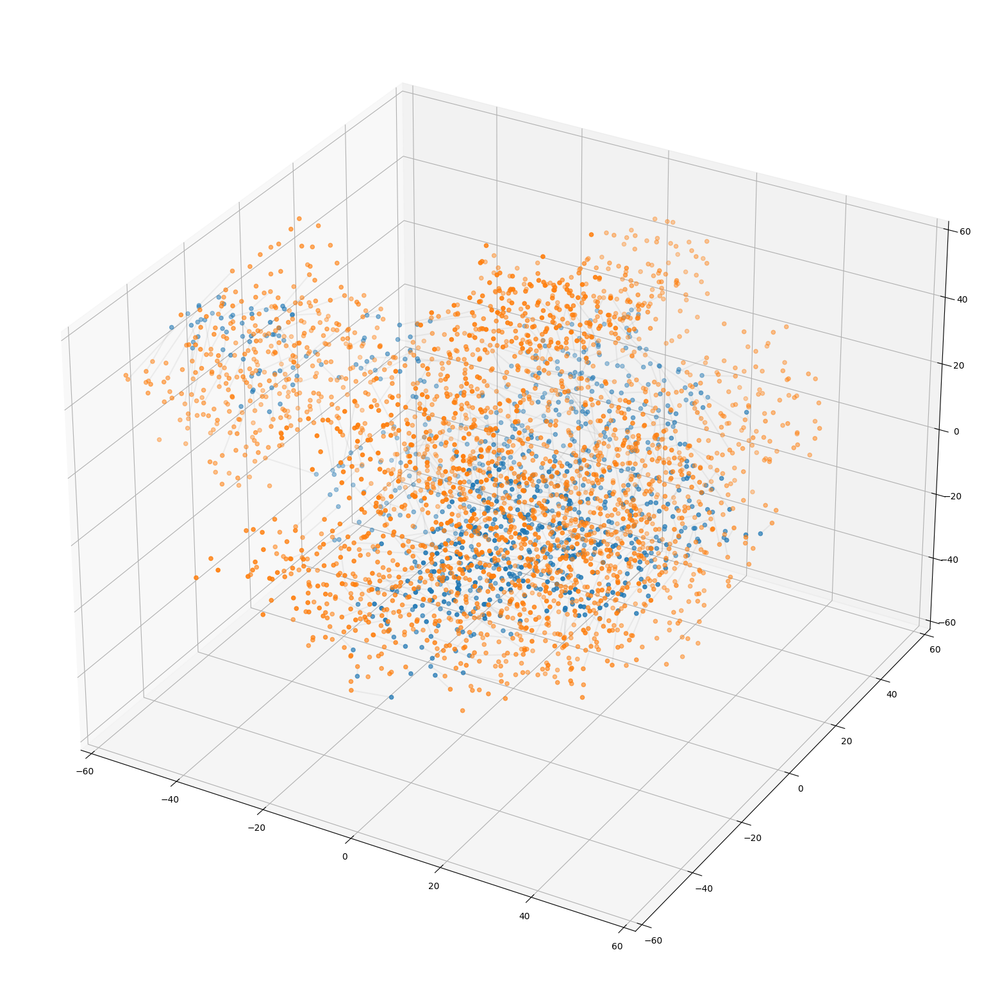

1
torch.Size([2471])
torch.Size([862])
torch.Size([2471, 2471])
torch.Size([862, 862])


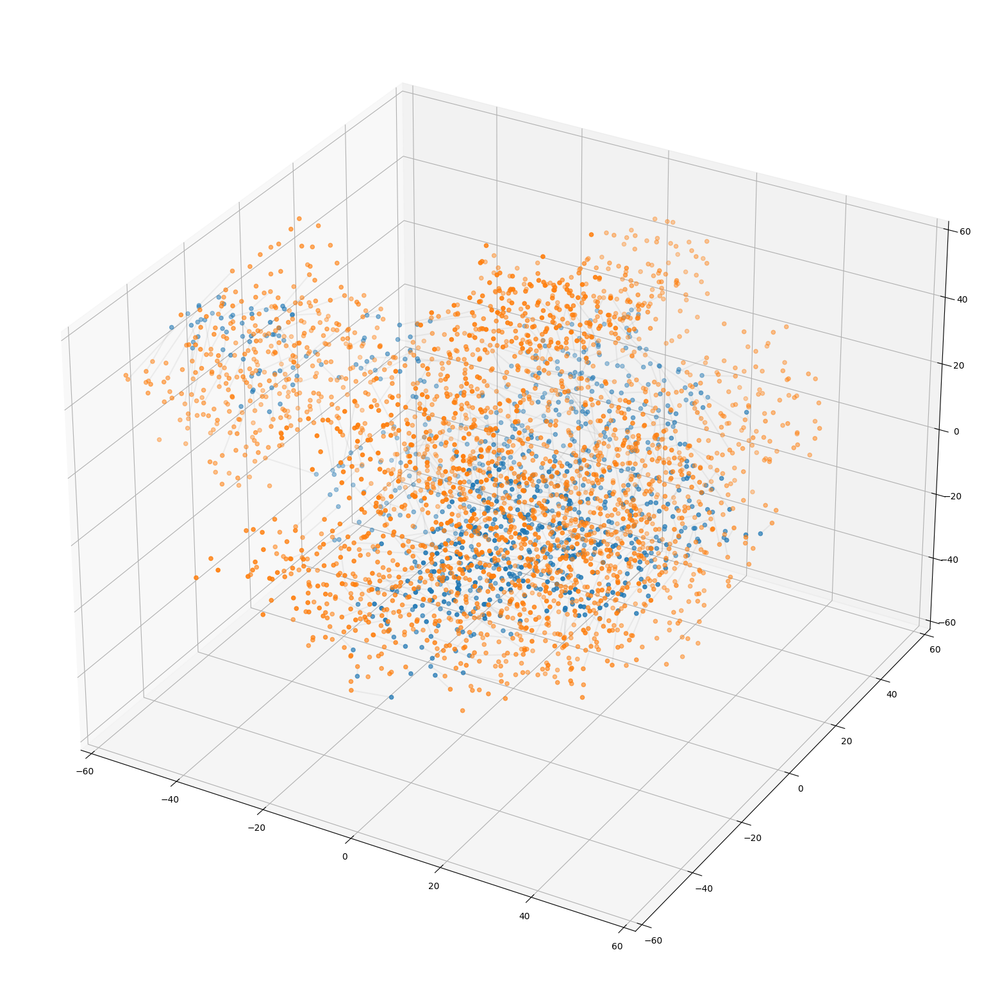

1868.558035850525


In [66]:
t = time.time()
a2 = align_substruct(x, y, z, [(points_x[1], 0.1, 'Data/jgw/bio/1i3q/1i3q_B.pdb')], num=n_comb, num_points=n_points)
print(time.time() - t)

0
torch.Size([2471])
torch.Size([498])
torch.Size([2471, 2471])
torch.Size([498, 498])


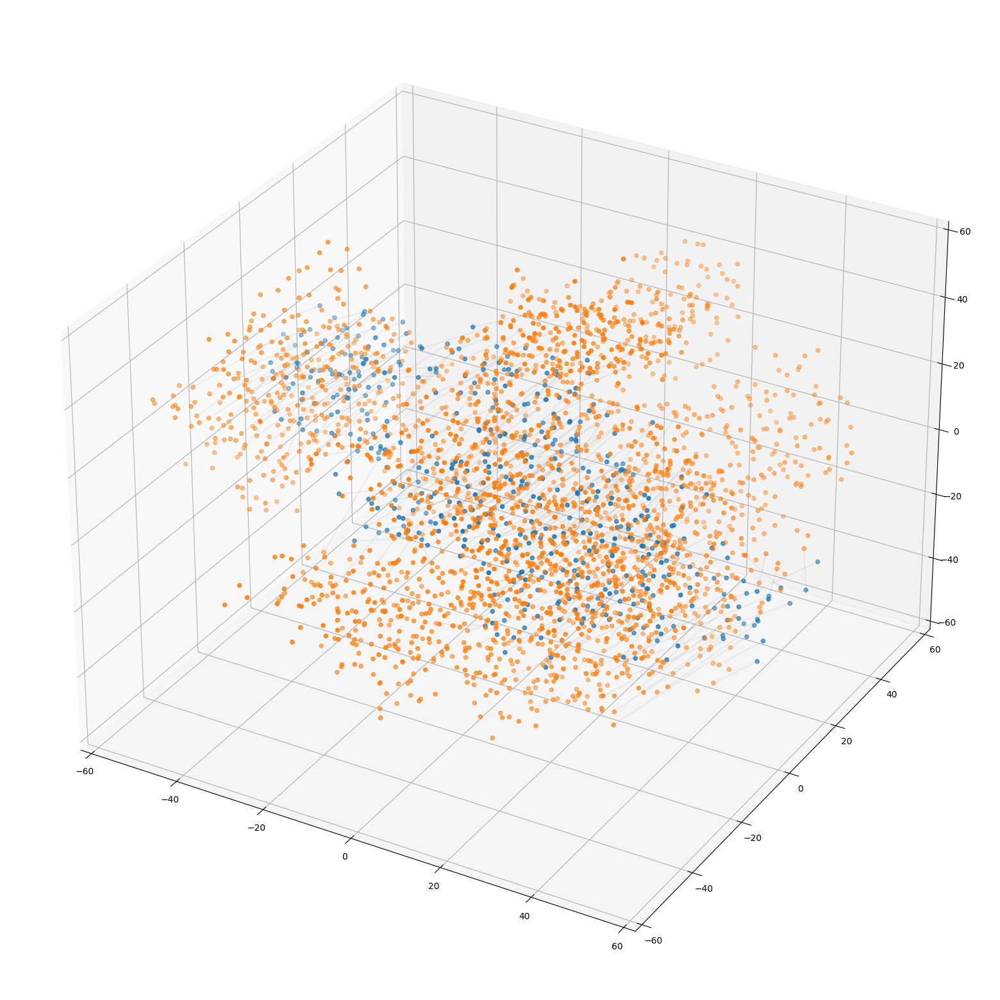

1
torch.Size([2471])
torch.Size([498])
torch.Size([2471, 2471])
torch.Size([498, 498])


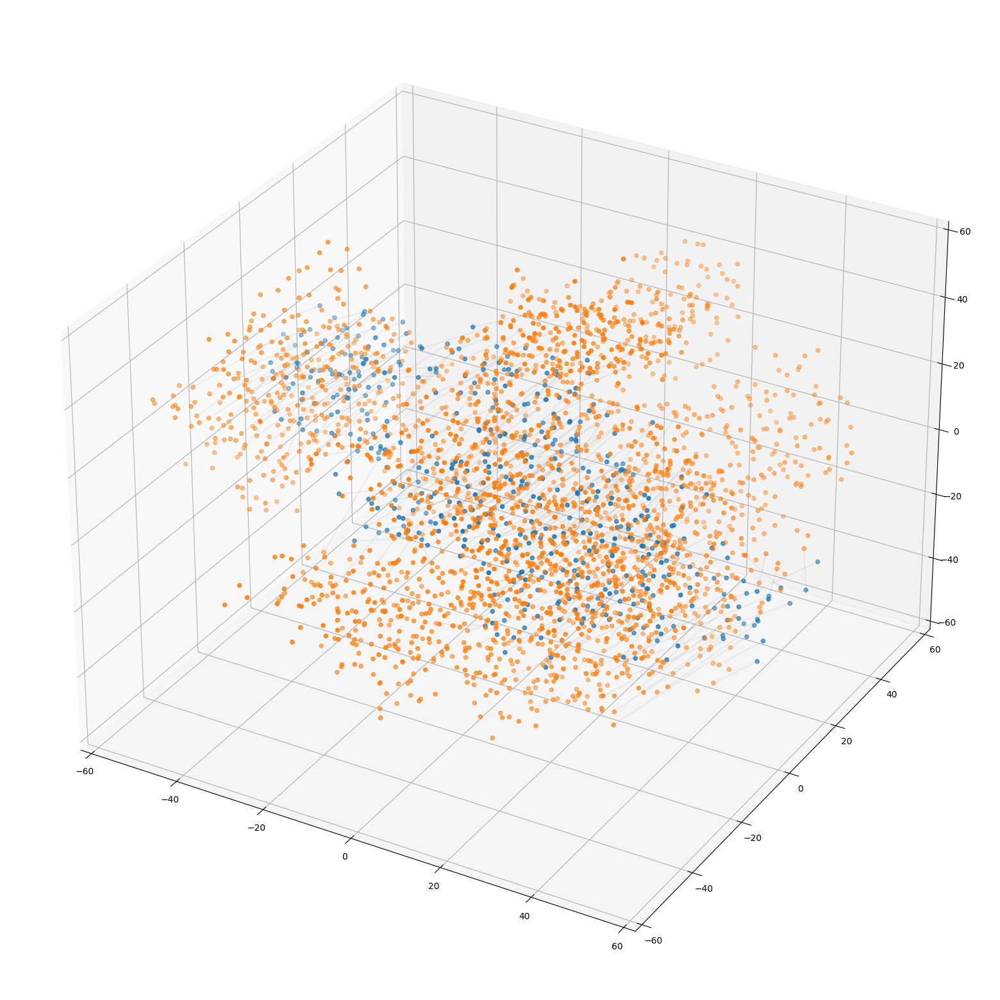

1239.602248430252


In [67]:
t = time.time()
a3 = align_substruct(x, y, z, [(points_x[2], 0.1, 'Data/jgw/bio/1i3q/1i3q_CHJKL.pdb')], num=n_comb, num_points=n_points)
print(time.time() - t)

In [68]:
alignments = choose_alignments(x, y, z, [a1, a2, a3], verbose=False)

In [86]:
for i in range(len(alignments)):
    generate_pdb_no_mrc(alignments[i]['struct'][2], 'Data/jgw/bio/1i3q/1i3q_O_%s.pdb'%(file_path_extensions[i],), alignments[i])
#     print("Abar: ", alignment['Abar'])
#     print("Bbar: ", alignment['Bbar'])
#     print("r: ", alignment['r'].as_rotvec(degrees=True))

Data/jgw/bio/1i3q/1i3q_A.pdb
Data/jgw/bio/1i3q/1i3q_B.pdb
Data/jgw/bio/1i3q/1i3q_CHJKL.pdb


C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6409.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 6412.
  warnings.warn(
C:\Users\artaj\AppData\Local\Programs\Python\Python310\lib\site-packages\Bio\PDB\StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 6413.
  warnings.warn(


In [108]:
for i in range(len(alignments)):
    print("Abar: ", alignments[i]['Abar'])
    print("Bbar: ", alignments[i]['Bbar'])
    print("r: ", alignments[i]['r'].as_rotvec(degrees=True))

Abar:  [82.56103907 44.37848435 43.69003087]
Bbar:  [77.68930704 54.80309583 59.15906358]
r:  [-14.008215    12.26270332 -24.18034282]
Abar:  [90.53725469 45.01935346 37.47196276]
Bbar:  [91.37902831 21.53243086 43.31305308]
r:  [51.44219431  5.83413111 24.40321794]
Abar:  [80.59644685 50.4949318  37.61860104]
Bbar:  [104.54445995  59.85590736  12.24213008]
r:  [  77.21657581 -115.23484766  -83.50816264]
